# Emotion Sentiment Analaysis

In [1]:
import os
os.environ["TOKENIZERS_PARALLELISM"] = "false"

In [2]:
!pip install numpy
!pip install pandas
!pip install matplotlib
!pip3 install torch torchvision
!pip install 'transformers[torch]'
!pip install tensorflow
!pip install prettytable
!pip install seaborn
!pip install ipywidgets
!pip install scipy
!pip install statsmodels
!pip install scikit-learn
!pip install adjustText

In [3]:
import numpy as np
from numpy import mean, std
import pandas as pd
import matplotlib.pyplot as plt
from prettytable import PrettyTable
import ast
import seaborn as sns
import ipywidgets as widgets
import itertools
from scipy.stats import f_oneway, ttest_ind
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import matplotlib.pyplot as plt
import matplotlib.backends.backend_pdf
from sklearn.cluster import KMeans
from adjustText import adjust_text
import random

## Sentiment Analysis

If you don't want to run the model again, you can import the results from the CSV's skip to the next section.

In [4]:
#Import CSV's

adhd_data = pd.read_csv('datasets/adhd_2018_features_tfidf_256.csv')
anxiety_data = pd.read_csv('datasets/anxiety_2018_features_tfidf_256.csv')
autism_data = pd.read_csv('datasets/autism_2018_features_tfidf_256.csv')
bpd_data = pd.read_csv('datasets/bpd_2018_features_tfidf_256.csv')
depression_data = pd.read_csv('datasets/depression_2018_features_tfidf_256.csv')
ed_data = pd.read_csv('datasets/EDAnonymous_2019_features_tfidf_256.csv')
healthanxiety_data = pd.read_csv('datasets/healthanxiety_2018_features_tfidf_256.csv')
ptsd_data = pd.read_csv('datasets/ptsd_2018_features_tfidf_256.csv')
schizophrenia_data = pd.read_csv('datasets/schizophrenia_2018_features_tfidf_256.csv')
socialanxiety_data = pd.read_csv('datasets/socialanxiety_2018_features_tfidf_256.csv')

In [5]:
#Take the first 1100 sets of data:

adhd_reduced = adhd_data.head(1100)
autism_reduced = autism_data.head(1100)
anxiety_reduced = anxiety_data.head(1100)
bpd_reduced = bpd_data.head(1100)
depression_reduced = depression_data.head(1100)
ed_reduced = ed_data.head(1100)
healthanxiety_reduced = healthanxiety_data.head(1100)
ptsd_reduced = ptsd_data.head(1100)
schizoprenia_reduced = schizophrenia_data.head(1100)
socialanxiety_reduced = socialanxiety_data.head(1100)

In [6]:
## Model test:

from transformers import pipeline
classifier = pipeline(task="text-classification", model="SamLowe/roberta-base-go_emotions", top_k=None)

In [7]:
#Reducing to 2 cols - Index + Text:

new_adhd = pd.DataFrame(adhd_reduced.iloc[:, 3])
new_autism = pd.DataFrame(autism_reduced.iloc[:, 3])
new_anxiety = pd.DataFrame(anxiety_reduced.iloc[:, 3])
new_bpd = pd.DataFrame(bpd_reduced.iloc[:, 3])
new_ed = pd.DataFrame(ed_reduced.iloc[:, 3])
new_depression = pd.DataFrame(depression_reduced.iloc[:, 3])
new_healthanxiety = pd.DataFrame(healthanxiety_reduced.iloc[:, 3])
new_ptsd = pd.DataFrame(ptsd_reduced.iloc[:, 3])
new_schizophrenia = pd.DataFrame(schizoprenia_reduced.iloc[:, 3])
new_socialanxiety = pd.DataFrame(socialanxiety_reduced.iloc[:, 3])

# Create a dictionary of dataframes

dfs = {
    'new_adhd': new_adhd,
    'new_anxiety': new_anxiety,
    'new_autism': new_autism,
    'new_bpd': new_bpd,
    'new_depression': new_depression,
    'new_ed': new_ed,
    'new_healthanxiety': new_healthanxiety,
    'new_ptsd': new_ptsd,
    'new_schizophrenia': new_schizophrenia,
    'new_socialanxiety': new_socialanxiety
}

In [8]:
#Function Test - Clasiffier:

def classify_text(text):
    try:
        # Expected case
        result = classifier(text)
    except Exception as e:
        # Non-Expected case here should continue tho
        result = str(e)
    return result

In [9]:
# apply for all datasets
for name, df in dfs.items():
    df['Classification Results'] = df.iloc[:, 0].apply(classify_text)

Token indices sequence length is longer than the specified maximum sequence length for this model (1073 > 512). Running this sequence through the model will result in indexing errors


In [10]:
# Export and save csv and save it to sentiment_analysis folder and name it as the dataset name (new_adhd.csv and so on)
for name, df in dfs.items():
    disease_name = name.split('_')[1]
    df.to_csv(f'sentiment_analysis/csvs/{disease_name}_sentiment_analysis.csv', index=False)

## Global Variables

In [11]:
new_adhd = pd.read_csv('sentiment_analysis/csvs/adhd_sentiment_analysis.csv')
new_autism = pd.read_csv('sentiment_analysis/csvs/autism_sentiment_analysis.csv')
new_anxiety = pd.read_csv('sentiment_analysis/csvs/anxiety_sentiment_analysis.csv')
new_bpd = pd.read_csv('sentiment_analysis/csvs/bpd_sentiment_analysis.csv')
new_ed = pd.read_csv('sentiment_analysis/csvs/ed_sentiment_analysis.csv')
new_depression = pd.read_csv('sentiment_analysis/csvs/depression_sentiment_analysis.csv')
new_healthanxiety = pd.read_csv('sentiment_analysis/csvs/health_sentiment_analysis.csv')
new_ptsd = pd.read_csv('sentiment_analysis/csvs/ptsd_sentiment_analysis.csv')
new_schizophrenia = pd.read_csv('sentiment_analysis/csvs/schizo_sentiment_analysis.csv')
new_socialanxiety = pd.read_csv('sentiment_analysis/csvs/social_sentiment_analysis.csv')

dfs = {
    'new_adhd': new_adhd,
    'new_anxiety': new_anxiety,
    'new_autism': new_autism,
    'new_bpd': new_bpd,
    'new_depression': new_depression,
    'new_ed': new_ed,
    'new_healthanxiety': new_healthanxiety,
    'new_ptsd': new_ptsd,
    'new_schizophrenia': new_schizophrenia,
    'new_socialanxiety': new_socialanxiety
}

In [12]:
def extract_scores(row):
        if isinstance(row, str):
            row = ast.literal_eval(row)
        row = row[0] if isinstance(row, list) and len(row) > 0 else []
        return {d['label']: d['score'] for d in row}

sentiment_dfs = {}
for name, df in dfs.items():
    sentiment_df = df[df['Classification Results'].str.contains("tensor|index") == False]
    sentiment_df['Classification Results'] = sentiment_df['Classification Results'].apply(extract_scores)
    sentiment_df = sentiment_df['Classification Results'].apply(pd.Series)
    new_name = name.replace("new_", "") + "_sentiment"
    sentiment_dfs[new_name] = sentiment_df

/var/folders/x8/xwj70dqx06g0h1lmwkt6c_km0000gp/T/ipykernel_88168/3865973009.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sentiment_df['Classification Results'] = sentiment_df['Classification Results'].apply(extract_scores)
/var/folders/x8/xwj70dqx06g0h1lmwkt6c_km0000gp/T/ipykernel_88168/3865973009.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sentiment_df['Classification Results'] = sentiment_df['Classification Results'].apply(extract_scores)
/var/folders/x8/xwj70dqx06g0h1lmwkt6c_km0000gp/T/i

In [13]:
emotions = [
    "admiration",
    "amusement",
    "approval",
    "caring",
    "desire",
    "excitement",
    "gratitude",
    "joy",
    "love",
    "optimism",
    "pride",
    "relief",
    "anger",
    "annoyance",
    "disappointment",
    "disapproval",
    "disgust",
    "embarrassment",
    "fear",
    "grief",
    "nervousness",
    "remorse",
    "sadness",
    "confusion",
    "curiosity",
    "realization",
    "surprise",
    "neutral"
]

diseases = list(sentiment_dfs.keys())

## Descriptive Statistics

In [14]:
def descriptive_stats(df):
    desc_stats = df.describe()
    pretty_table = PrettyTable()
    pretty_table.field_names = ["Statistic"] + list(desc_stats.columns)

    for index, row in desc_stats.iterrows():
        pretty_table.add_row([index] + list(row))

    print(pretty_table)

In [15]:
for name, df in sentiment_dfs.items():
    print(name + "\n")
    descriptive_stats(df)
    print('\n')

adhd_sentiment

+-----------+-----------------------+------------------------+-----------------------+-----------------------+-----------------------+------------------------+-----------------------+-----------------------+----------------------+-----------------------+------------------------+-----------------------+------------------------+------------------------+-----------------------+------------------------+-----------------------+-----------------------+------------------------+----------------------+-----------------------+-----------------------+------------------------+-----------------------+-----------------------+-----------------------+-----------------------+------------------------+
| Statistic |        sadness        |      nervousness       |     disappointment    |          joy          |       confusion       |       curiosity        |        neutral        |      realization      |       approval       |         caring        |         relief         |       annoy

## Data Visualization

### Bar Chart

In [16]:
def bar_chart(df, name):
    # Calculate the mean for each sentiment
    mean_sentiments = df.mean()

    # Create a bar plot
    plt.figure(figsize=(10, 6))
    bars = mean_sentiments.plot(kind='bar')
    disease_name = name.split("_")[0]
    plt.title(f'Average Sentiment Scores of {disease_name}')
    plt.ylabel('Score')
    plt.xlabel('Sentiment')

    # Add the values on top of each bar
    for bar in bars.patches:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, round(yval, 2), ha='center', va='bottom')
    new_name = name + "_bar_chart"
    plt.savefig(f'sentiment_analysis/bar_charts/{new_name}.png')
    plt.show()
    plt.close()


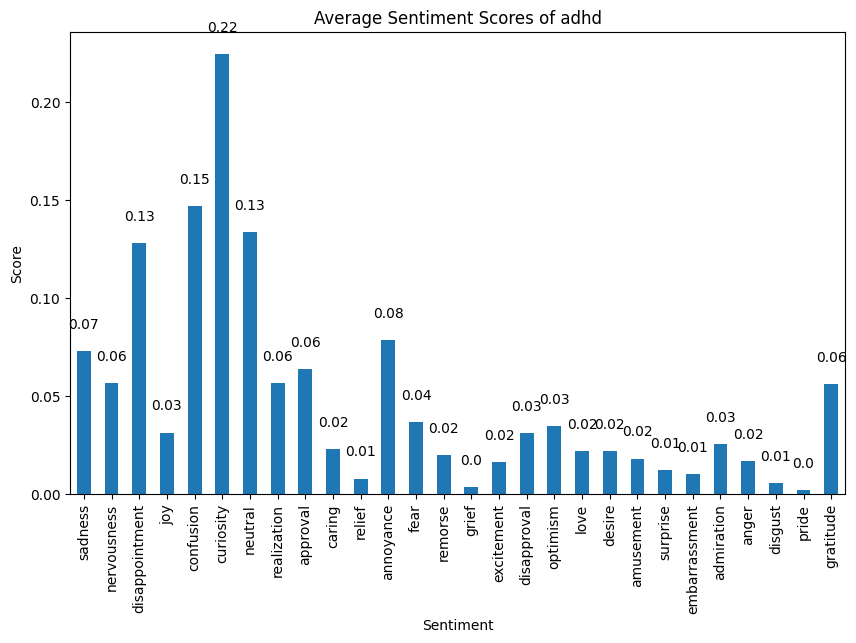

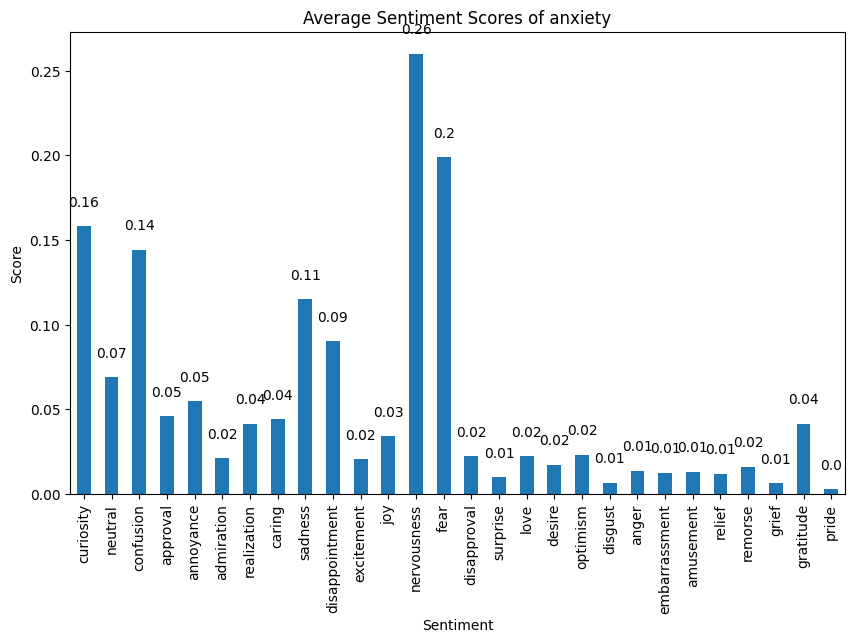

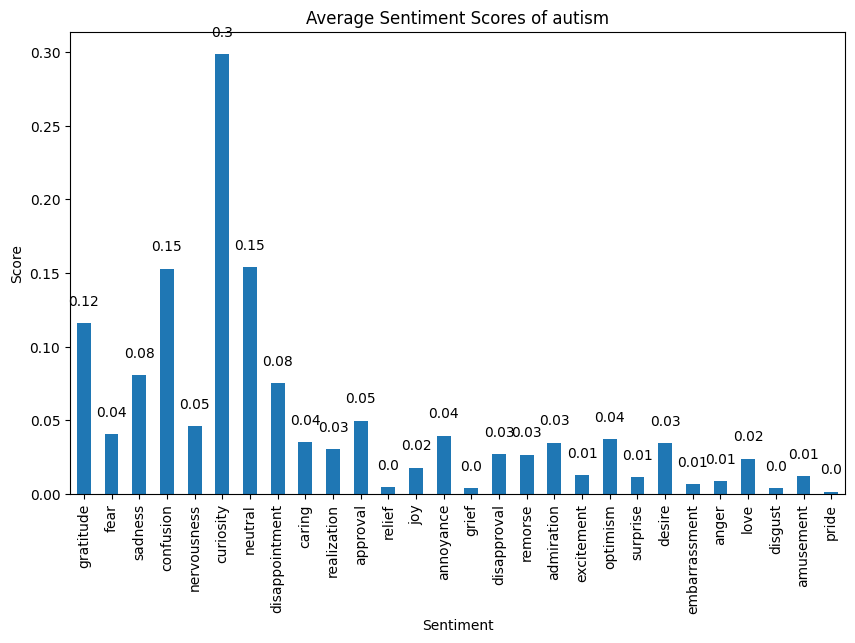

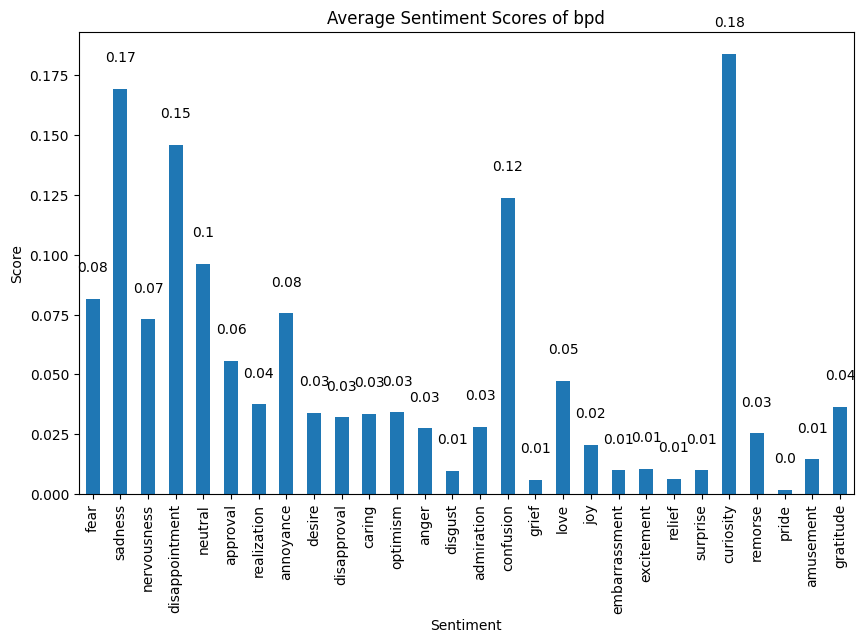

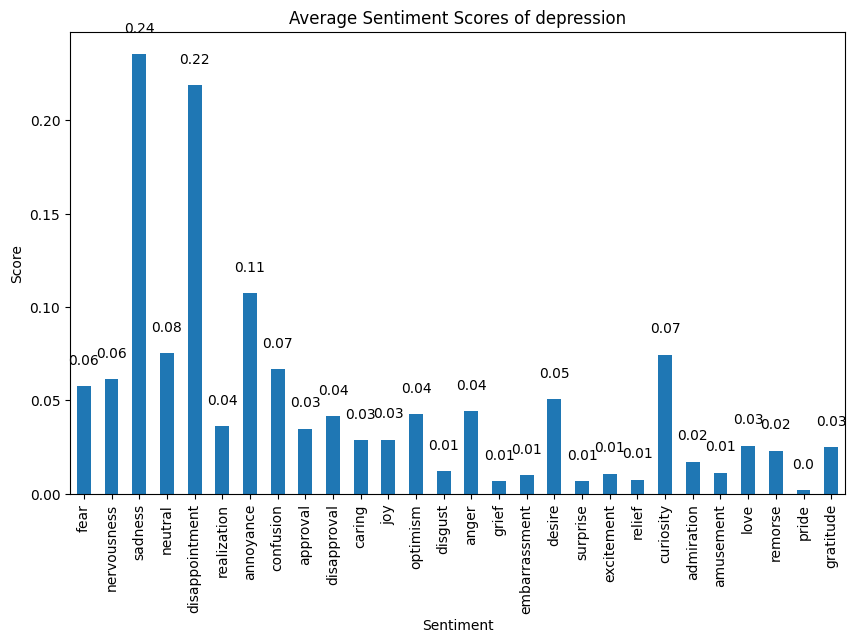

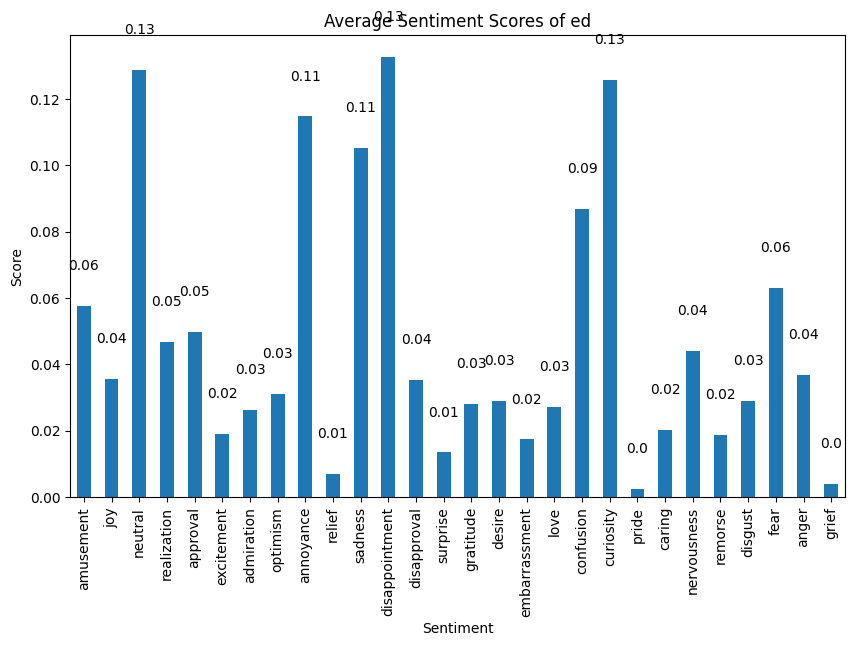

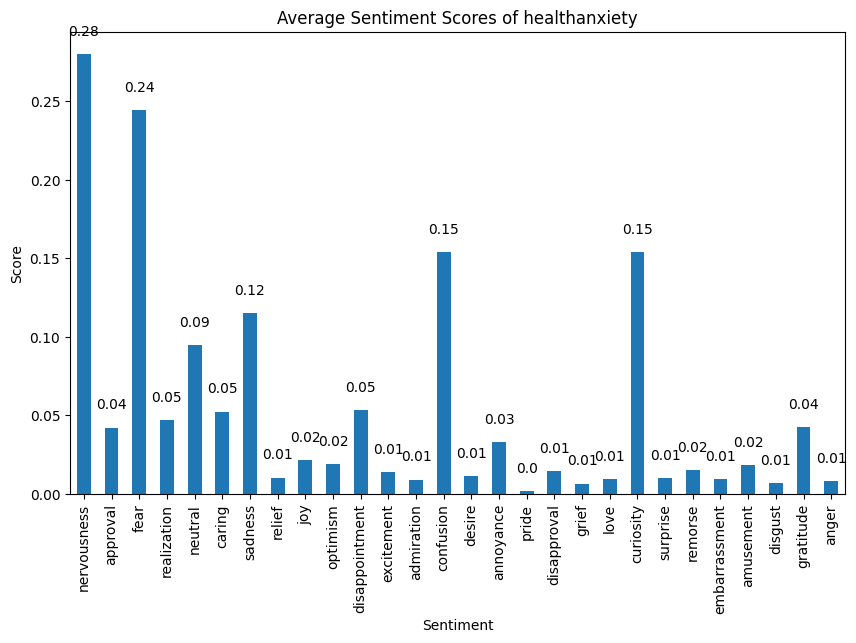

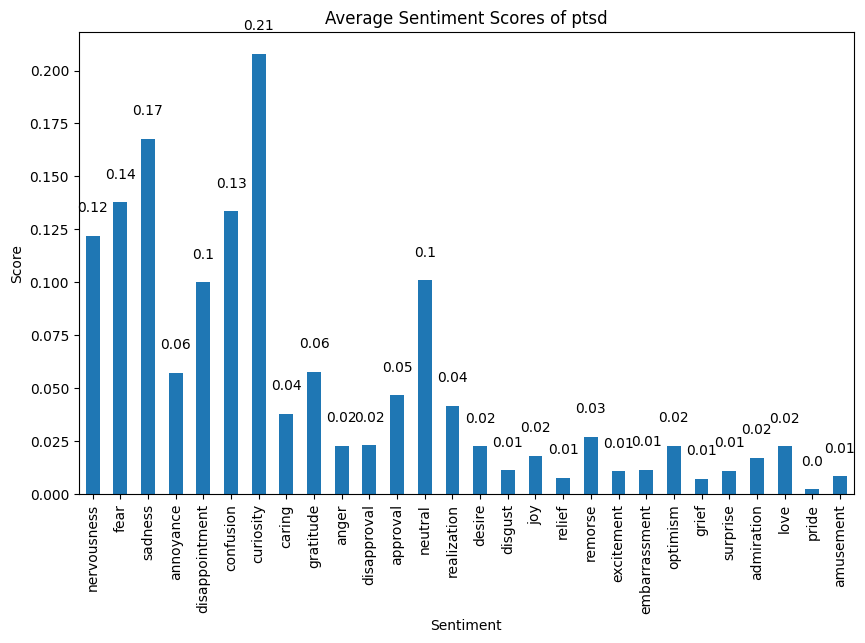

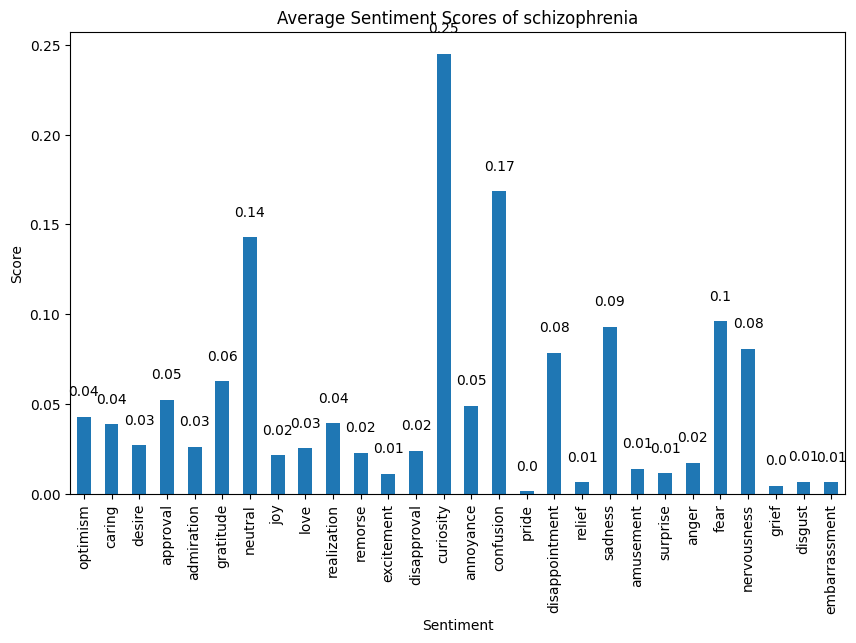

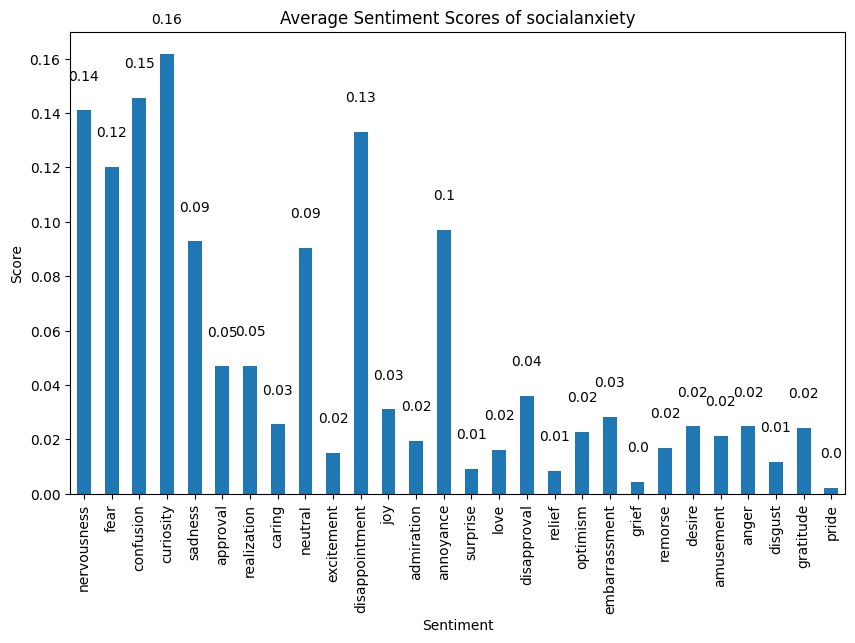

In [17]:
for name, df in sentiment_dfs.items():
    bar_chart(df, name)

### Pie Chart

In [18]:
cmap = plt.get_cmap("nipy_spectral")
colors = [cmap(i) for i in np.linspace(0, 1, len(emotions))]

color_map = dict(zip(emotions, colors))

def pie_chart(df, name):
    mean_sentiments = df.mean()

    plt.figure(figsize=(20, 16))
    # Get the colors for the pie chart
    pie_colors = [color_map[emotion] for emotion in mean_sentiments.index]

    patches, texts, autotexts = plt.pie(mean_sentiments, colors=pie_colors, labels=mean_sentiments.index, autopct='%1.1f%%')
    plt.legend(patches, mean_sentiments.index, loc="center left", bbox_to_anchor=(1, 0.5), fontsize=20)
    # retrieve disease name
    disease_name = name.split("_")[0]
    plt.title(f'Average Sentiment Scores of {disease_name}', fontsize=30)
    new_name = name + "_pie_chart"

    # Adjust the labels
    adjust_text(texts, color='red')

    plt.savefig(f'sentiment_analysis/pie_charts/{new_name}.png')

    plt.show()


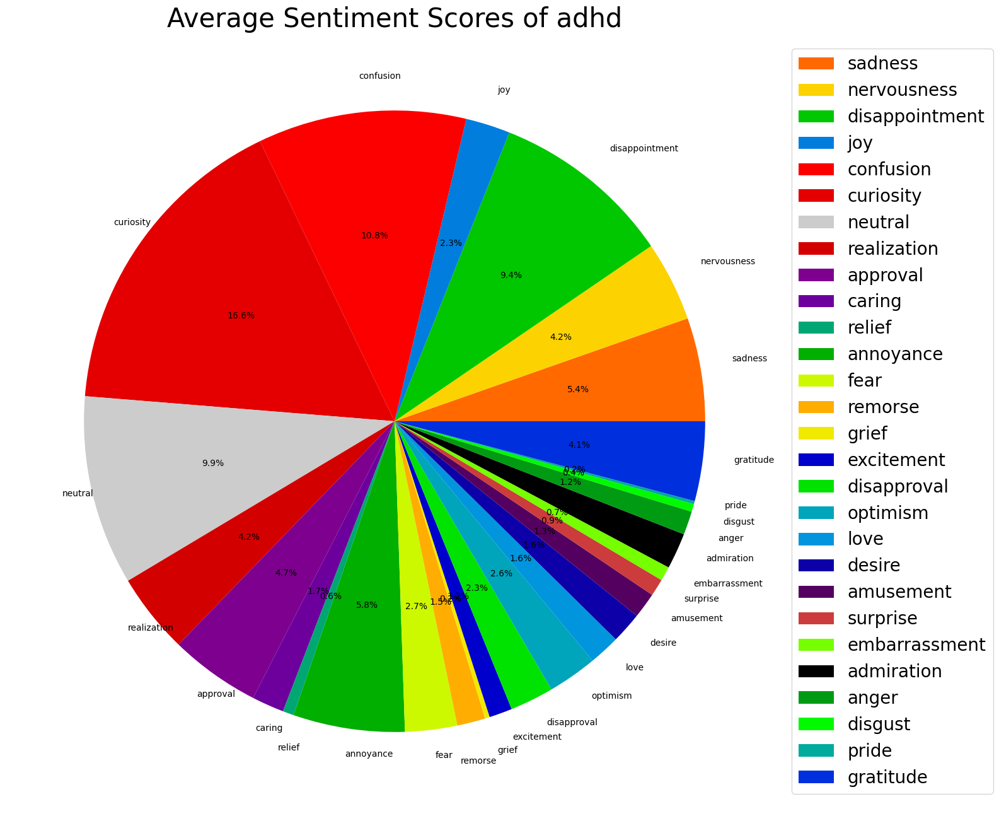

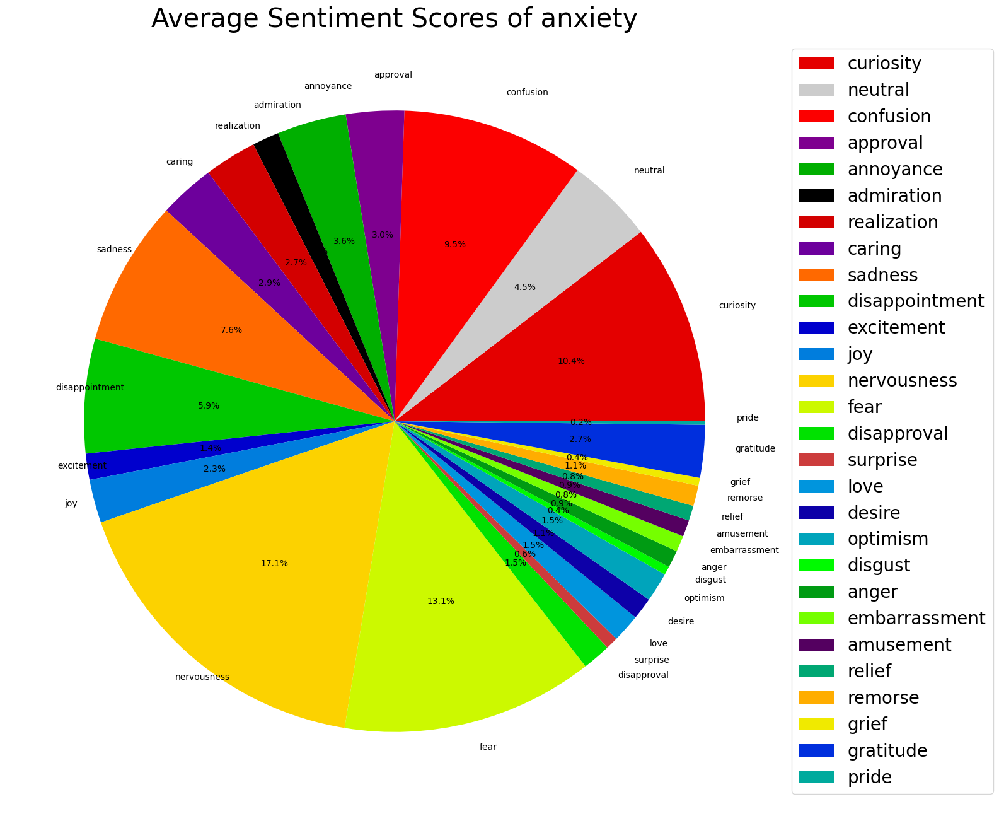

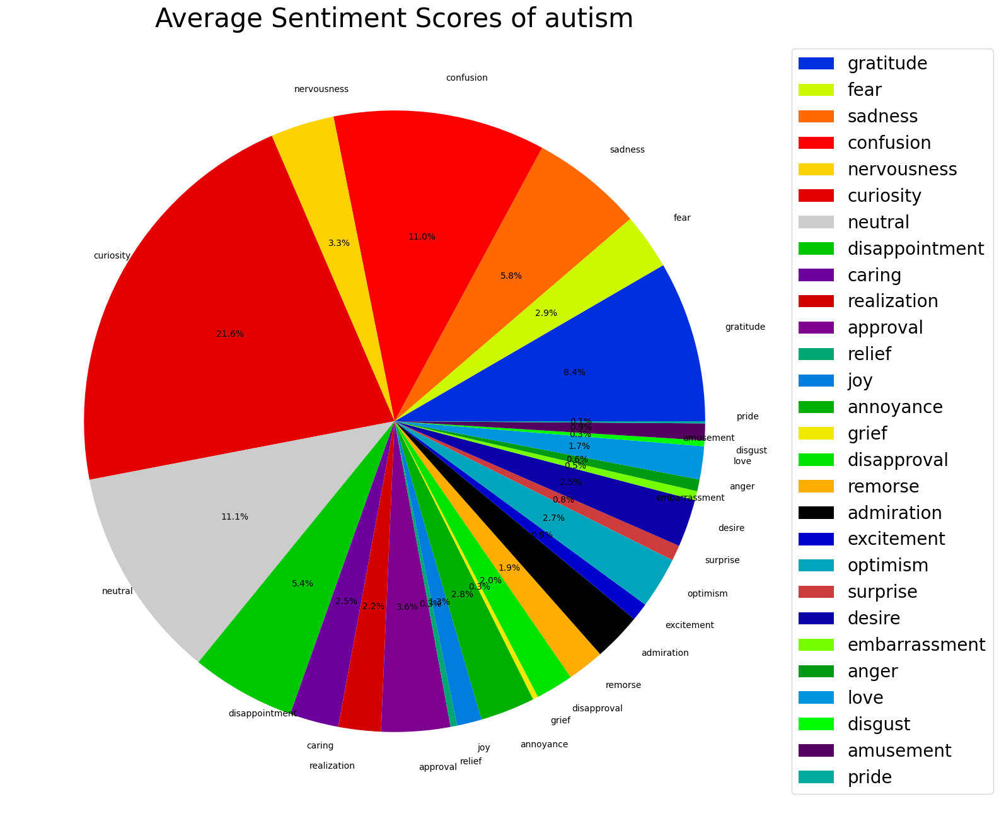

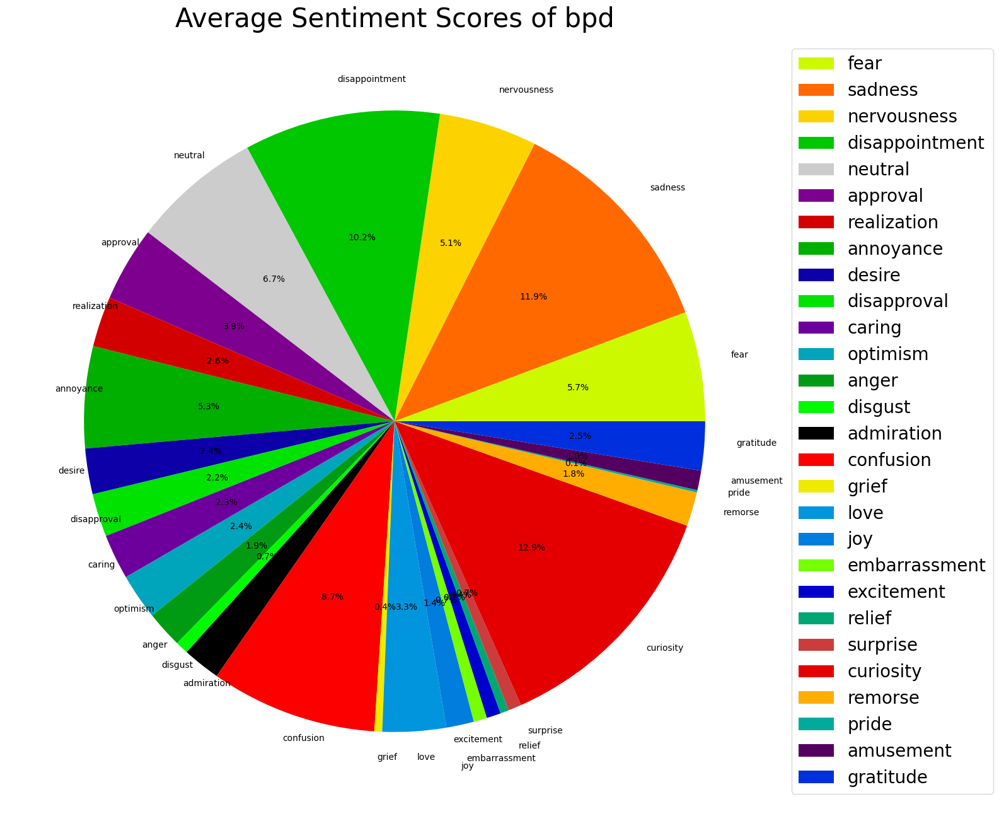

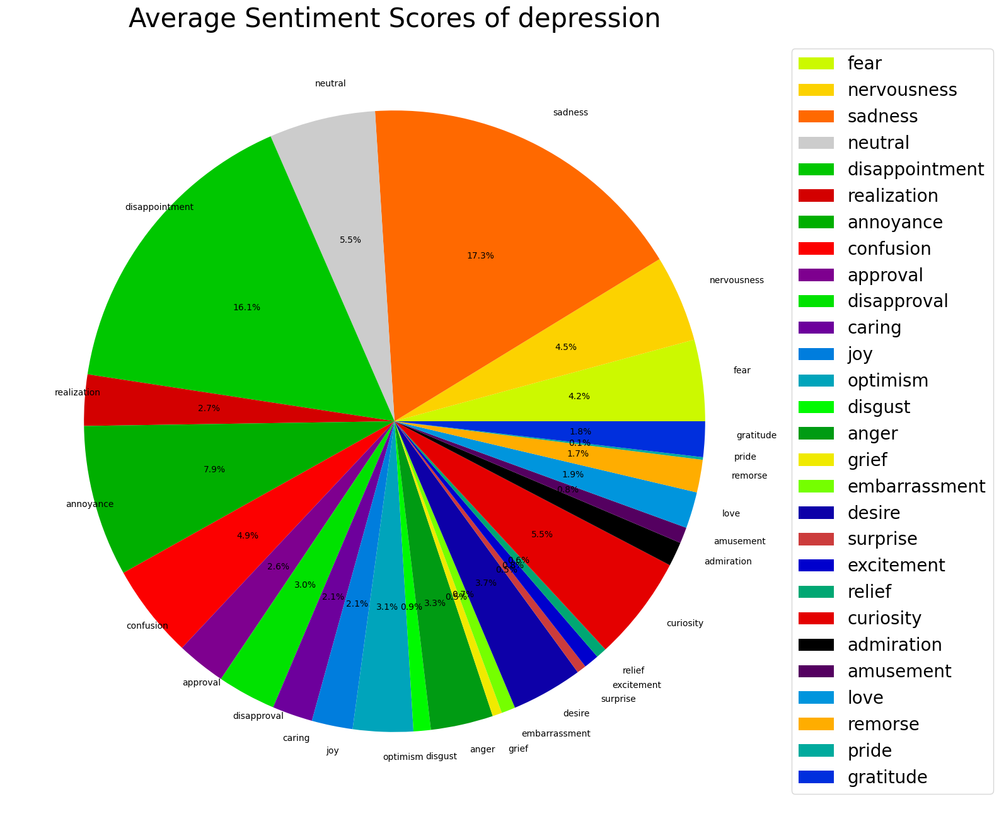

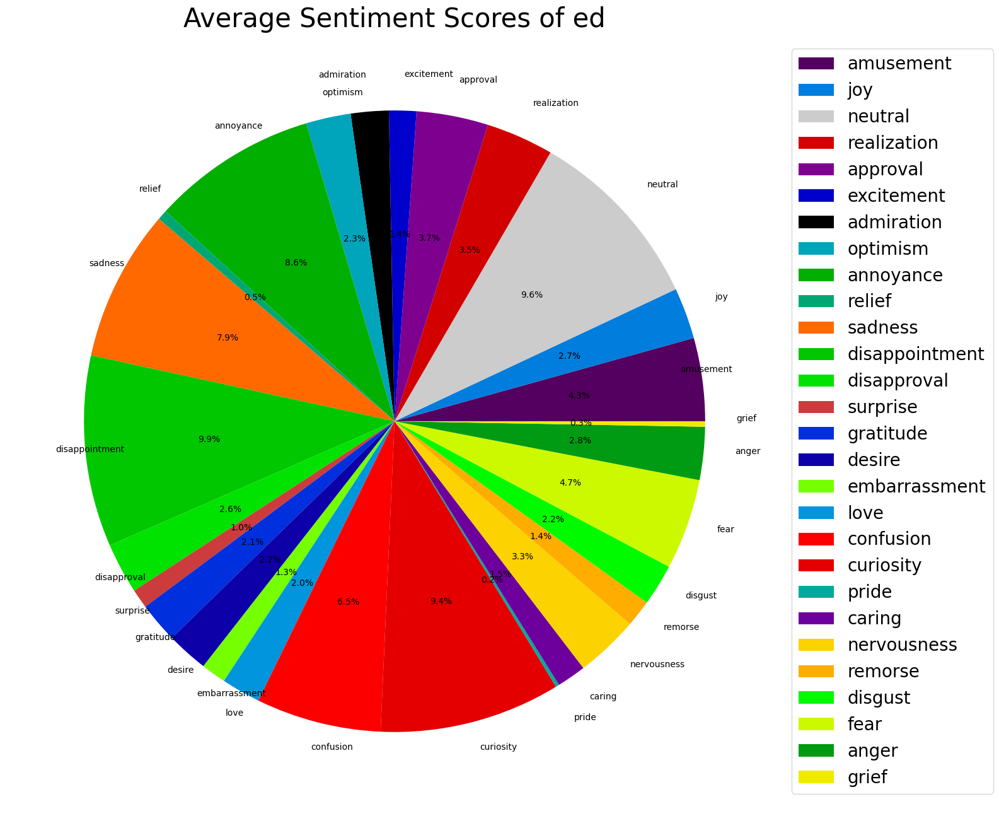

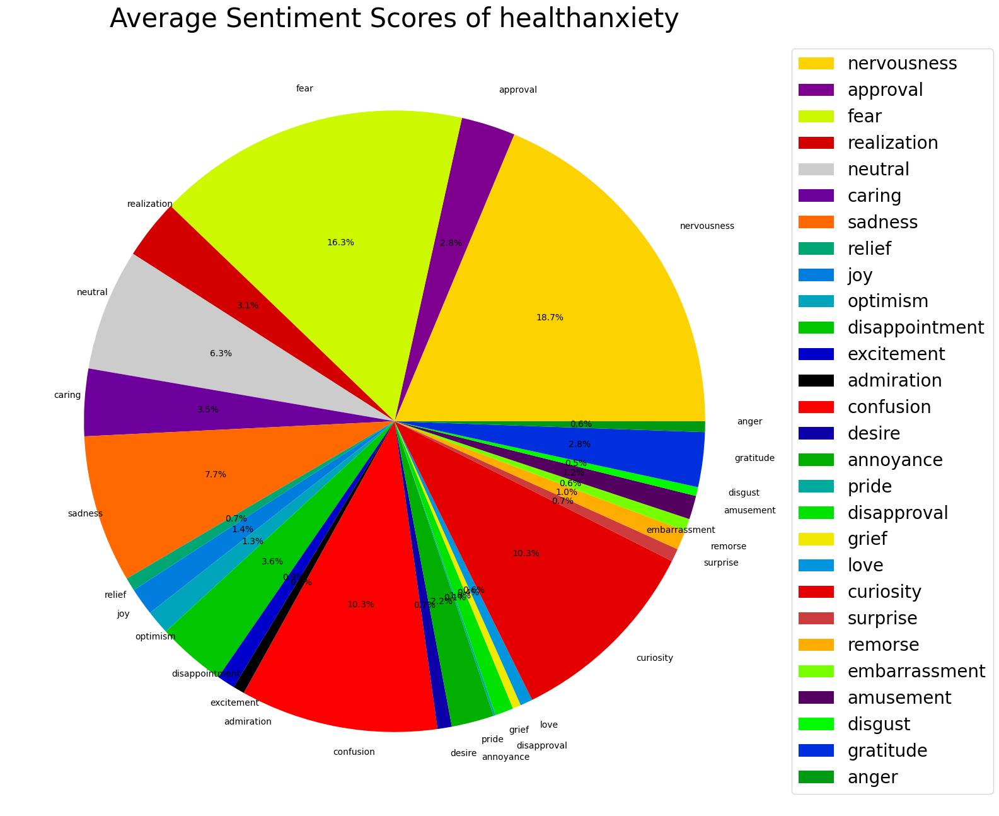

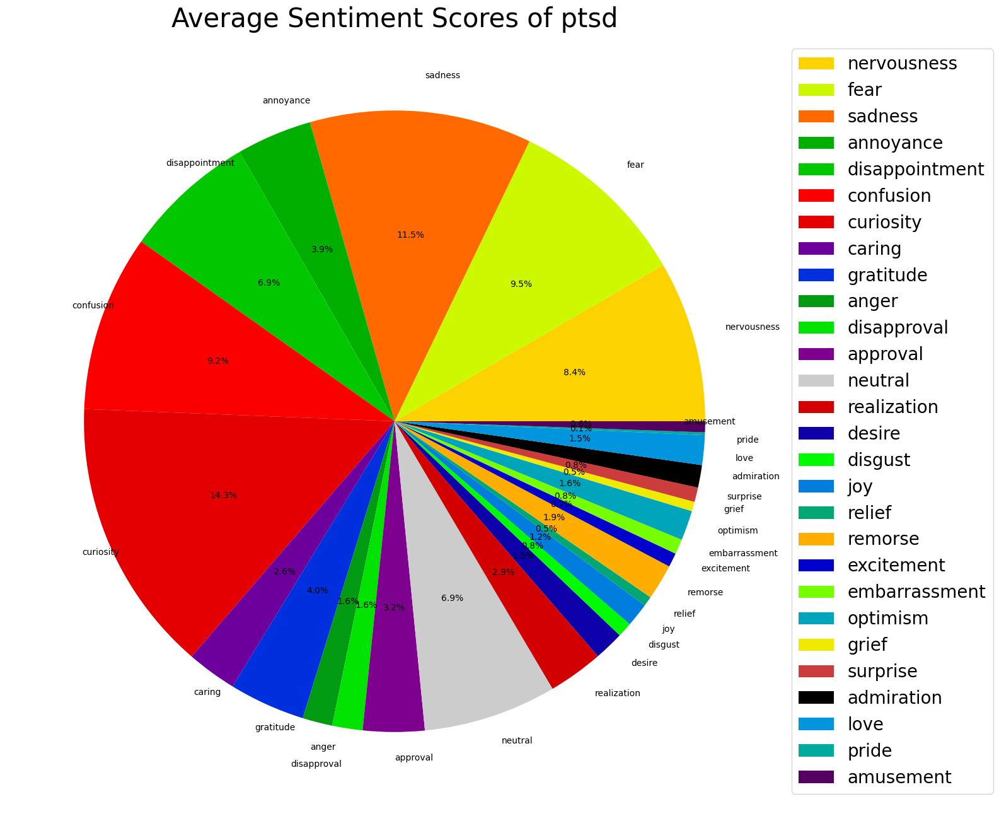

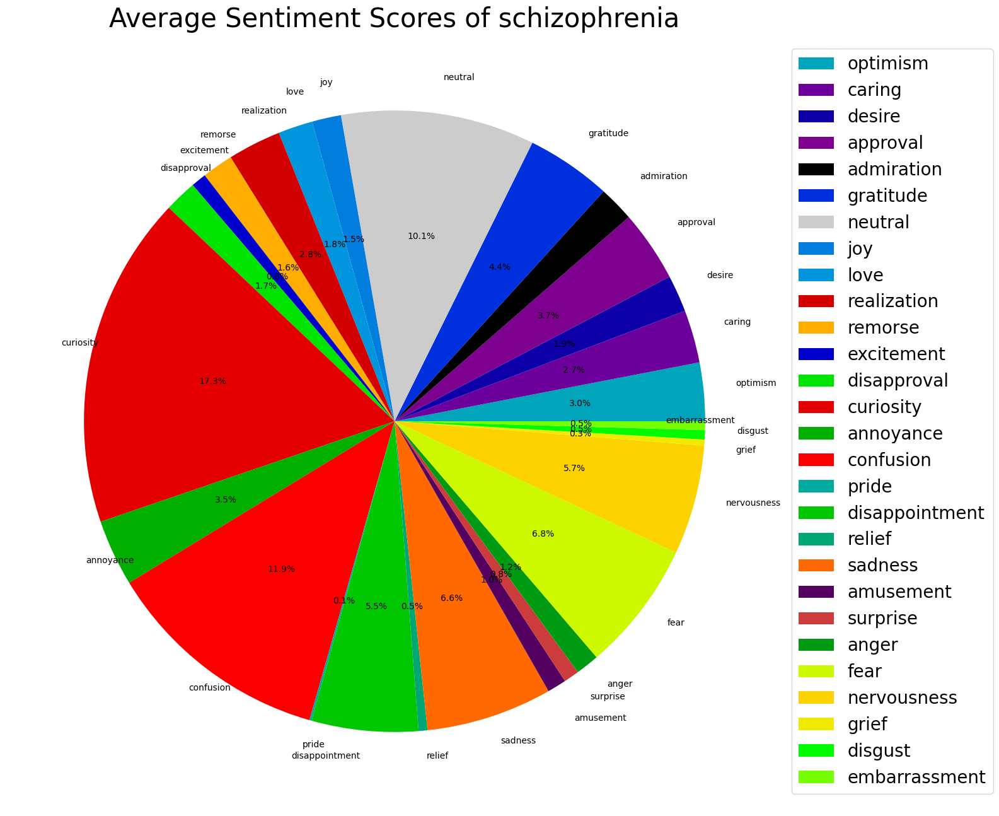

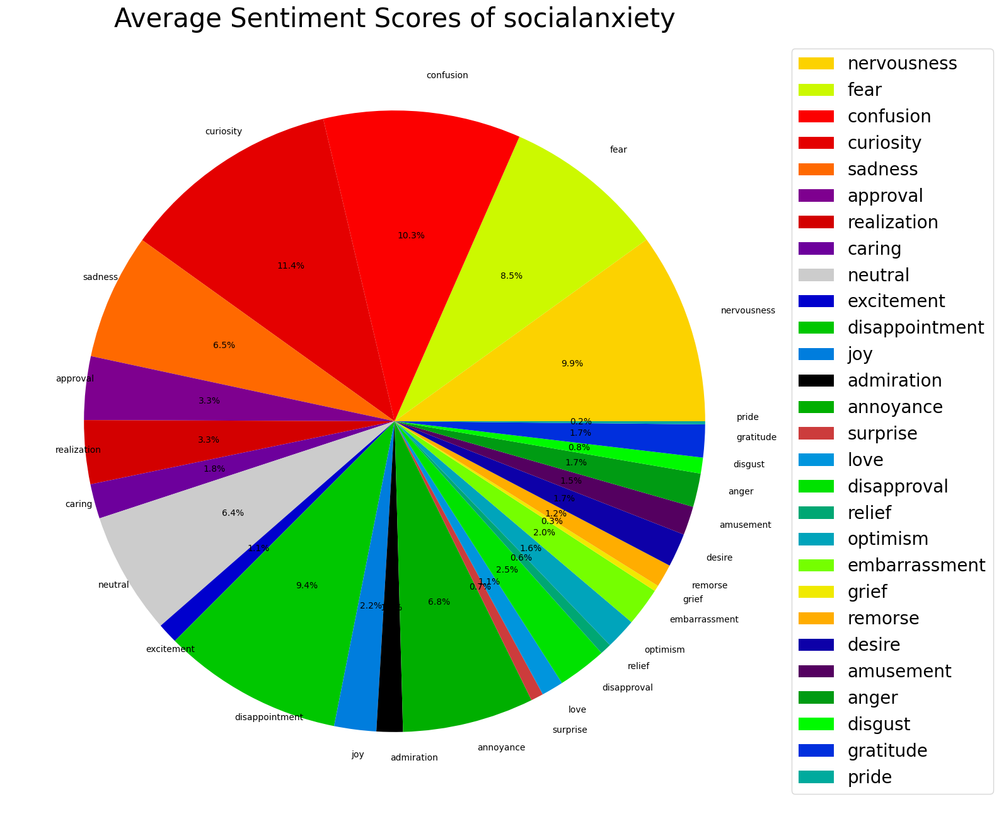

In [19]:
for name, df in sentiment_dfs.items():
    pie_chart(df, name)

## Statistical Analysis

In [20]:
def pretty_table(df, significant_pairs):
    for pair in df.index:
        for parameter in df.columns:
            if pair in significant_pairs and parameter in significant_pairs[pair]:
                df.loc[pair, parameter] = 'Significant'
            else:
                df.loc[pair, parameter] = 'Insignificant'

    table = PrettyTable()

    table.field_names = ["Condition Pair"] + list(df.columns)
    for index, row in df.iterrows():
        table.add_row([index] + list(row))

    print(table)

def export_pdf_png(df, filename):
    fig, ax =plt.subplots(figsize=(60, 20))

    colormap = {"Significant": "red",
                "Insignificant": "white",
                "adhd": "white",
                "anxiety": "white",
                "autism": "white",
                "bpd": "white",
                "depression": "white",
                "ed": "white",
                "healthanxiety": "white",
                "ptsd": "white",
                "schizophrenia": "white",
                "socialanxiety": "white"
                }

    df_reset = df.reset_index()
    df_reset.rename(columns={'level_0': 'Disease 1', 'level_1': 'Disease 2'}, inplace=True)
    df_reset['Disease 1'] = df_reset['Disease 1'].apply(lambda x: x.split('_')[0])
    df_reset['Disease 2'] = df_reset['Disease 2'].apply(lambda x: x.split('_')[0])

    table = ax.table(cellText=df_reset.values, cellColours=[[colormap[i] for i in j] for j in df_reset.values], cellLoc = 'center', loc='center', colLabels=df_reset.columns)

    ax.axis('off')

    pdf = matplotlib.backends.backend_pdf.PdfPages("sentiment_analysis/statistical_analysis/sentiment_analysis_" + filename + ".pdf")
    pdf.savefig(fig, bbox_inches='tight')
    pdf.close()

    plt.savefig("sentiment_analysis/statistical_analysis/sentiment_analysis_" + filename + ".png", bbox_inches='tight')


def export_ipywidgets(df, significant_pairs):
    for pair in df.index:
        for parameter in df.columns:
            if pair in significant_pairs and parameter in significant_pairs[pair]:
                df.loc[pair, parameter] = 'Significant'
            else:
                df.loc[pair, parameter] = 'Insignificant'

    items = [widgets.Button(description='' if pair in df.index and parameter in emotions else parameter if parameter in emotions else pair[j], 
                            layout=widgets.Layout(width="100px"), 
                            style=widgets.ButtonStyle(button_color='red' if pair in df.index and parameter in emotions and df.loc[pair, parameter] == 'Significant' else 'pink' if pair in df.index and parameter in emotions and df.loc[pair, parameter] == 'Insignificant' else 'white')) 
            for i, pair in enumerate(itertools.chain([('', '')], df.index)) for j, parameter in enumerate(list(pair) + list(df.columns))]
    grid = widgets.GridBox(items, layout=widgets.Layout(grid_template_columns="repeat(30, 100px)"))
    return grid

### ANOVA Test

In [21]:
anova_significant_pairs = {}
anova_insignificant_pairs = {}

for parameter in emotions:
    for pair in itertools.combinations(diseases, 2):
        disease_1 = pair[0]
        disease_2 = pair[1]
        group_1 = sentiment_dfs[disease_1][parameter]
        group_2 = sentiment_dfs[disease_2][parameter]

        f_stat, p_value = f_oneway(group_1, group_2)
        if p_value < 0.05: 
            if (disease_1, disease_2) not in anova_significant_pairs:
                anova_significant_pairs[(disease_1, disease_2)] = []
            anova_significant_pairs[(disease_1, disease_2)].append(parameter)
        else:
            if (disease_1, disease_2) not in anova_insignificant_pairs:
                anova_insignificant_pairs[(disease_1, disease_2)] = []
            anova_insignificant_pairs[(disease_1, disease_2)].append(parameter)
        print(f"ANOVA results for {parameter} between {disease_1} and {disease_2}: F-statistic = {f_stat}, p-value = {p_value}")

for pair, parameters in anova_significant_pairs.items():
    if pair in anova_insignificant_pairs:
        print(f"{pair[0]} and {pair[1]}: {', '.join(parameters)} : {', '.join(anova_insignificant_pairs[pair])}")
    else:
        print(f"{pair[0]} and {pair[1]}: {', '.join(parameters)} : No insignificant parameters")
for pair, parameters in anova_insignificant_pairs.items():
    if pair not in anova_significant_pairs:
        print(f"{pair[0]} and {pair[1]}: No significant parameters : {', '.join(parameters)}")

ANOVA results for admiration between adhd_sentiment and anxiety_sentiment: F-statistic = 2.078700344745191, p-value = 0.14952079703804075
ANOVA results for admiration between adhd_sentiment and autism_sentiment: F-statistic = 4.652292930865519, p-value = 0.031156919754241636
ANOVA results for admiration between adhd_sentiment and bpd_sentiment: F-statistic = 0.5582076026515137, p-value = 0.4550715954695077
ANOVA results for admiration between adhd_sentiment and depression_sentiment: F-statistic = 6.665104715229387, p-value = 0.009901720236899095
ANOVA results for admiration between adhd_sentiment and ed_sentiment: F-statistic = 0.07744918645411564, p-value = 0.7808120736488816
ANOVA results for admiration between adhd_sentiment and healthanxiety_sentiment: F-statistic = 31.909745513543356, p-value = 1.884160842624107e-08
ANOVA results for admiration between adhd_sentiment and ptsd_sentiment: F-statistic = 5.267703058752097, p-value = 0.021852345950385658
ANOVA results for admiration be

In [22]:
anova_df = pd.DataFrame(index=pd.MultiIndex.from_tuples(itertools.combinations(sentiment_dfs.keys(), 2)), columns=emotions)

pretty_table(anova_df, anova_significant_pairs)

+--------------------------------------------------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+----------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+
|                     Condition Pair                     |   admiration  |   amusement   |    approval   |     caring    |     desire    |   excitement  |   gratitude   |      joy      |      love     |    optimism   |     pride     |     relief    |     anger     |   annoyance   | disappointment |  disapproval  |    disgust    | embarrassment |      fear     |     grief     |  nervousness  |    remorse    |    sadness    |   confusion   |   curiosity   |  realization  |    surprise   | 

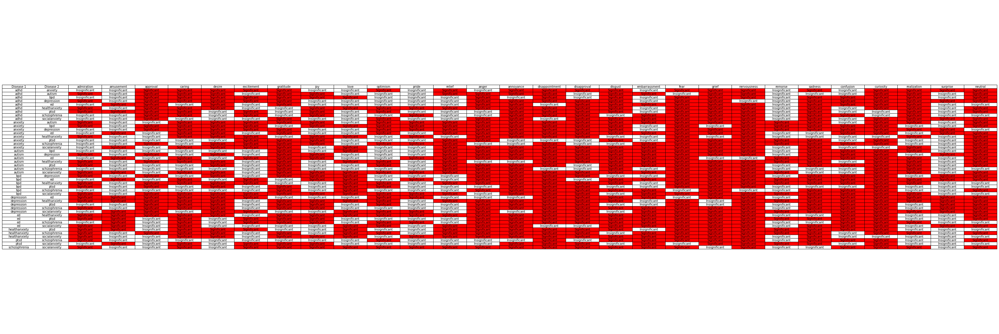

In [23]:
export_pdf_png(anova_df, "anova_test")

In [24]:
export_ipywidgets(anova_df, anova_significant_pairs)

GridBox(children=(Button(layout=Layout(width='100px'), style=ButtonStyle(button_color='white')), Button(layout…

### T-Test

In [25]:
t_test_significant_pairs = {} 
t_test_insignificant_pairs = {}

for parameter in emotions:
    for pair in itertools.combinations(diseases, 2):
        disease_1 = pair[0]
        disease_2 = pair[1]

        group_1 = sentiment_dfs[disease_1][parameter]
        group_2 = sentiment_dfs[disease_2][parameter]

        t_stat, p_value = ttest_ind(group_1, group_2)
        if p_value < 0.05:
            if (disease_1, disease_2) not in t_test_significant_pairs:
                t_test_significant_pairs[(disease_1, disease_2)] = []
            t_test_significant_pairs[(disease_1, disease_2)].append(parameter)
        else:
            if (disease_1, disease_2) not in t_test_insignificant_pairs:
                t_test_insignificant_pairs[(disease_1, disease_2)] = []
            t_test_insignificant_pairs[(disease_1, disease_2)].append(parameter)
        print(f"T-test results for {parameter} between {disease_1} and {disease_2}: T-statistic = {t_stat}, p-value = {p_value}")

for pair, parameters in t_test_significant_pairs.items():
    if pair in t_test_insignificant_pairs:
        print(f"{pair[0]} and {pair[1]}: {', '.join(parameters)} : {', '.join(t_test_insignificant_pairs[pair])}")
    else:
        print(f"{pair[0]} and {pair[1]}: {', '.join(parameters)} : No insignificant parameters")
for pair, parameters in t_test_insignificant_pairs.items():
    if pair not in t_test_significant_pairs:
        print(f"{pair[0]} and {pair[1]}: No significant parameters : {', '.join(parameters)}")

T-test results for admiration between adhd_sentiment and anxiety_sentiment: T-statistic = 1.441769865389476, p-value = 0.149520797037856
T-test results for admiration between adhd_sentiment and autism_sentiment: T-statistic = -2.156917460373835, p-value = 0.031156919754255035
T-test results for admiration between adhd_sentiment and bpd_sentiment: T-statistic = -0.747132921675597, p-value = 0.45507159546976217
T-test results for admiration between adhd_sentiment and depression_sentiment: T-statistic = 2.581686409157663, p-value = 0.009901720236905626
T-test results for admiration between adhd_sentiment and ed_sentiment: T-statistic = -0.2782969393545602, p-value = 0.780812073648842
T-test results for admiration between adhd_sentiment and healthanxiety_sentiment: T-statistic = 5.648871171618569, p-value = 1.884160842623599e-08
T-test results for admiration between adhd_sentiment and ptsd_sentiment: T-statistic = 2.295147720464218, p-value = 0.021852345950371287
T-test results for admirat

In [26]:
t_test_df = pd.DataFrame(index=pd.MultiIndex.from_tuples(itertools.combinations(sentiment_dfs.keys(), 2)), columns=emotions)

pretty_table(t_test_df, t_test_significant_pairs)

+--------------------------------------------------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+----------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+
|                     Condition Pair                     |   admiration  |   amusement   |    approval   |     caring    |     desire    |   excitement  |   gratitude   |      joy      |      love     |    optimism   |     pride     |     relief    |     anger     |   annoyance   | disappointment |  disapproval  |    disgust    | embarrassment |      fear     |     grief     |  nervousness  |    remorse    |    sadness    |   confusion   |   curiosity   |  realization  |    surprise   | 

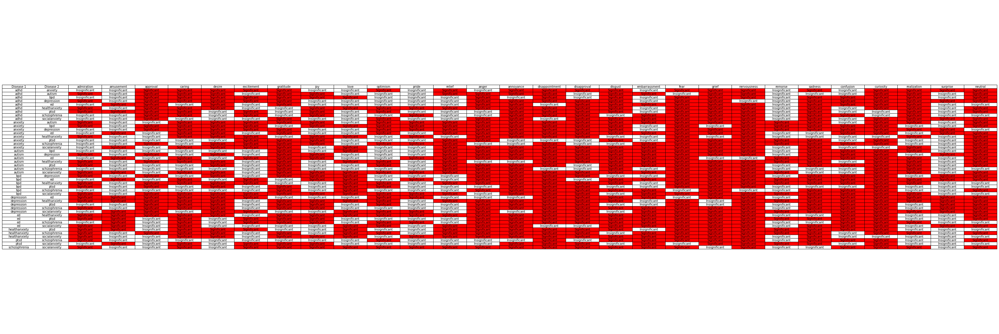

In [27]:
export_pdf_png(t_test_df, "t_test")

In [28]:
export_ipywidgets(t_test_df, t_test_significant_pairs)

GridBox(children=(Button(layout=Layout(width='100px'), style=ButtonStyle(button_color='white')), Button(layout…

### Tuckey's HSD Test

In [29]:
tukeys_rejected_parameters = {pair: [] for pair in itertools.combinations(diseases, 2)}
tukeys_not_rejected_parameters = {pair: [] for pair in itertools.combinations(diseases, 2)}

for parameter in emotions:
    data = []
    labels = []
    for disease in diseases:
        data.append(sentiment_dfs[disease][parameter])
        labels.extend([disease] * len(sentiment_dfs[disease][parameter]))

    tukey_results = pairwise_tukeyhsd(np.concatenate(data), labels)
    print(f"Tukey HSD test for {parameter}:")
    print(tukey_results)

    reject_mask = tukey_results.reject
    pairs = tukey_results._results_table.data[1:]

    for i, pair in enumerate(pairs):
        group_1, group_2 = pair[0], pair[1]
        if reject_mask[i]:
            tukeys_rejected_parameters[(group_1, group_2)].append(parameter)
        else:
            tukeys_not_rejected_parameters[(group_1, group_2)].append(parameter)

print("Summary of rejected and not rejected parameters:")
for pair in itertools.combinations(diseases, 2):
    rejected = tukeys_rejected_parameters[pair]
    not_rejected = tukeys_not_rejected_parameters[pair]
    print(f"{pair[0]} and {pair[1]}: Significant parameters - {rejected if rejected else 'None'}, Insignificant parameters - {not_rejected if not_rejected else 'None'}")


Tukey HSD test for admiration:
                 Multiple Comparison of Means - Tukey HSD, FWER=0.05                  
         group1                  group2         meandiff p-adj   lower   upper  reject
--------------------------------------------------------------------------------------
         adhd_sentiment       anxiety_sentiment  -0.0043 0.9512 -0.0145   0.006  False
         adhd_sentiment        autism_sentiment   0.0095  0.241 -0.0023  0.0212  False
         adhd_sentiment           bpd_sentiment   0.0028 0.9979 -0.0076  0.0132  False
         adhd_sentiment    depression_sentiment  -0.0081 0.2766 -0.0184  0.0022  False
         adhd_sentiment            ed_sentiment    0.001    1.0 -0.0092  0.0112  False
         adhd_sentiment healthanxiety_sentiment  -0.0163 0.0002 -0.0276  -0.005   True
         adhd_sentiment          ptsd_sentiment  -0.0083 0.4536 -0.0202  0.0036  False
         adhd_sentiment schizophrenia_sentiment   0.0008    1.0 -0.0097  0.0114  False
         adh

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/scipy/integrate/_quadpack_py.py:1233: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  quad_r = quad(f, low, high, args=args, full_output=self.full_output,


Tukey HSD test for amusement:
                 Multiple Comparison of Means - Tukey HSD, FWER=0.05                  
         group1                  group2         meandiff p-adj   lower   upper  reject
--------------------------------------------------------------------------------------
         adhd_sentiment       anxiety_sentiment  -0.0049   0.98 -0.0184  0.0086  False
         adhd_sentiment        autism_sentiment  -0.0059 0.9733 -0.0213  0.0096  False
         adhd_sentiment           bpd_sentiment  -0.0035 0.9986 -0.0172  0.0102  False
         adhd_sentiment    depression_sentiment  -0.0066  0.874 -0.0202   0.007  False
         adhd_sentiment            ed_sentiment   0.0396    0.0  0.0262   0.053   True
         adhd_sentiment healthanxiety_sentiment   0.0004    1.0 -0.0144  0.0153  False
         adhd_sentiment          ptsd_sentiment  -0.0097   0.63 -0.0254   0.006  False
         adhd_sentiment schizophrenia_sentiment   -0.004 0.9964 -0.0178  0.0099  False
         adhd

In [30]:
tukeys_df = pd.DataFrame(index=pd.MultiIndex.from_tuples(itertools.combinations(sentiment_dfs.keys(), 2)), columns=emotions)

pretty_table(tukeys_df, tukeys_rejected_parameters)

+--------------------------------------------------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+----------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+---------------+
|                     Condition Pair                     |   admiration  |   amusement   |    approval   |     caring    |     desire    |   excitement  |   gratitude   |      joy      |      love     |    optimism   |     pride     |     relief    |     anger     |   annoyance   | disappointment |  disapproval  |    disgust    | embarrassment |      fear     |     grief     |  nervousness  |    remorse    |    sadness    |   confusion   |   curiosity   |  realization  |    surprise   | 

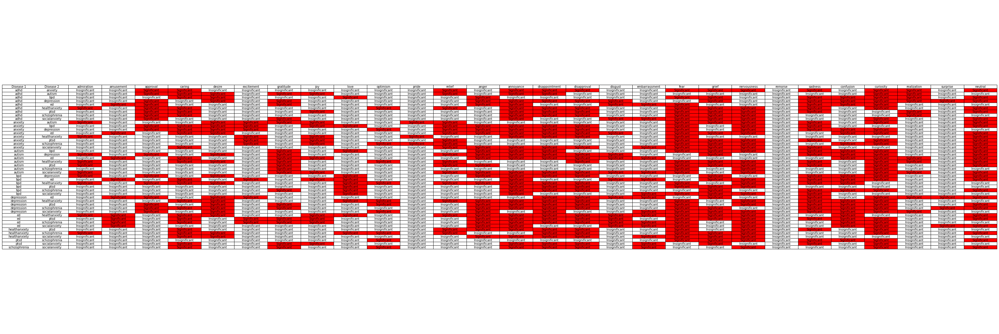

In [31]:
export_pdf_png(tukeys_df, "tukeys_HSD_test")

In [32]:
export_ipywidgets(tukeys_df, tukeys_rejected_parameters)

GridBox(children=(Button(layout=Layout(width='100px'), style=ButtonStyle(button_color='white')), Button(layout…

### Effect Size Calculation

In [33]:
def cohen_d(group1, group2):
    diff = mean(group1) - mean(group2)
    pooled_std = ((len(group1) - 1) * std(group1) ** 2 + (len(group2) - 1) * std(group2) ** 2) / (len(group1) + len(group2) - 2)
    pooled_std = pooled_std ** 0.5
    return diff / pooled_std

effect_sizes = {}
cohens_d_significant_parameters = {pair: [] for pair in itertools.combinations(diseases, 2)}
cohens_d_insignificant_parameters = {pair: [] for pair in itertools.combinations(diseases, 2)}

# Threshold for Cohen's d
cohens_d_threshold = 0.2 

for parameter in emotions:
    for pair in itertools.combinations(diseases, 2):
        dataset_1 = sentiment_dfs[pair[0]][parameter]
        dataset_2 = sentiment_dfs[pair[1]][parameter]

        effect_size = cohen_d(dataset_1, dataset_2)
        if parameter not in effect_sizes:
            effect_sizes[parameter] = {}
        effect_sizes[parameter][pair] = effect_size

        if abs(effect_size) >= cohens_d_threshold:
            cohens_d_significant_parameters[pair].append(parameter)
        else:
            cohens_d_insignificant_parameters[pair].append(parameter)

print("\nEffect sizes for all combinations of datasets and parameters:")
for parameter, pairs in effect_sizes.items():
    print(f"Effect sizes for {parameter}:")
    for pair, effect_size in pairs.items():
        print(f"{pair}: Cohen's d = {effect_size}")
    print()

print("Summary of significant and insignificant parameters for Cohen's d test:")
for pair in itertools.combinations(diseases, 2):
    significant = cohens_d_significant_parameters[pair]
    insignificant = cohens_d_insignificant_parameters[pair]
    print(f"{pair[0]} and {pair[1]}: Significant parameters - {significant if significant else 'None'}, Insignificant parameters - {insignificant if insignificant else 'None'}")


Effect sizes for all combinations of datasets and parameters:
Effect sizes for admiration:
('adhd_sentiment', 'anxiety_sentiment'): Cohen's d = 0.06384716885840873
('adhd_sentiment', 'autism_sentiment'): Cohen's d = -0.1093814707695563
('adhd_sentiment', 'bpd_sentiment'): Cohen's d = -0.03349953239287096
('adhd_sentiment', 'depression_sentiment'): Cohen's d = 0.11485548736343908
('adhd_sentiment', 'ed_sentiment'): Cohen's d = -0.012207116014258374
('adhd_sentiment', 'healthanxiety_sentiment'): Cohen's d = 0.2750522812530417
('adhd_sentiment', 'ptsd_sentiment'): Cohen's d = 0.11790185925594204
('adhd_sentiment', 'schizophrenia_sentiment'): Cohen's d = -0.010268192980200251
('adhd_sentiment', 'socialanxiety_sentiment'): Cohen's d = 0.08507758735488194
('anxiety_sentiment', 'autism_sentiment'): Cohen's d = -0.18117973179925387
('anxiety_sentiment', 'bpd_sentiment'): Cohen's d = -0.09561688009385744
('anxiety_sentiment', 'depression_sentiment'): Cohen's d = 0.06434286440207819
('anxiety_s

## Correlation Analysis
Check if there are any correlations between different sentiment labels within each disease. This could help identify if certain sentiments tend to appear together.

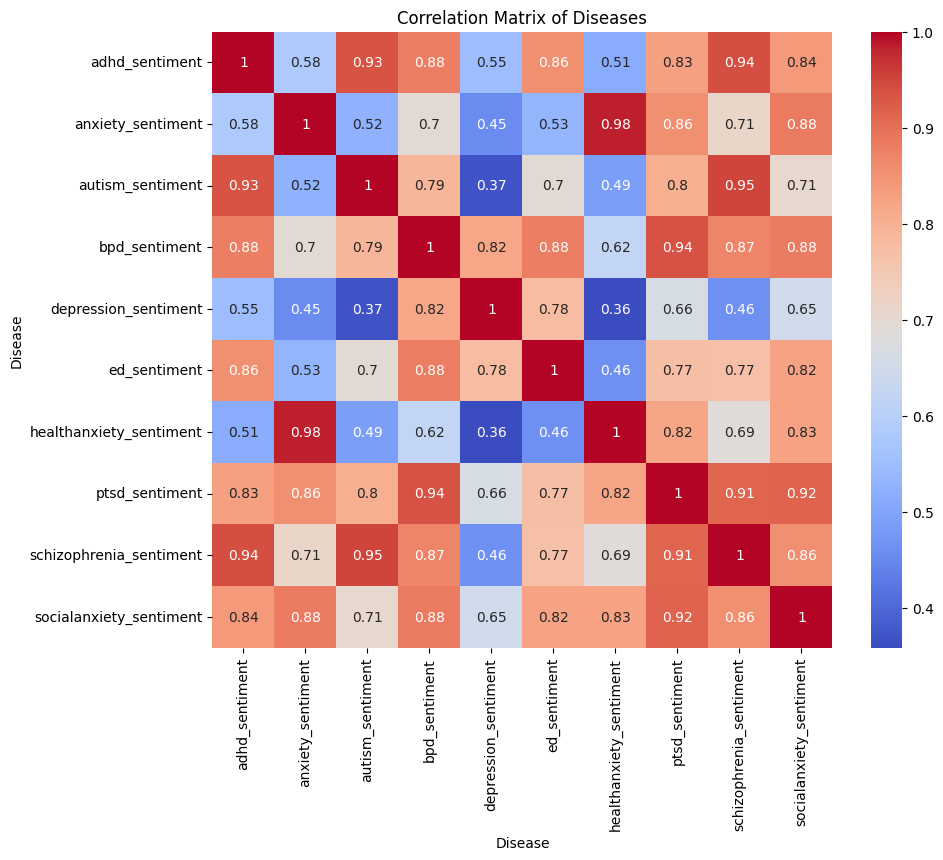

In [34]:
data = []
for disease, df in sentiment_dfs.items():
    for index, row in df.iterrows():
        for sentiment, score in row.items():
            data.append([disease, sentiment, score])

df = pd.DataFrame(data, columns=['Disease', 'Sentiment', 'Score'])

pivot_df = df.pivot_table(values='Score', index='Sentiment', columns='Disease')

corr_matrix = pivot_df.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Diseases')
plt.savefig("sentiment_analysis/correlation_matrix.png", bbox_inches='tight')
plt.show()

#### Interpreting the Correlation Matrix

High positive correlation suggests that the emotional sentiments expressed in texts by patients with the two conditions are quite similar. This could indicate a similarity in the emotional experiences of the two conditions.

Low positive correlation suggests that the emotional sentiments expressed in texts by patients with the two conditions are not similar. This could indicate a difference in the emotional experiences of the two conditions.

## Cluster Analysis
Use machine learning techniques to cluster the diseases based on their sentiment profiles. This could reveal groups of diseases that elicit similar emotional responses.

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


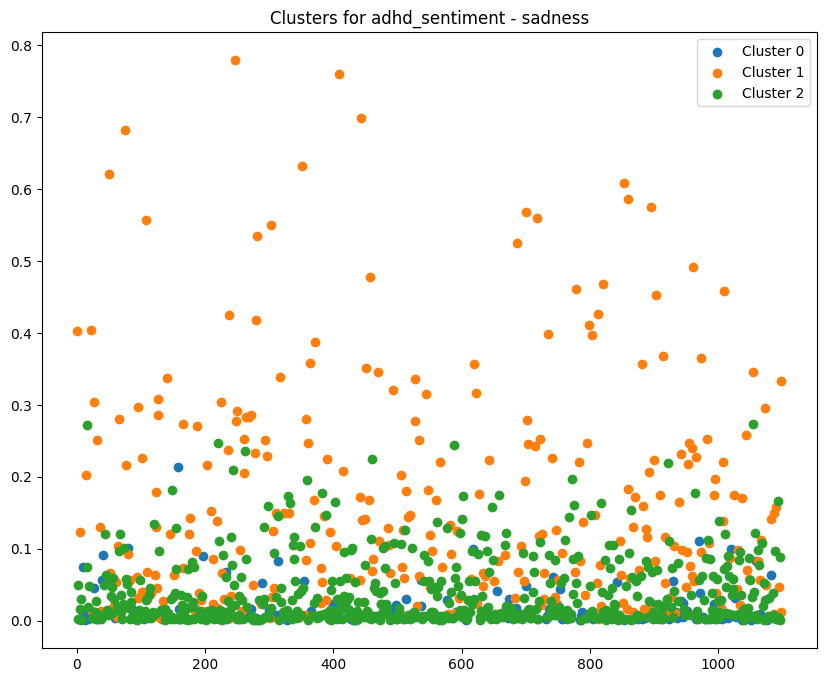

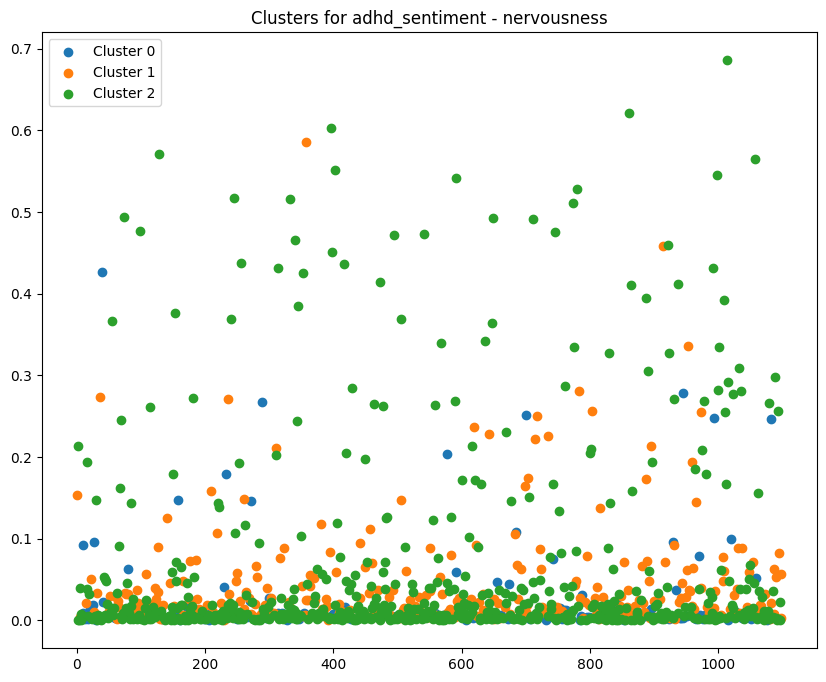

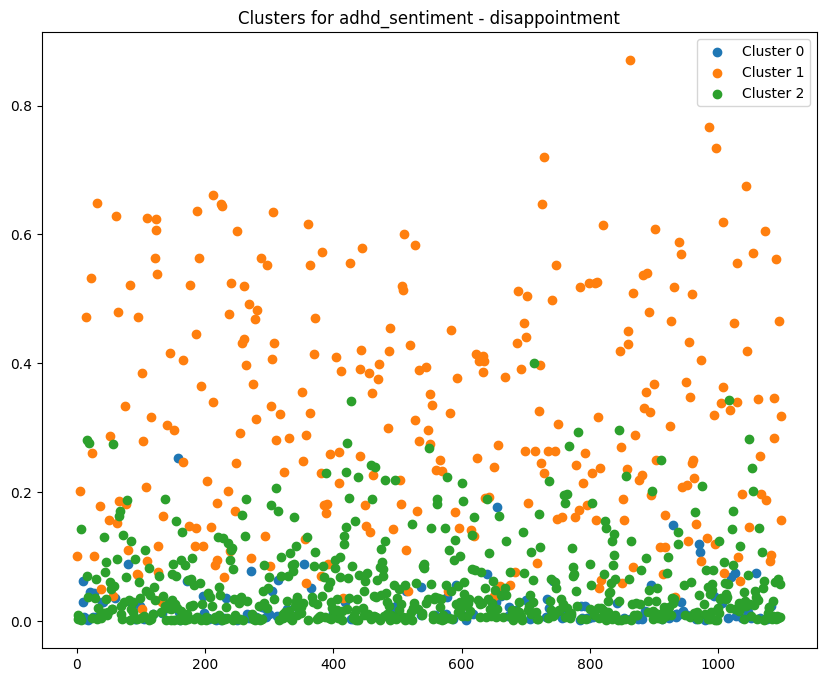

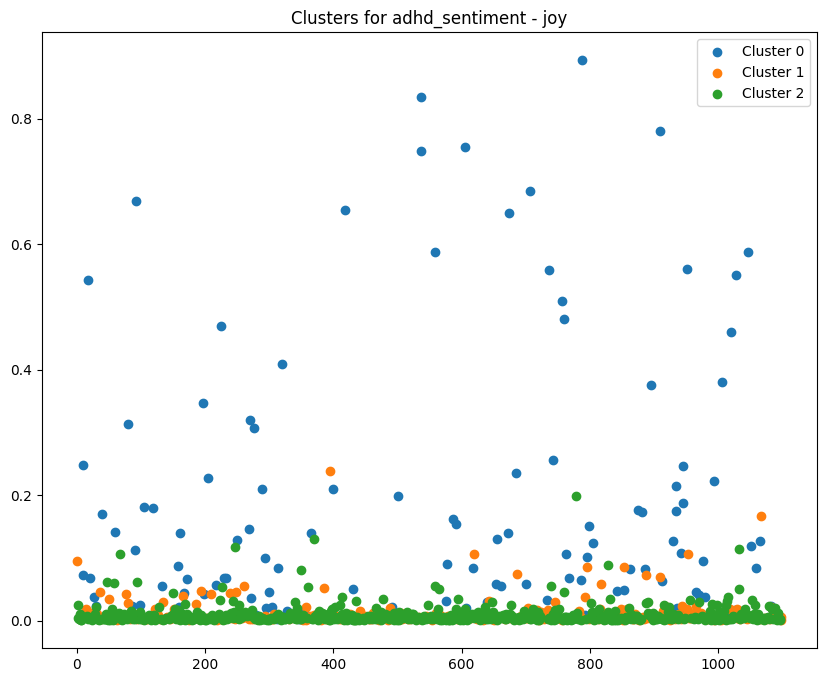

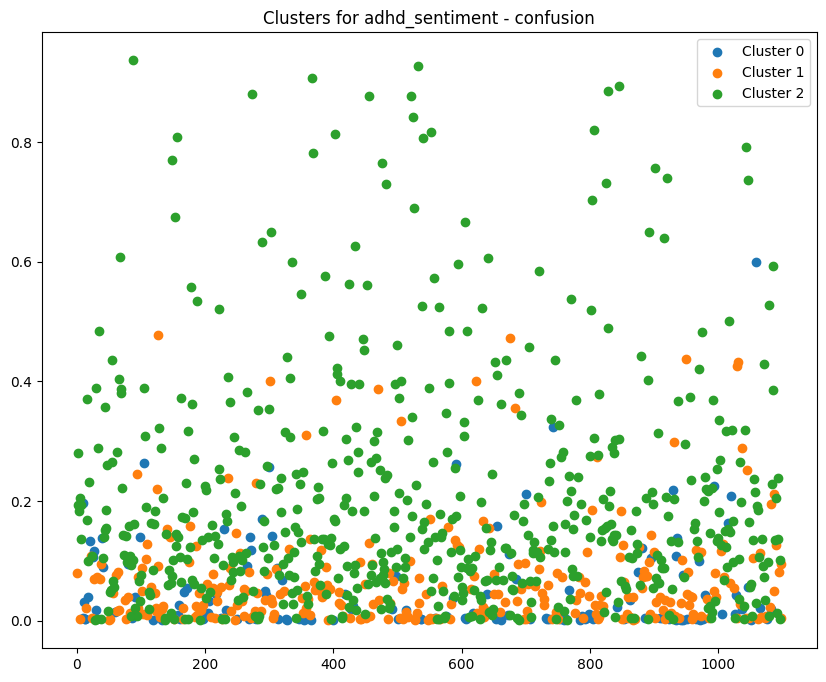

...

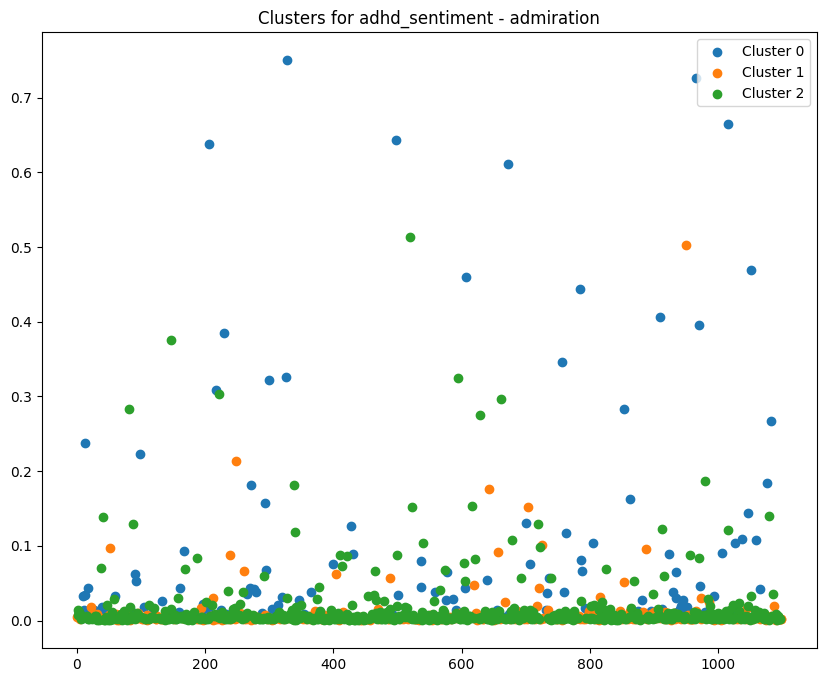

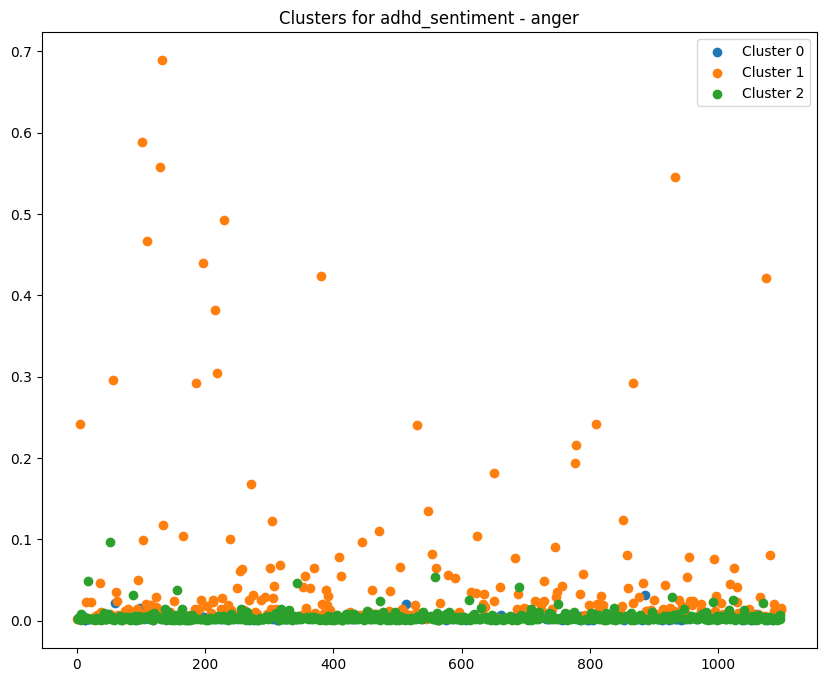

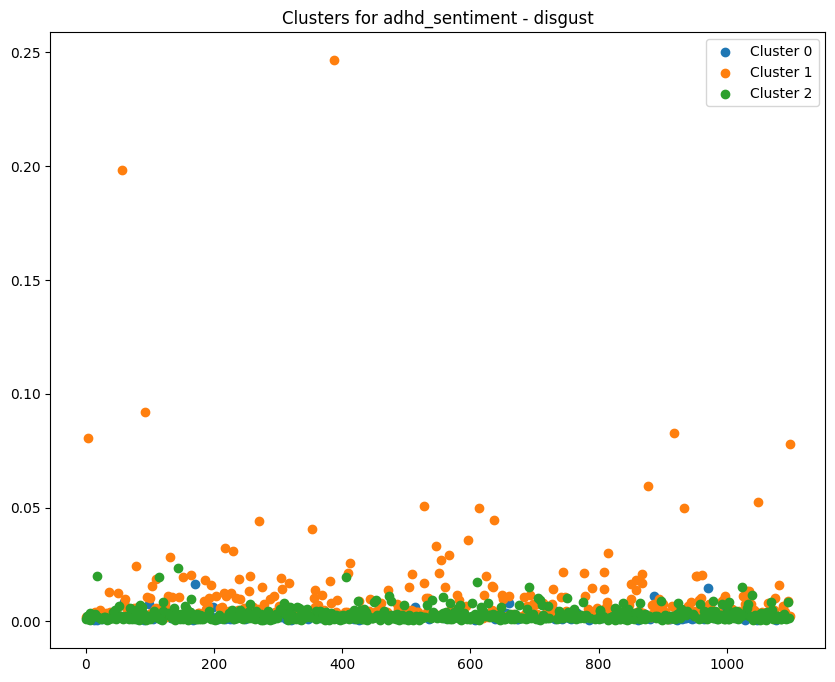

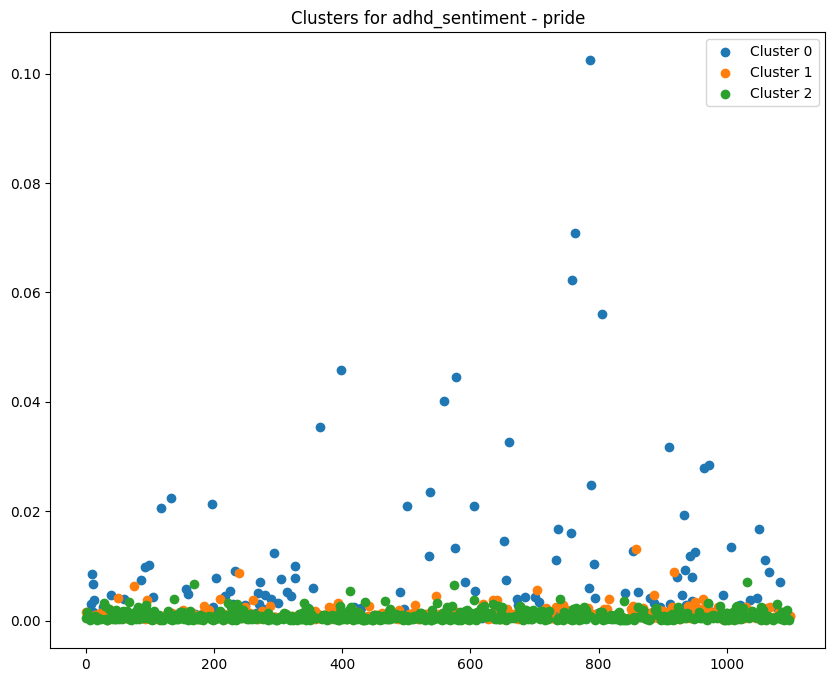

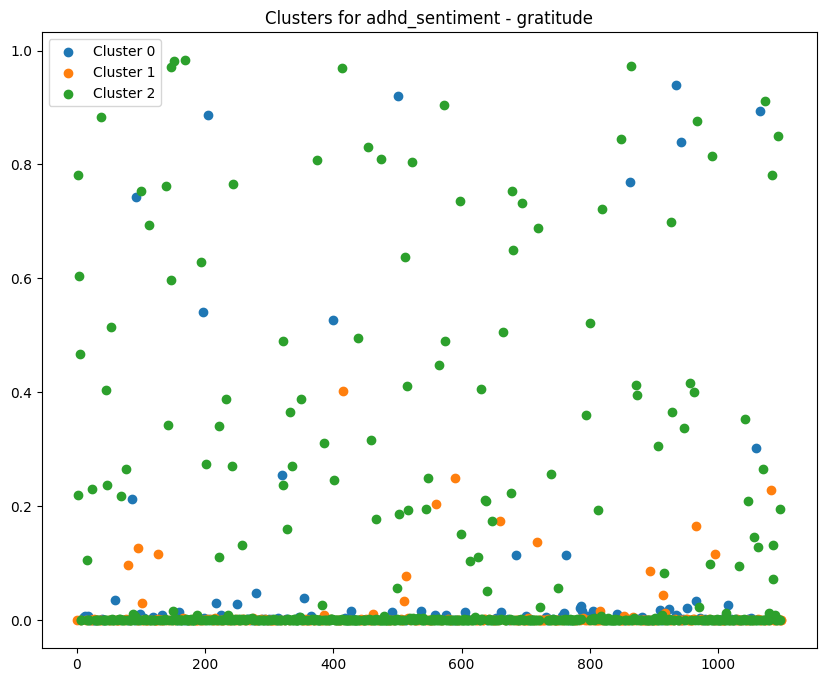

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


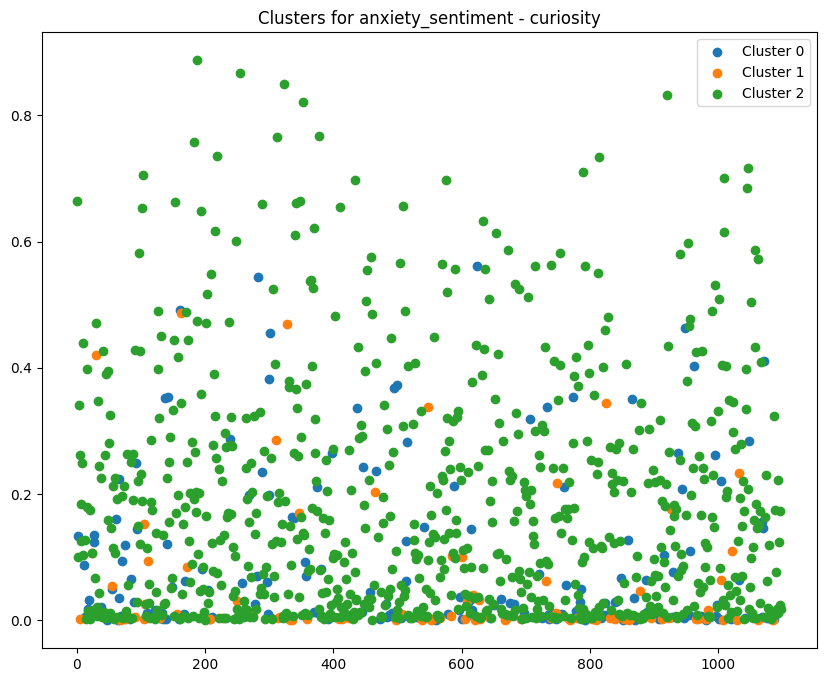

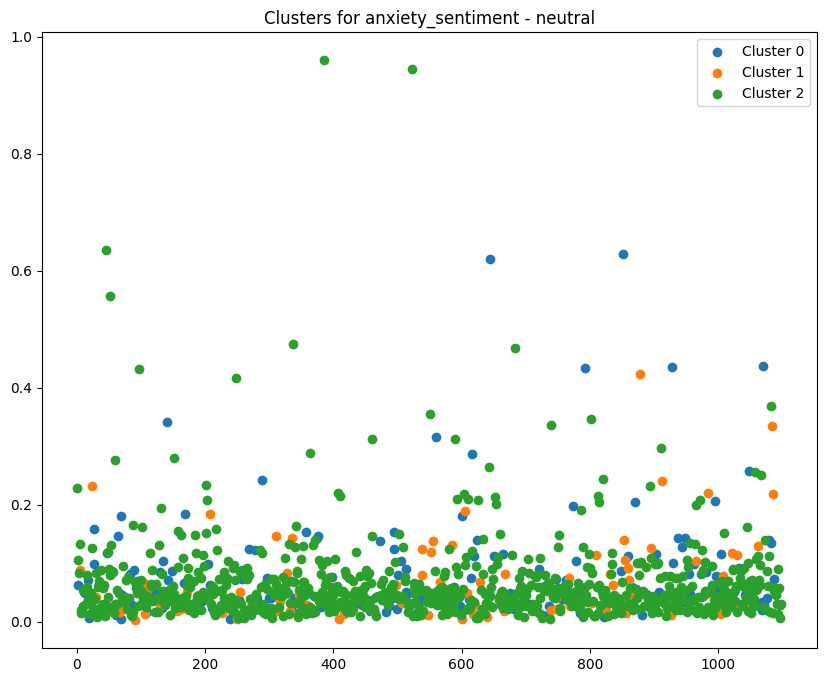

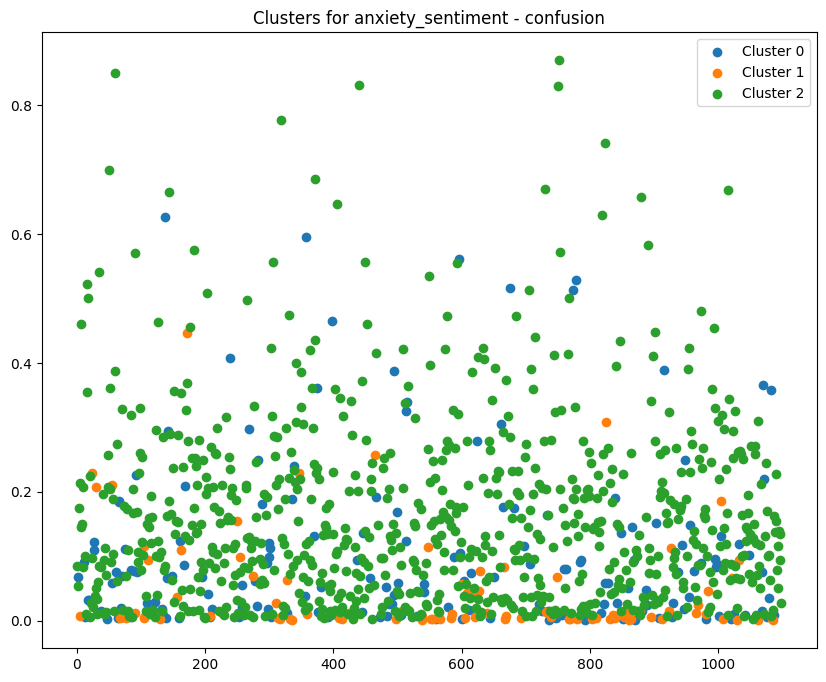

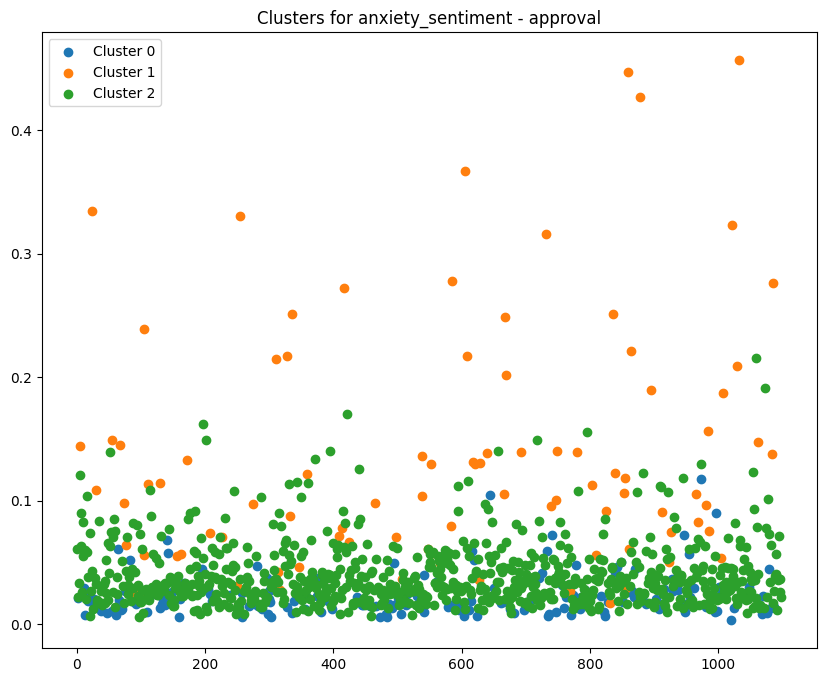

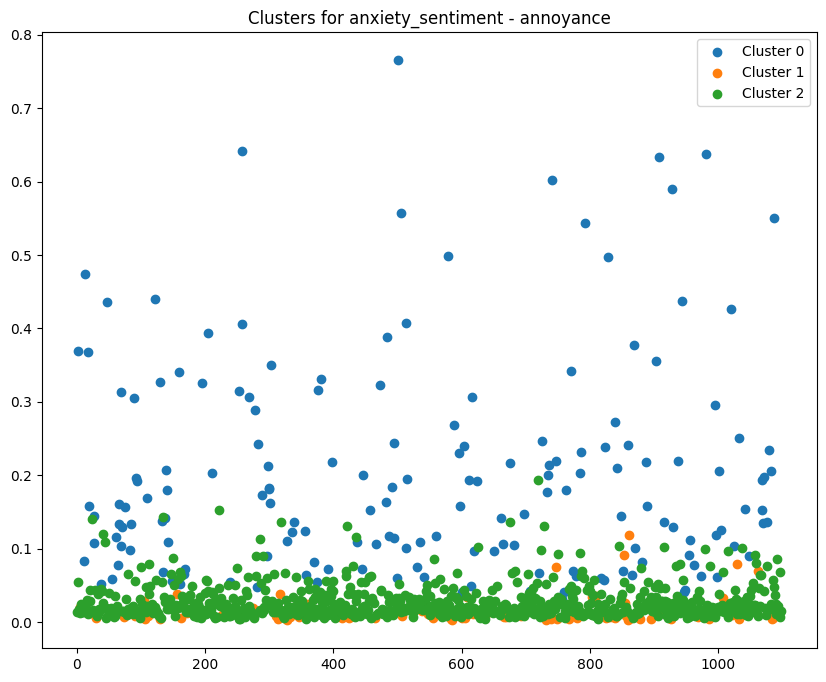

...

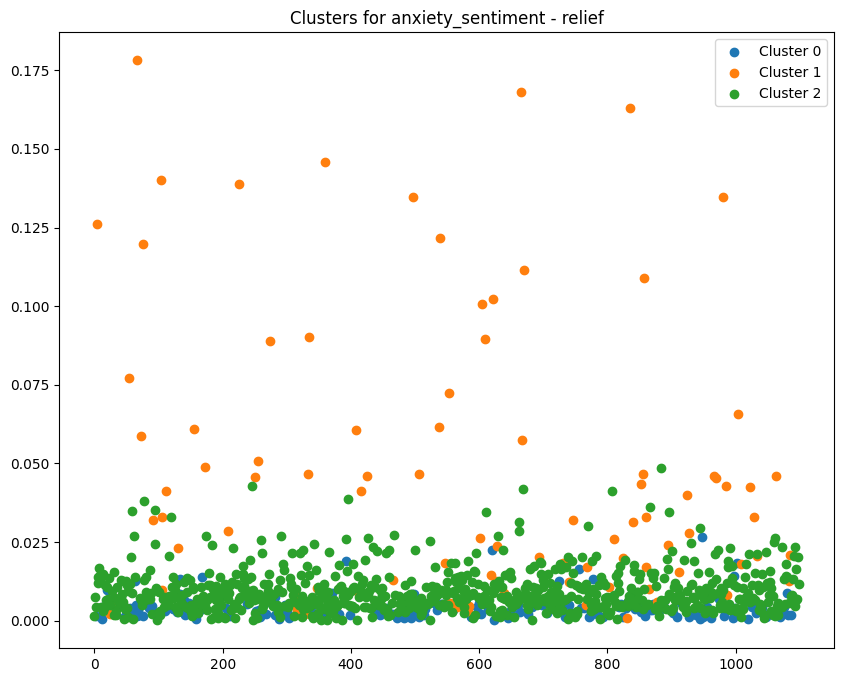

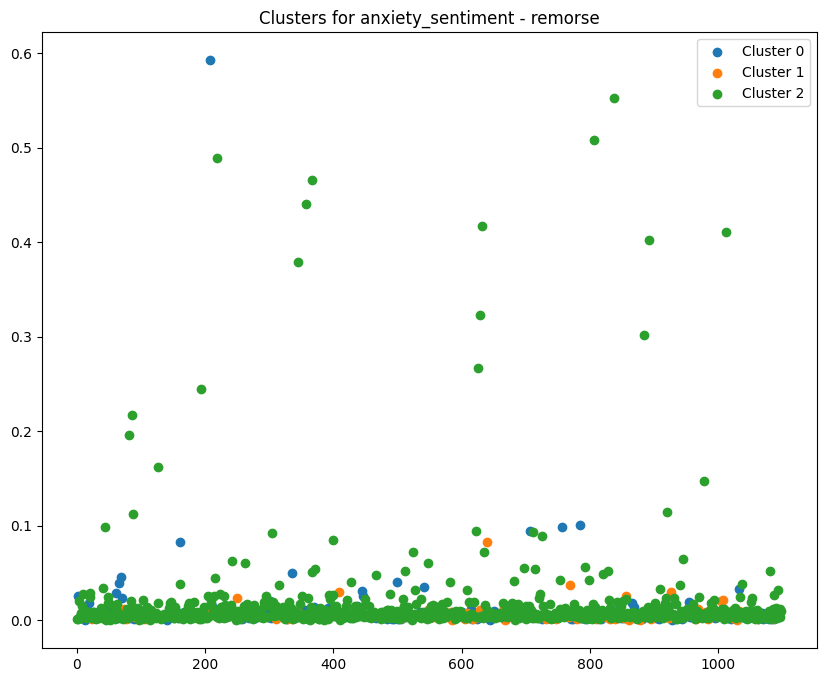

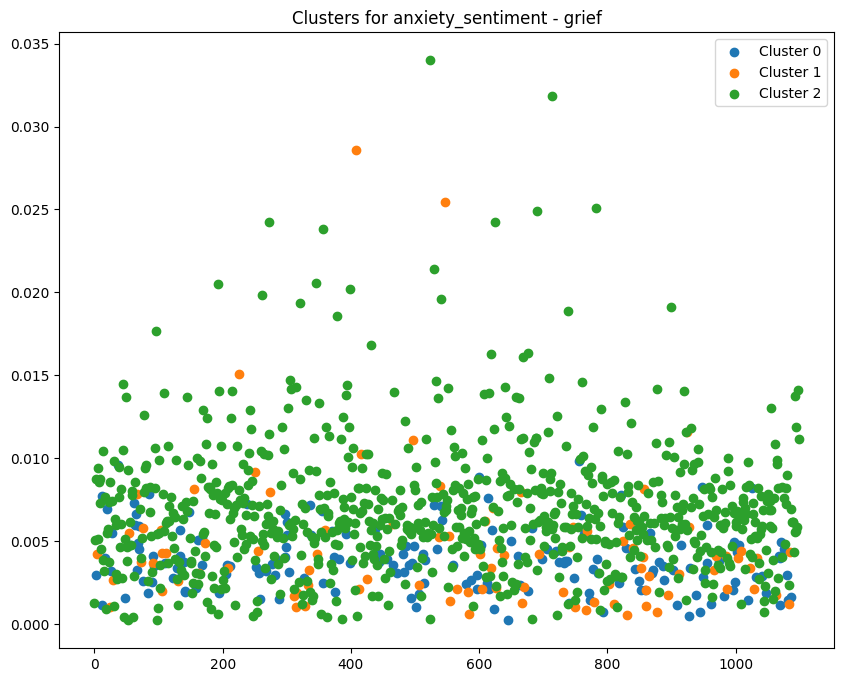

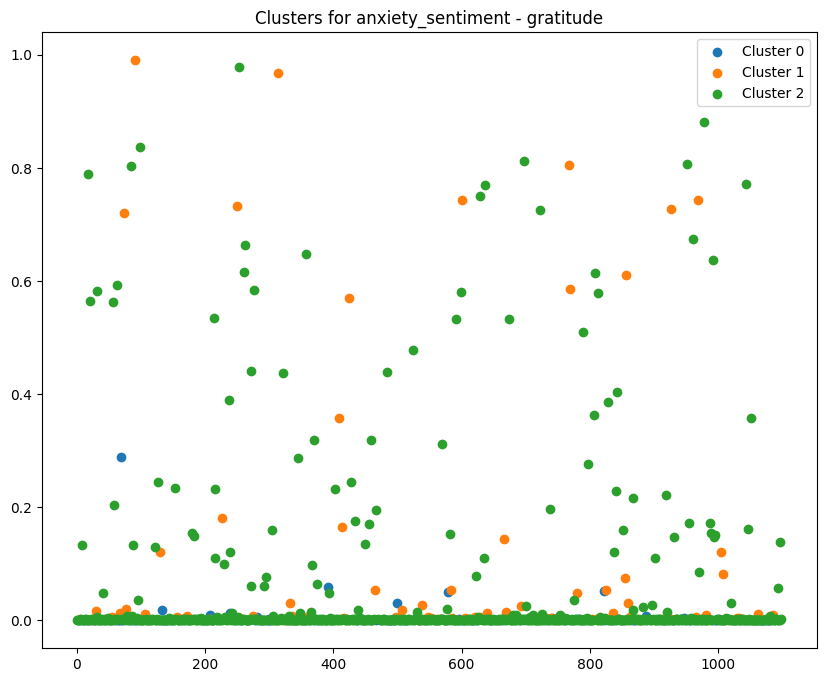

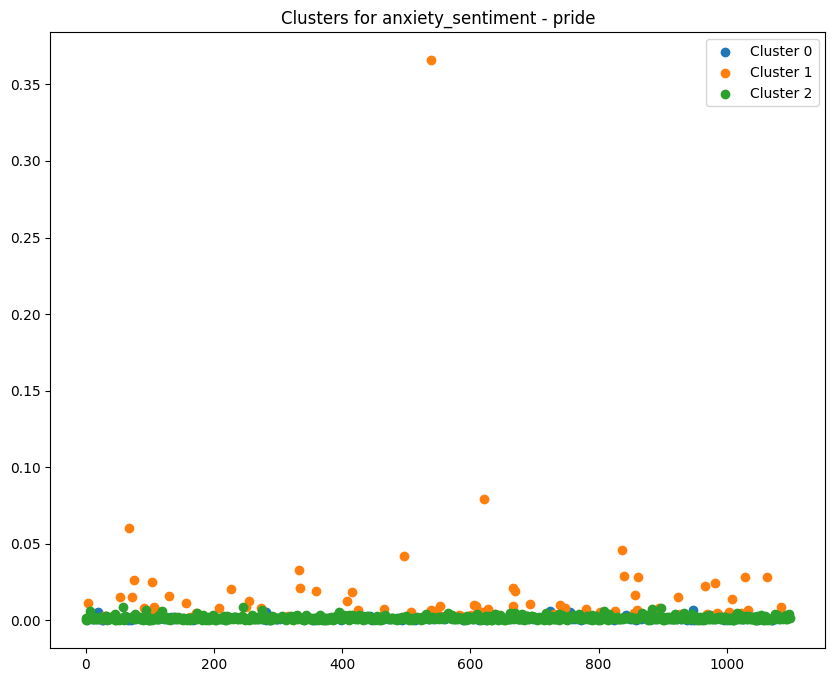

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


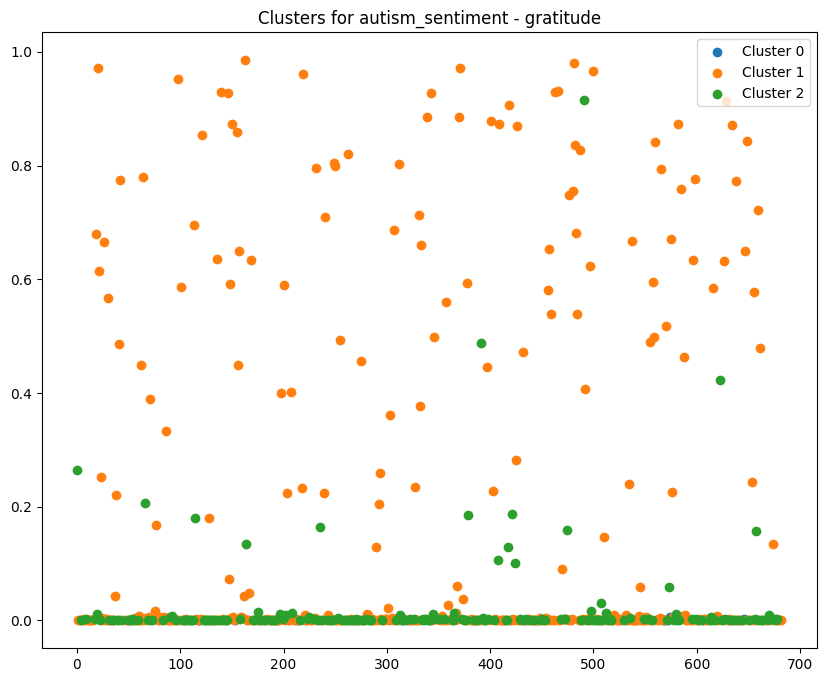

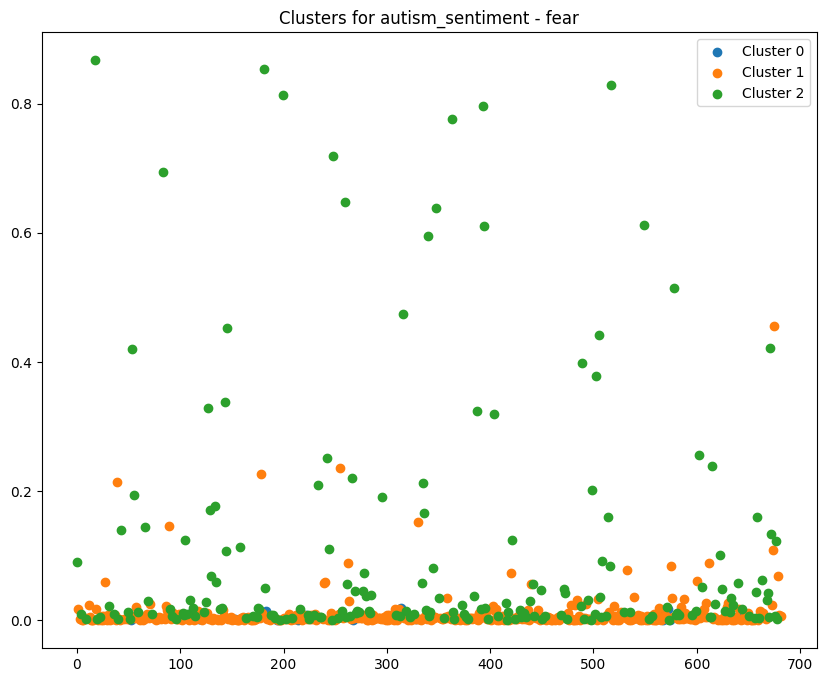

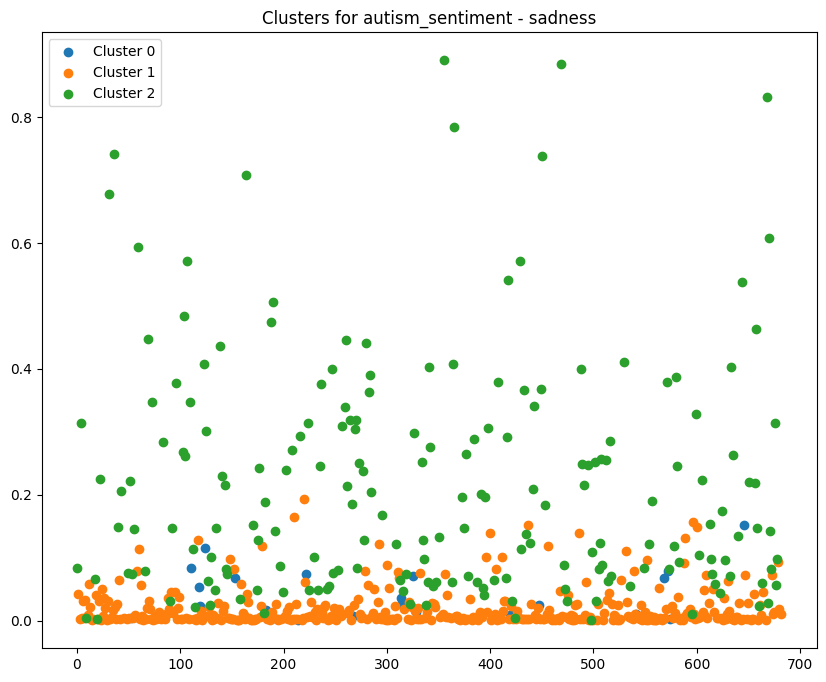

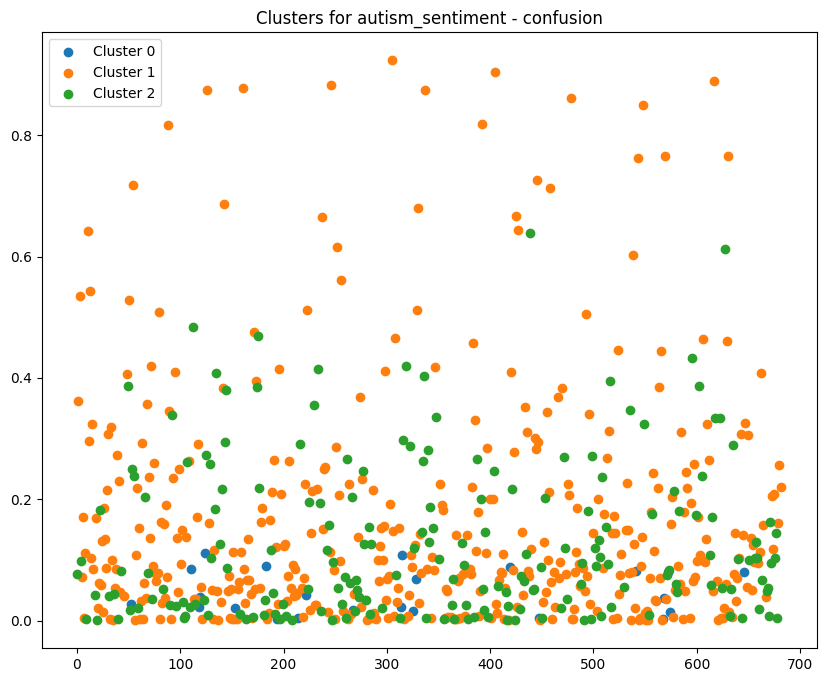

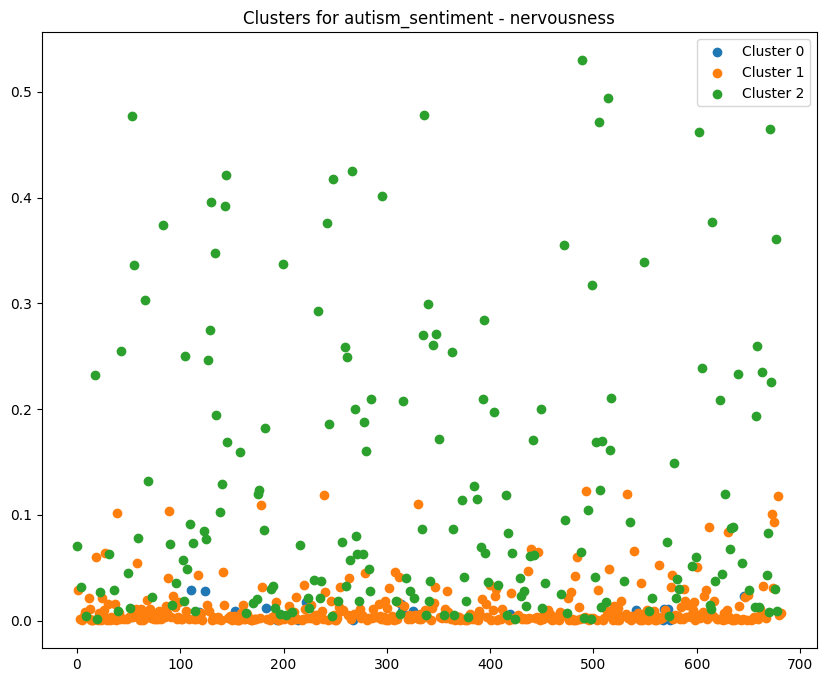

...

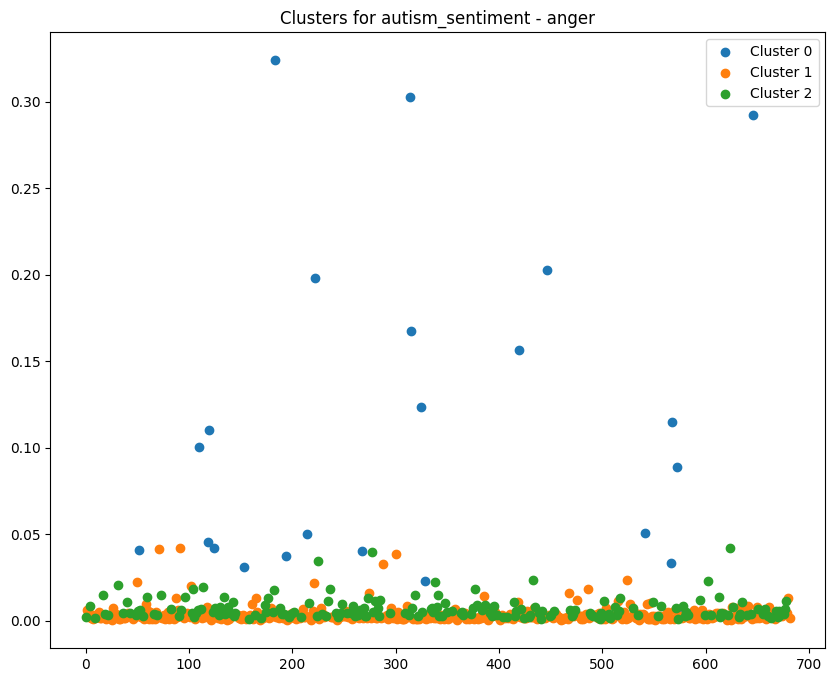

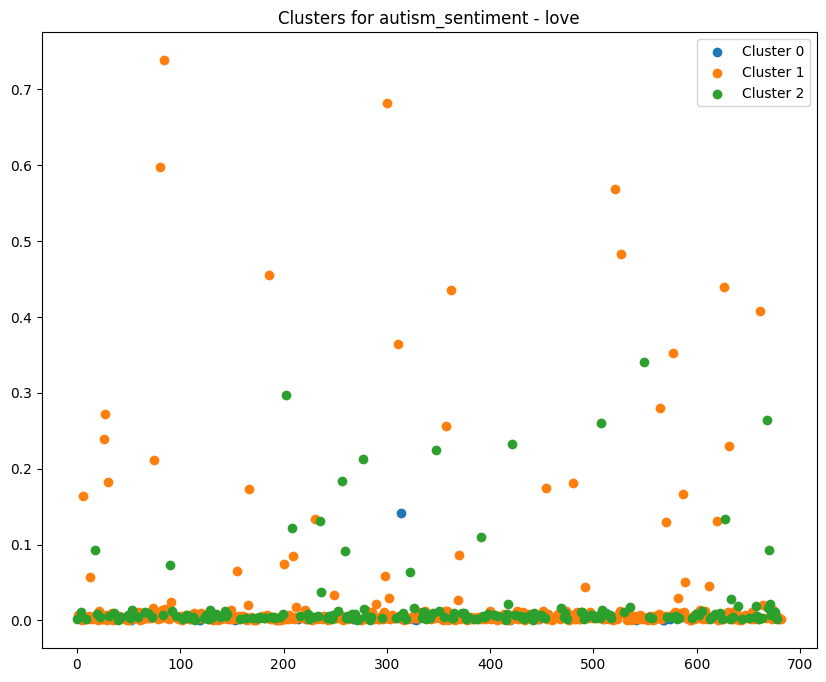

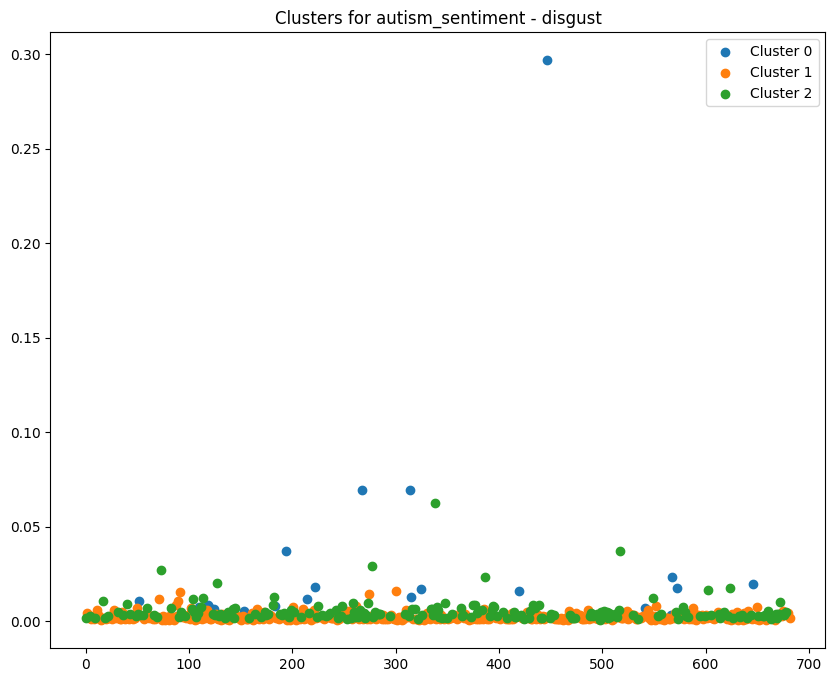

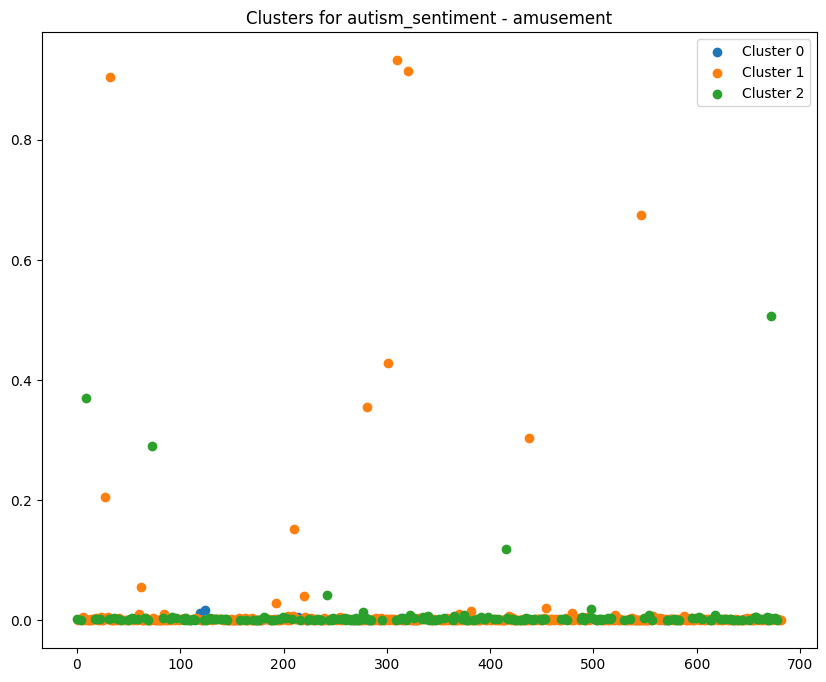

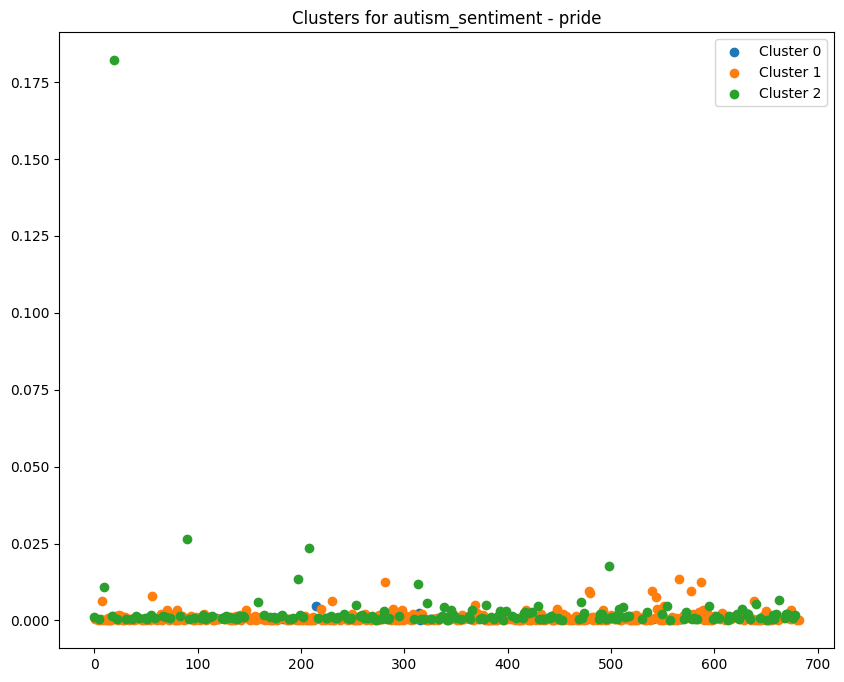

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


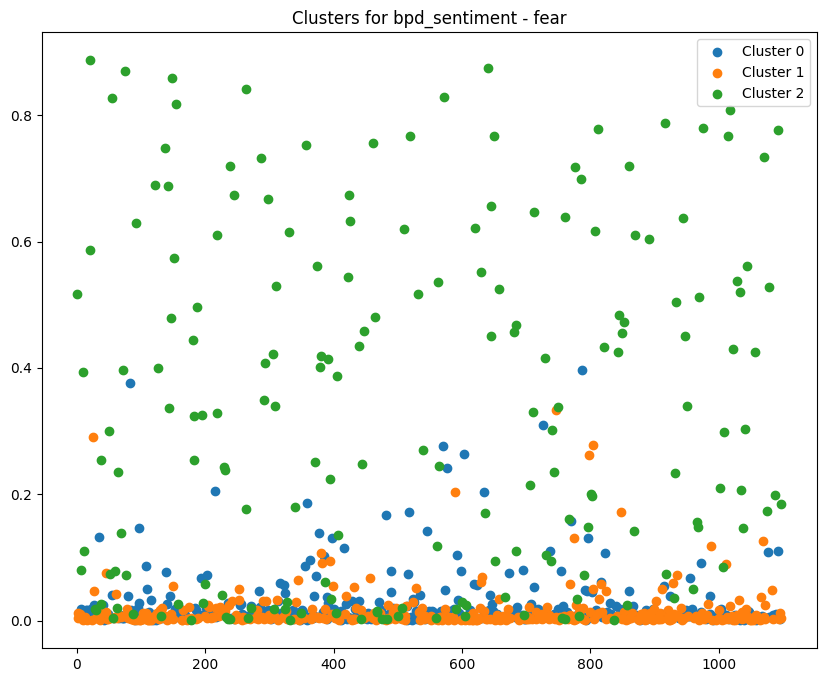

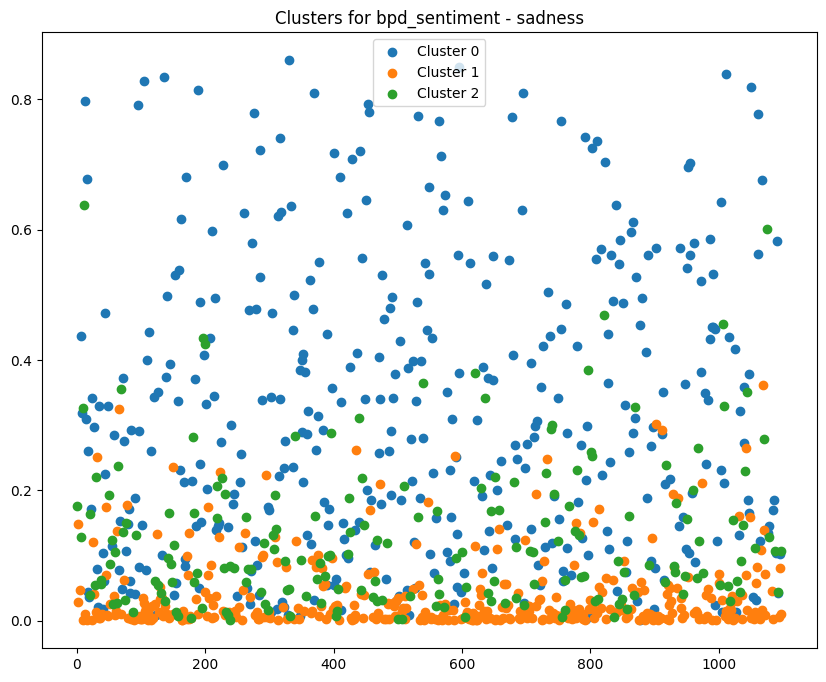

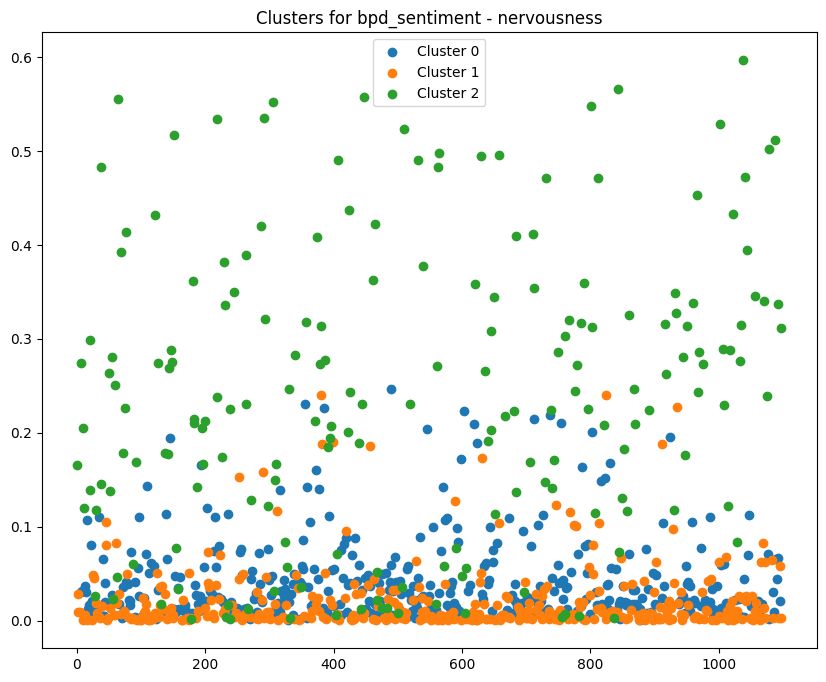

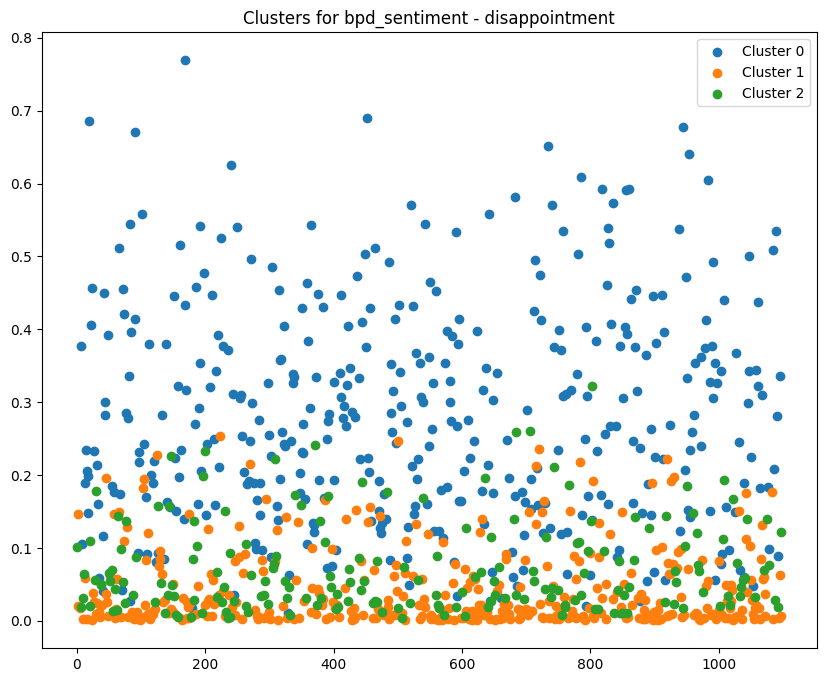

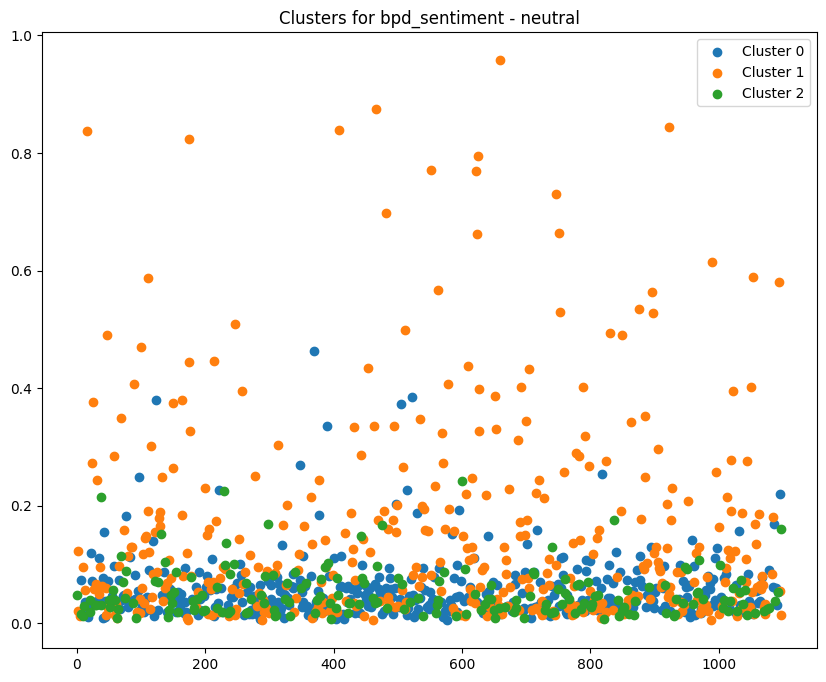

...

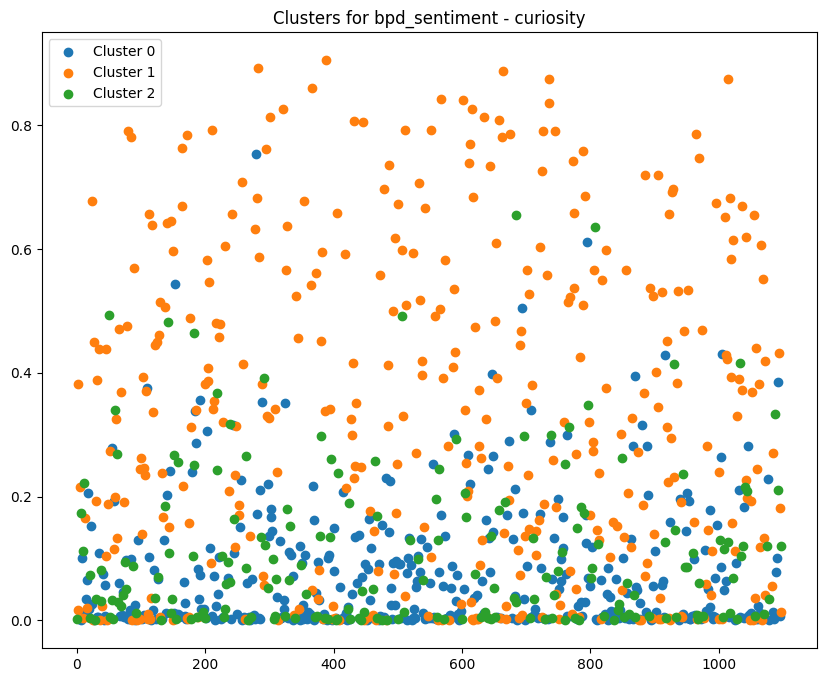

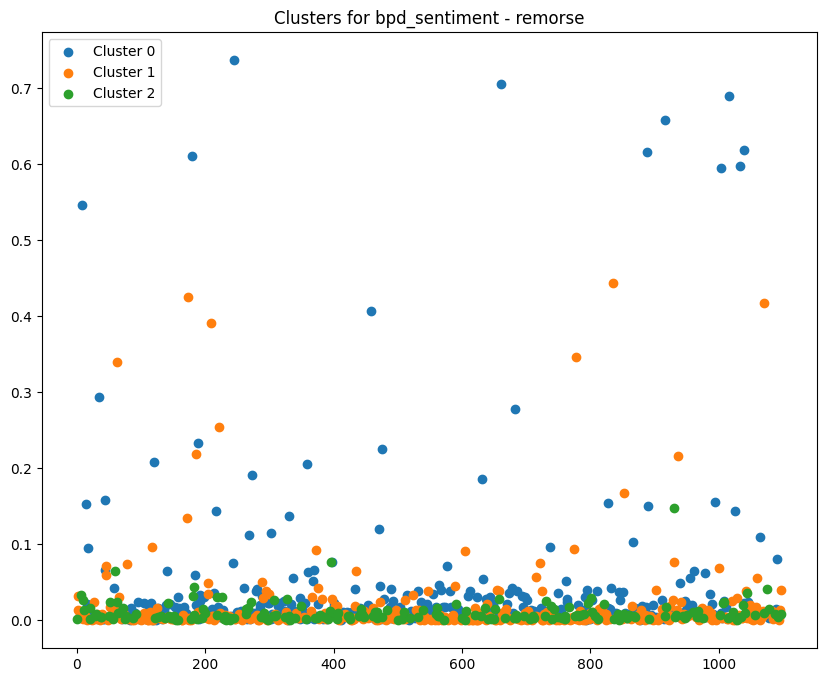

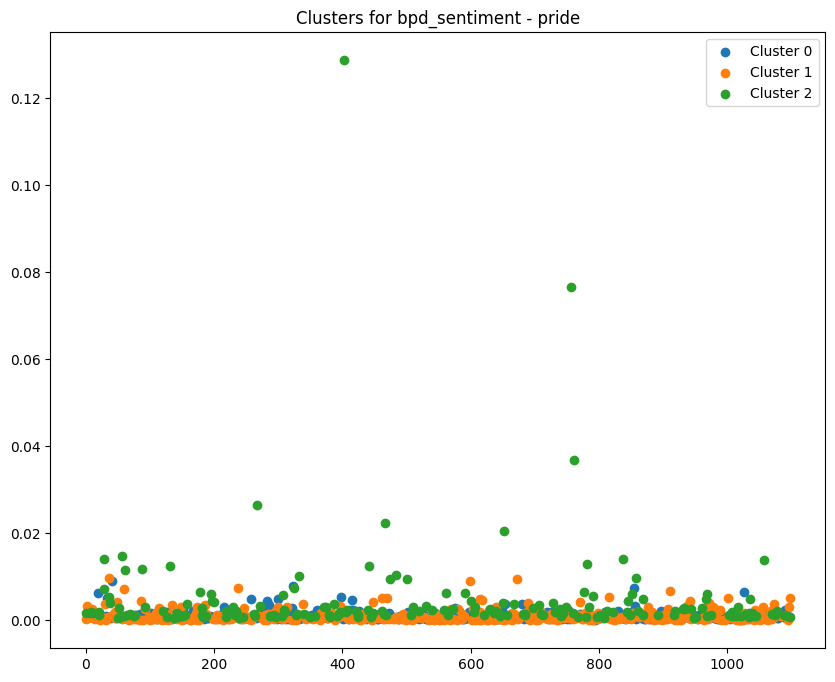

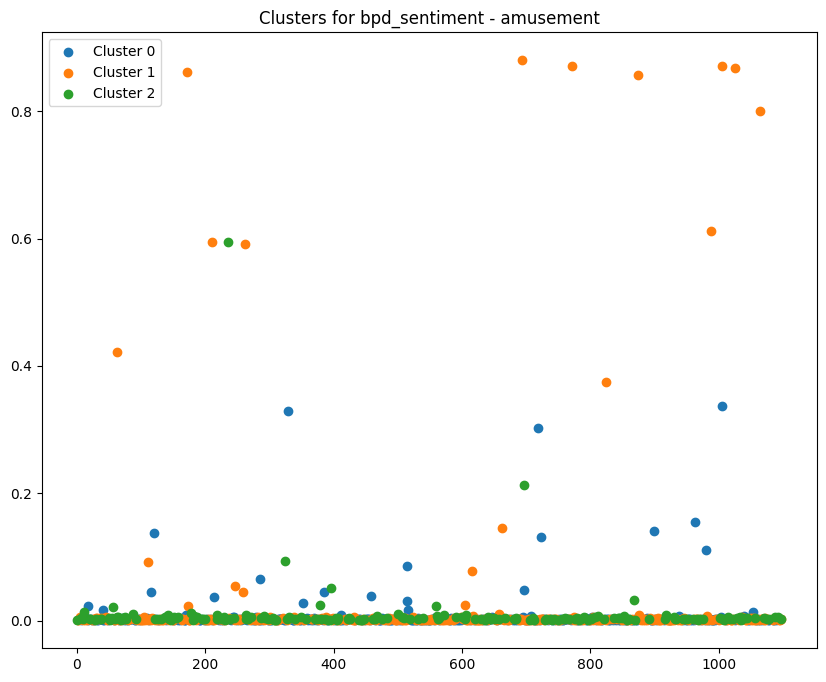

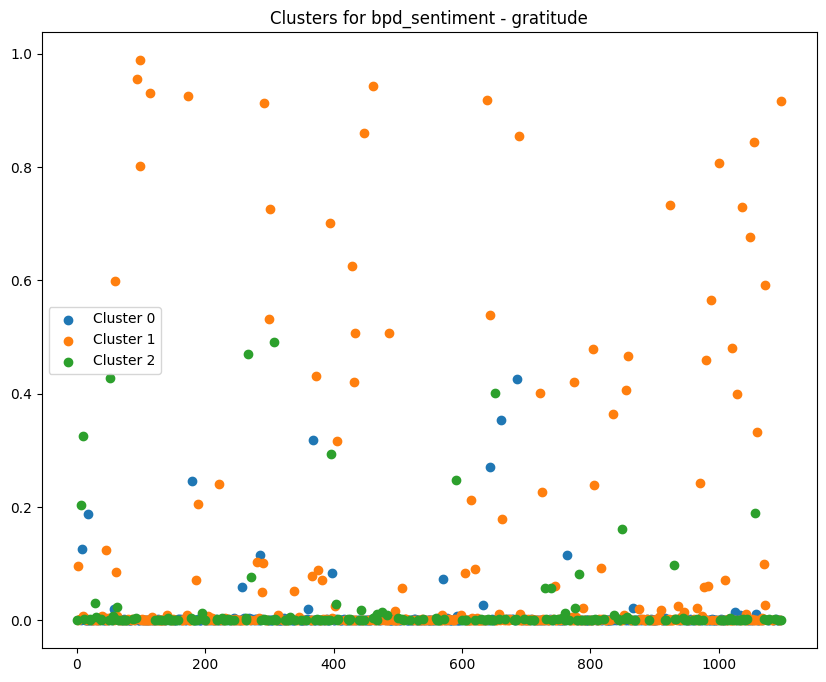

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


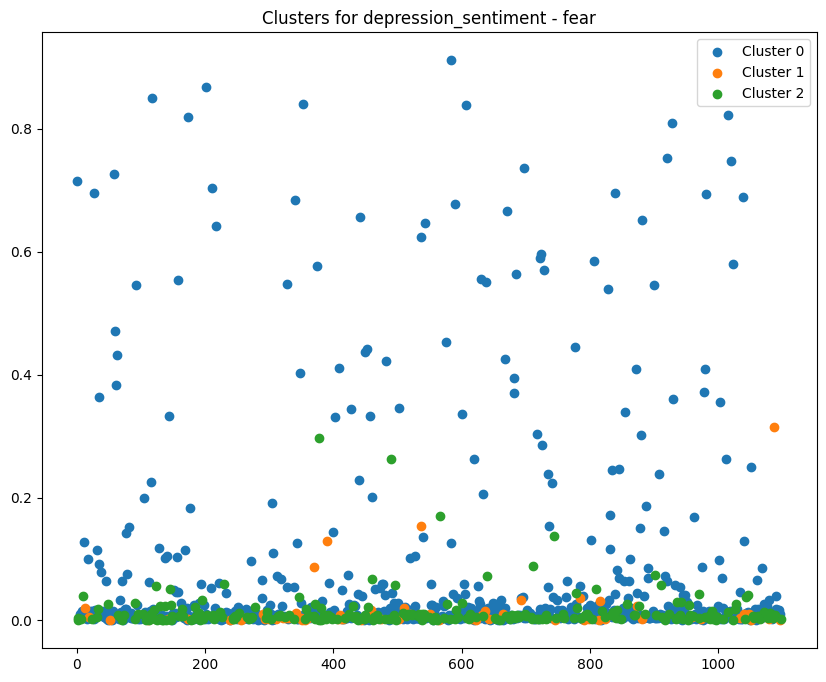

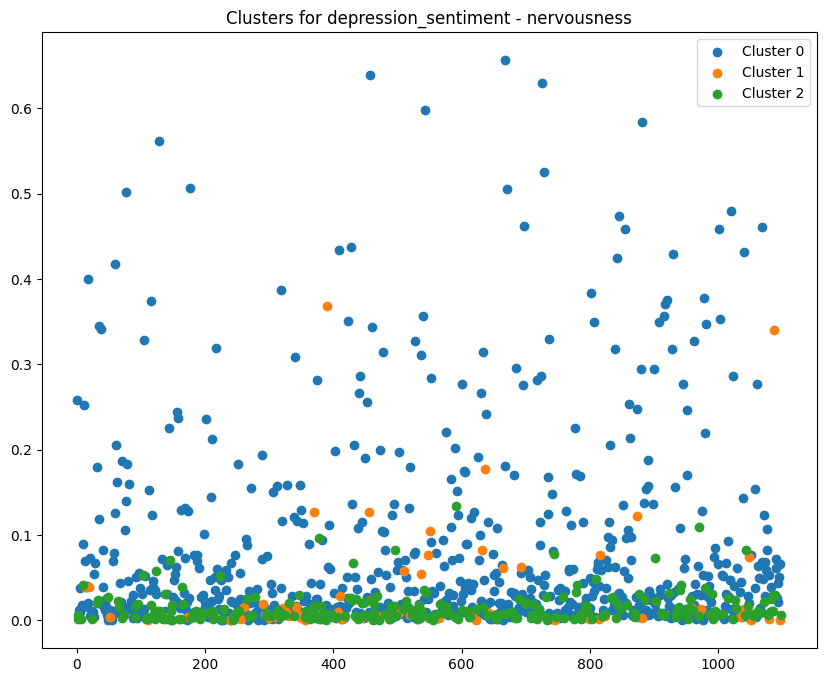

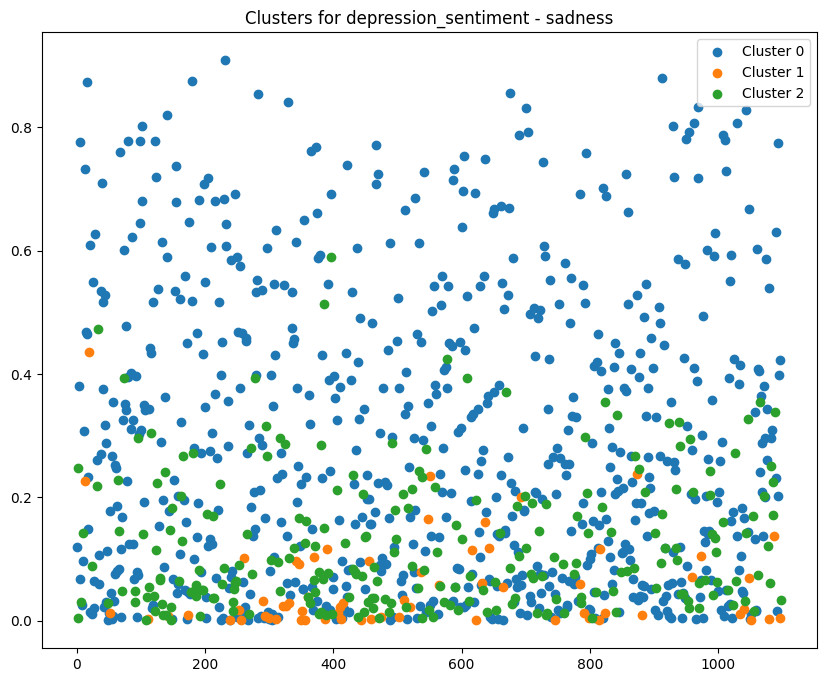

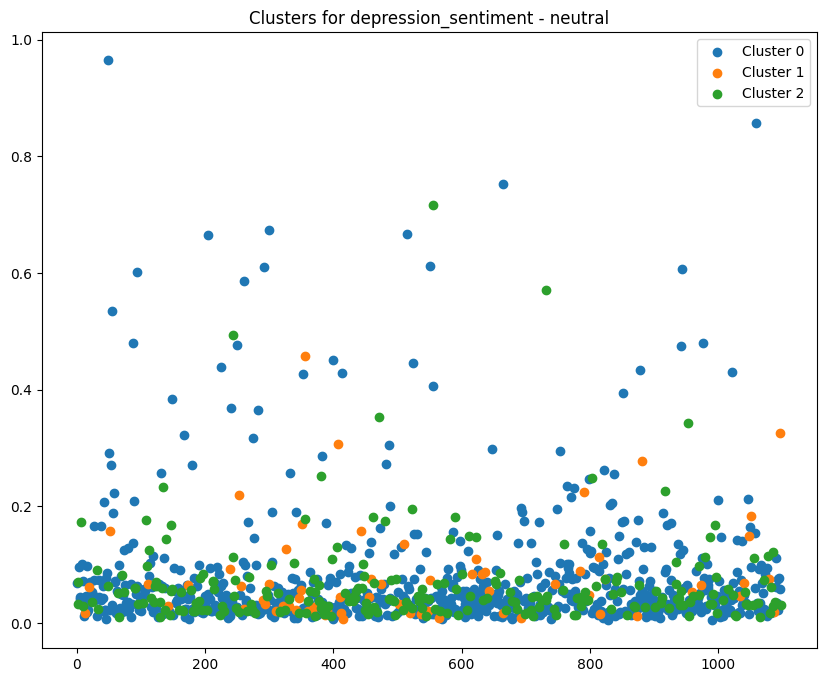

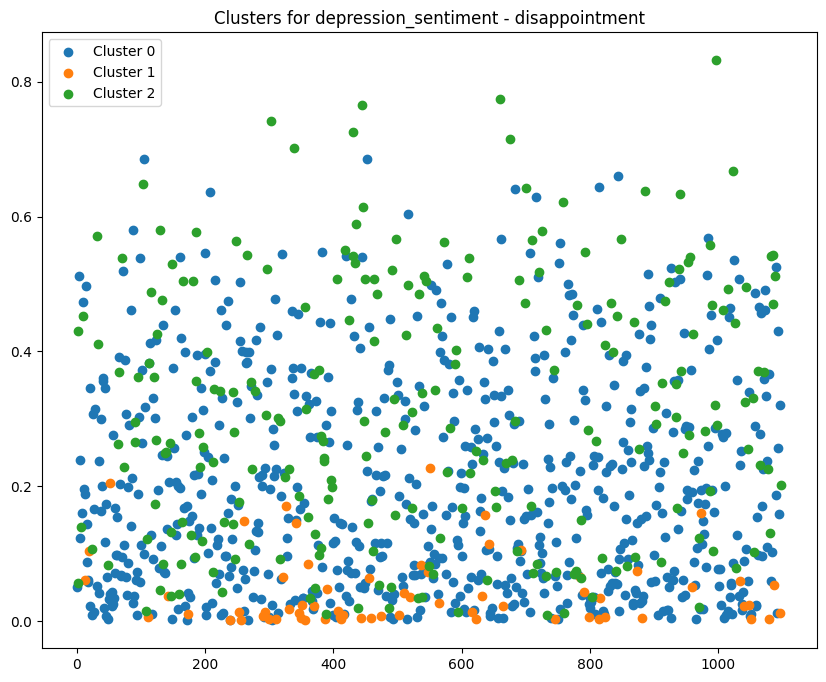

...

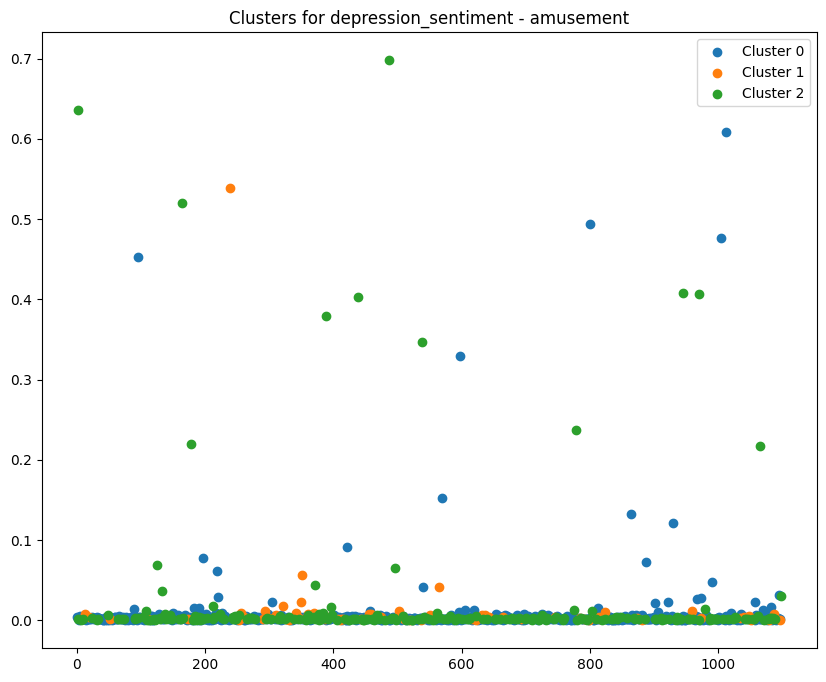

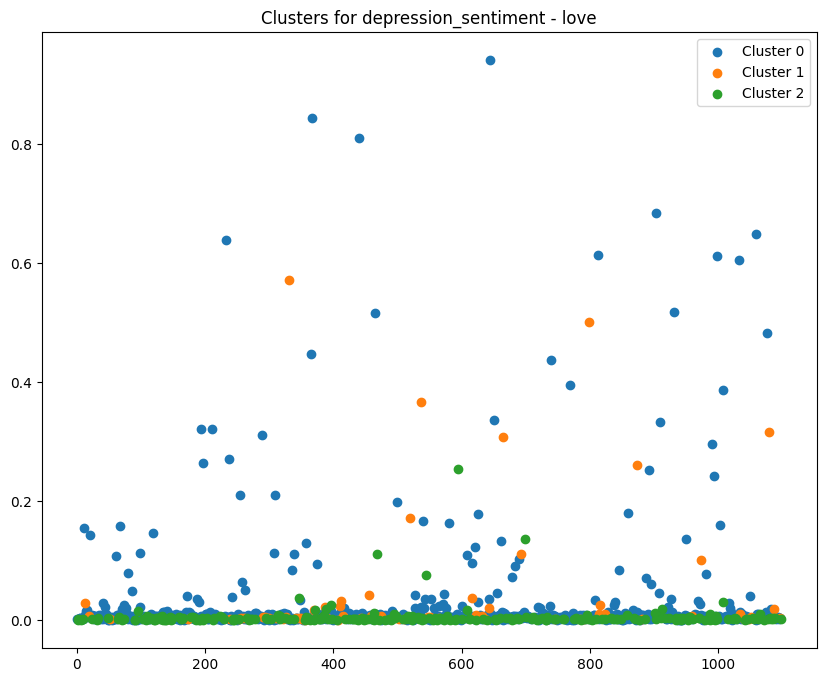

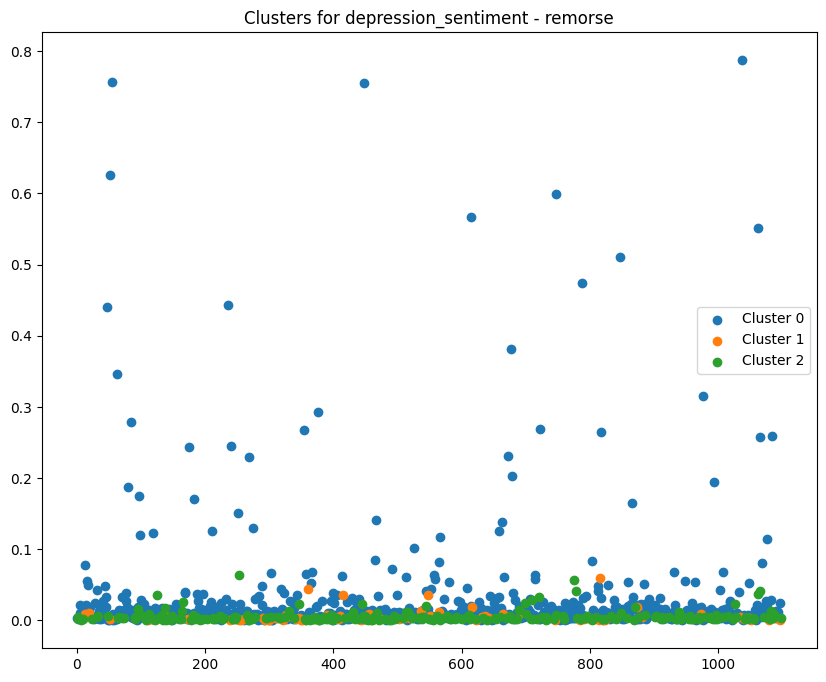

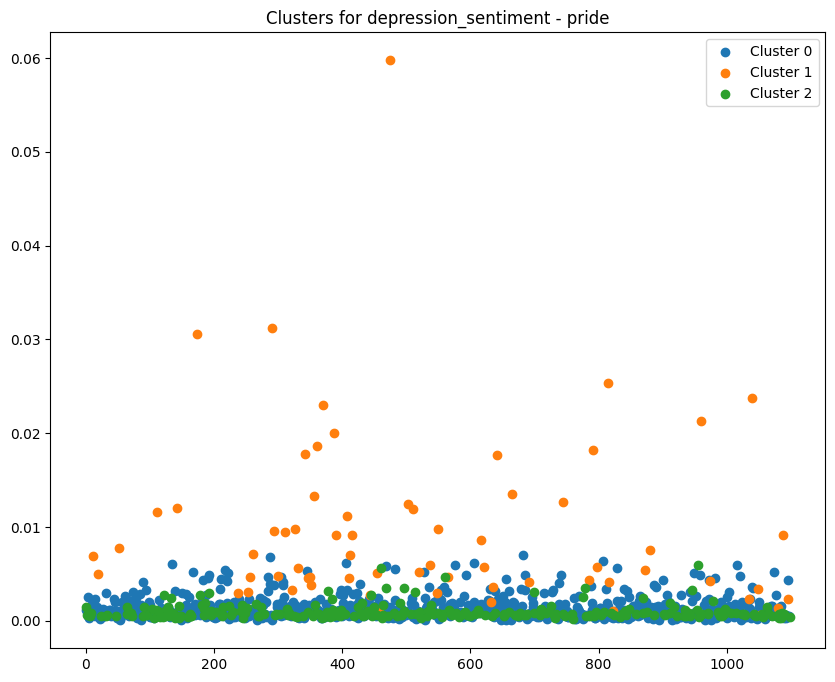

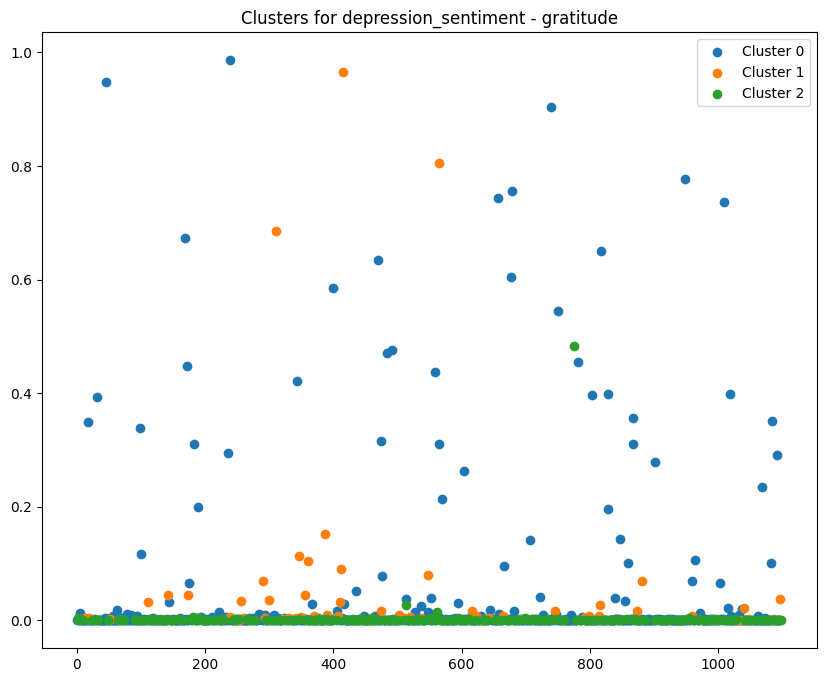

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


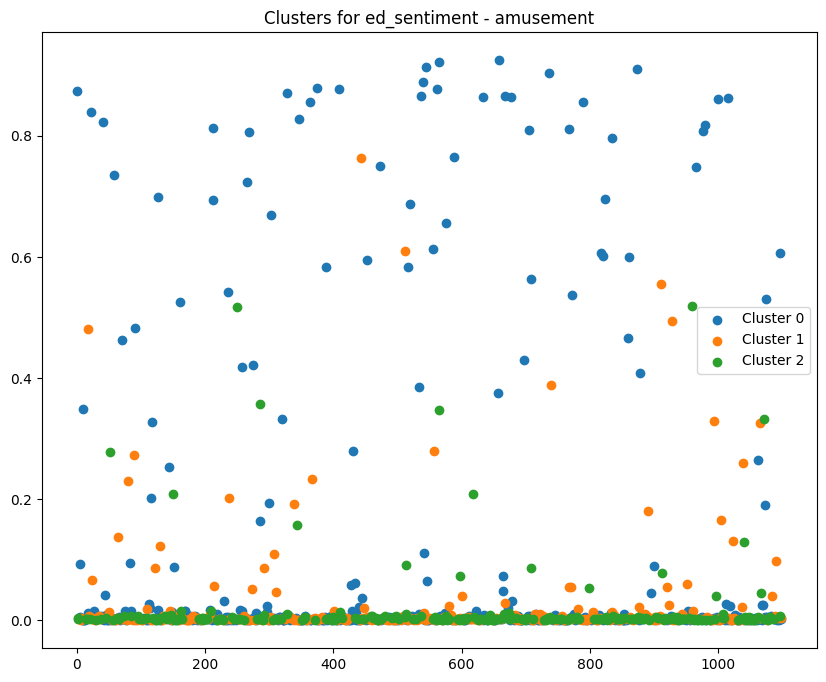

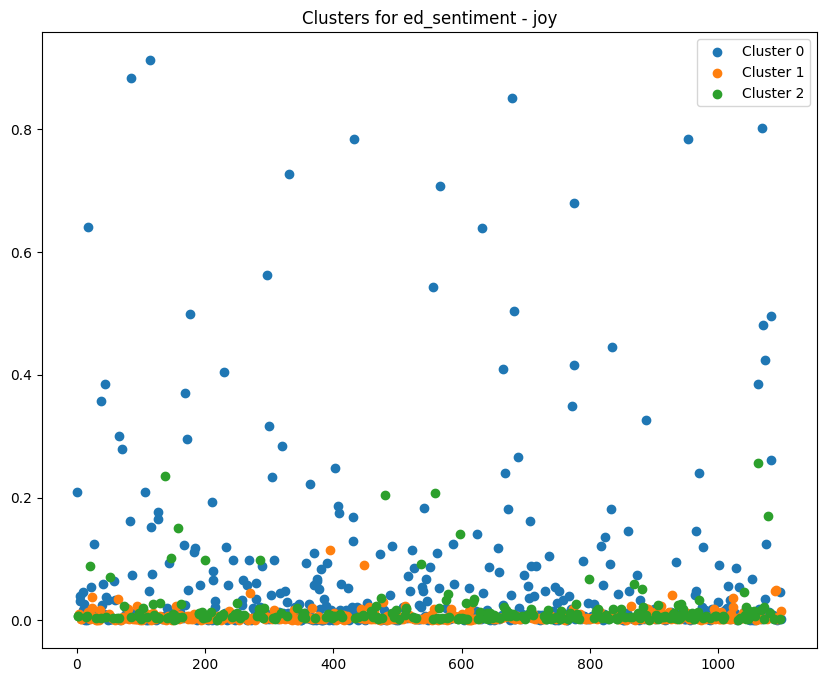

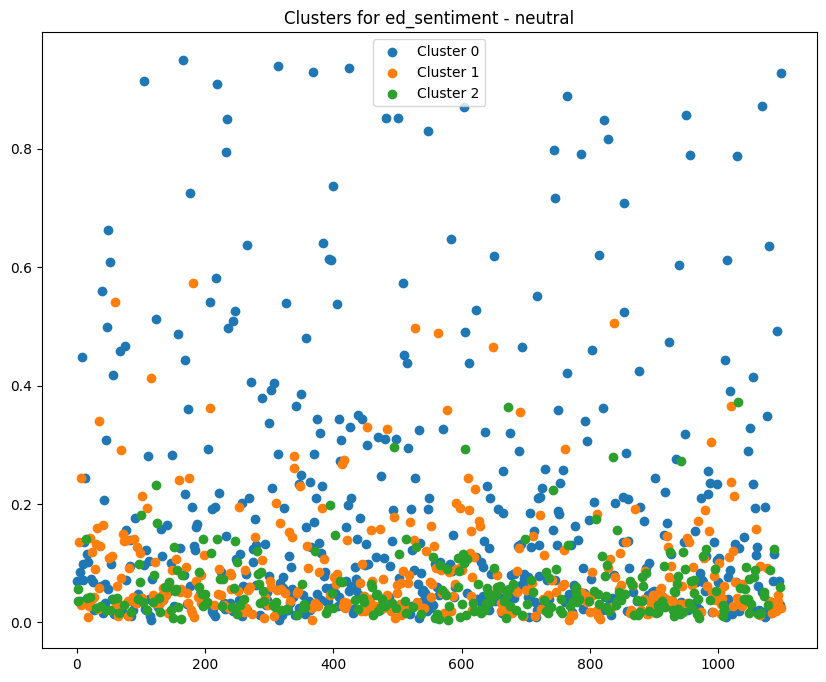

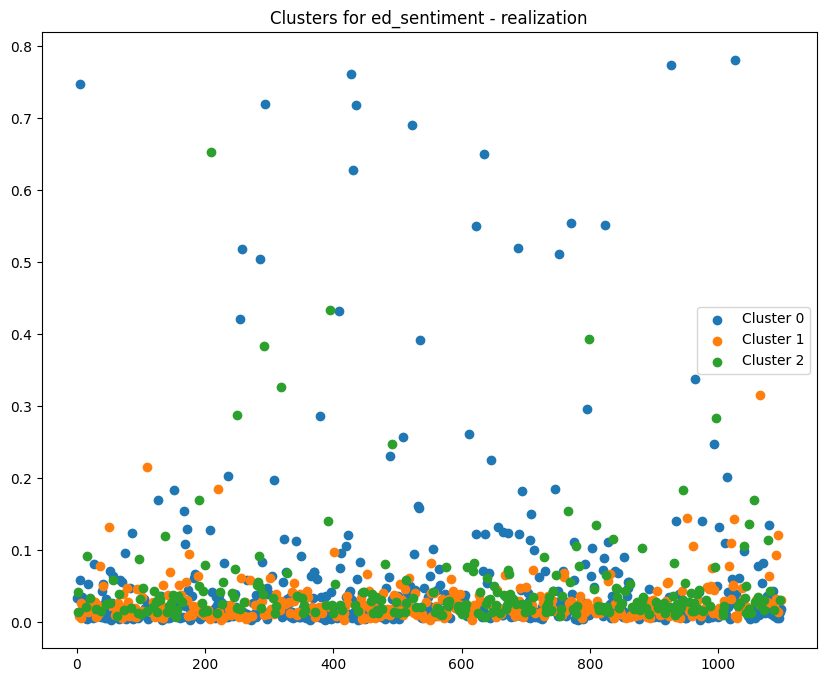

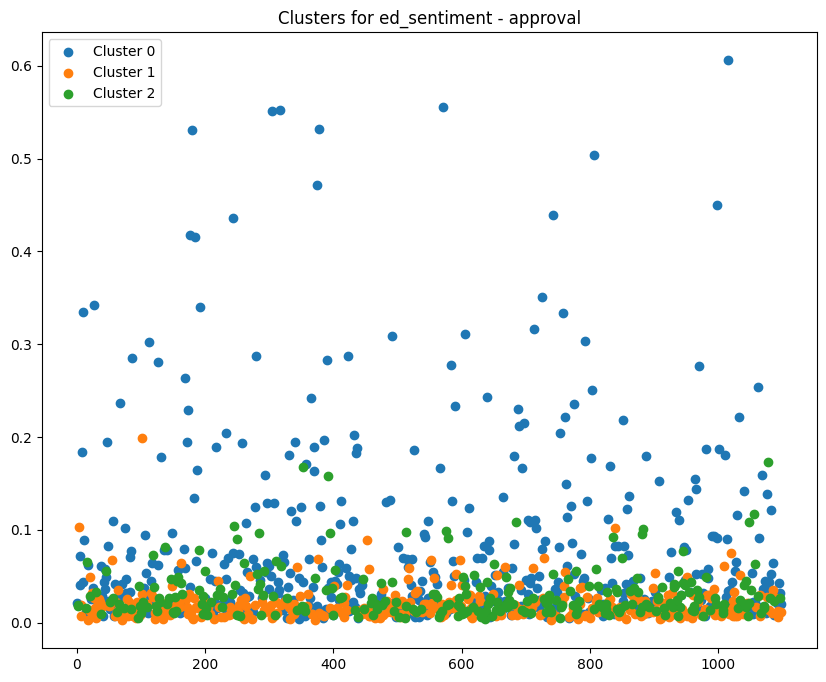

...

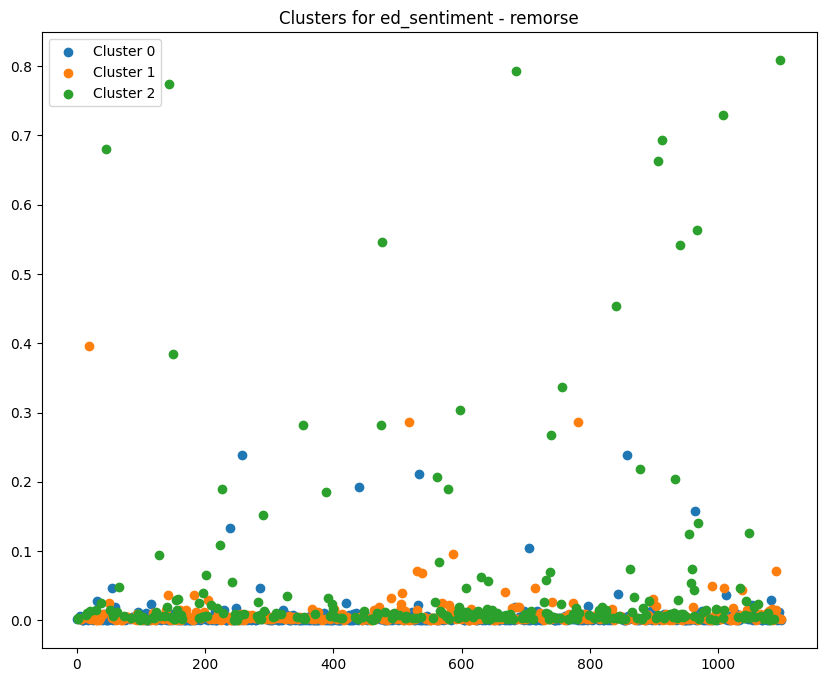

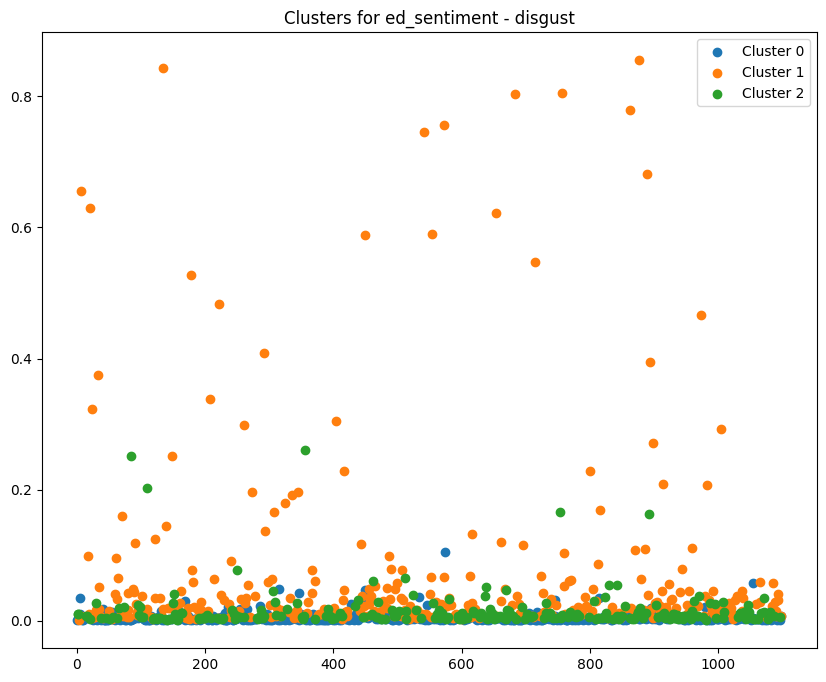

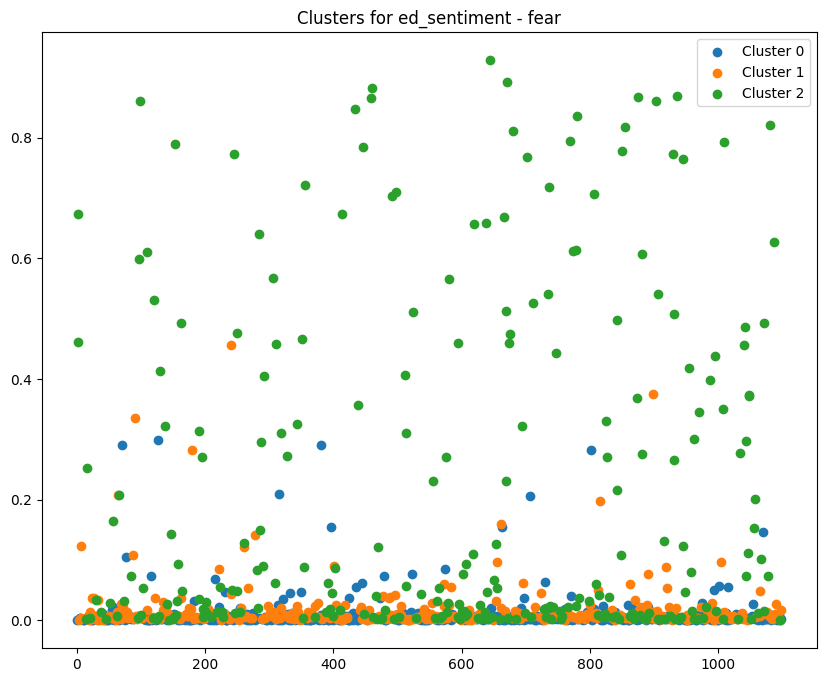

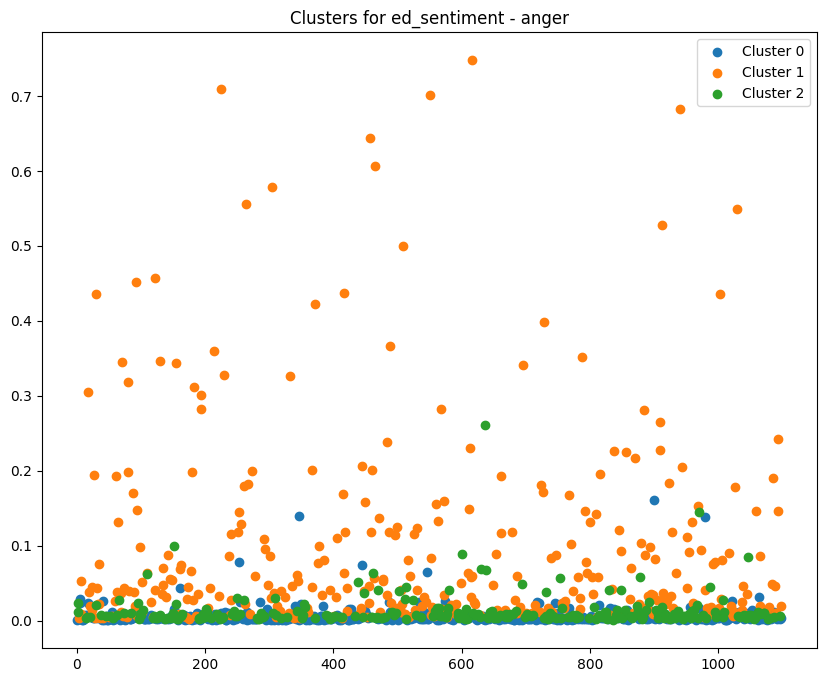

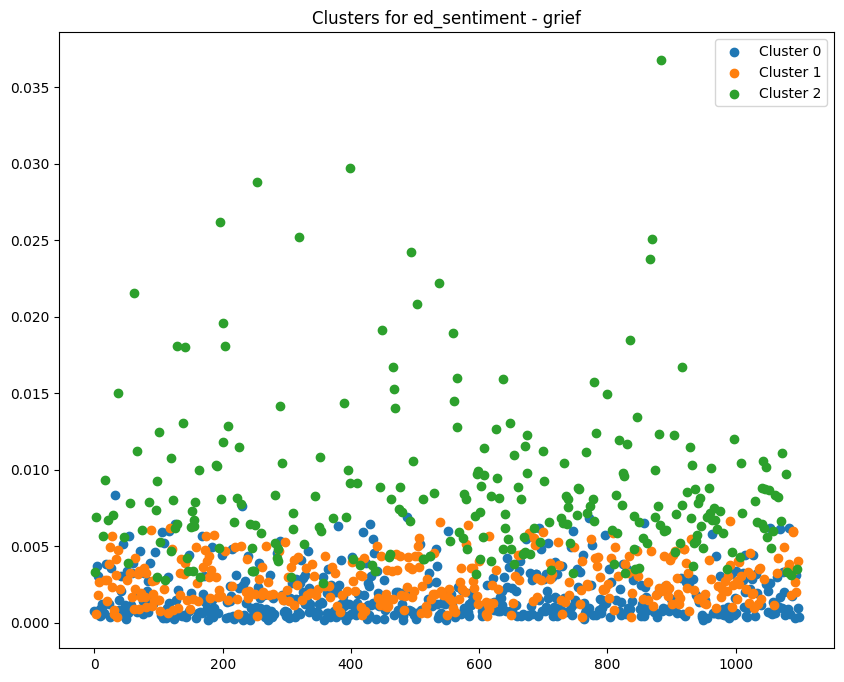

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


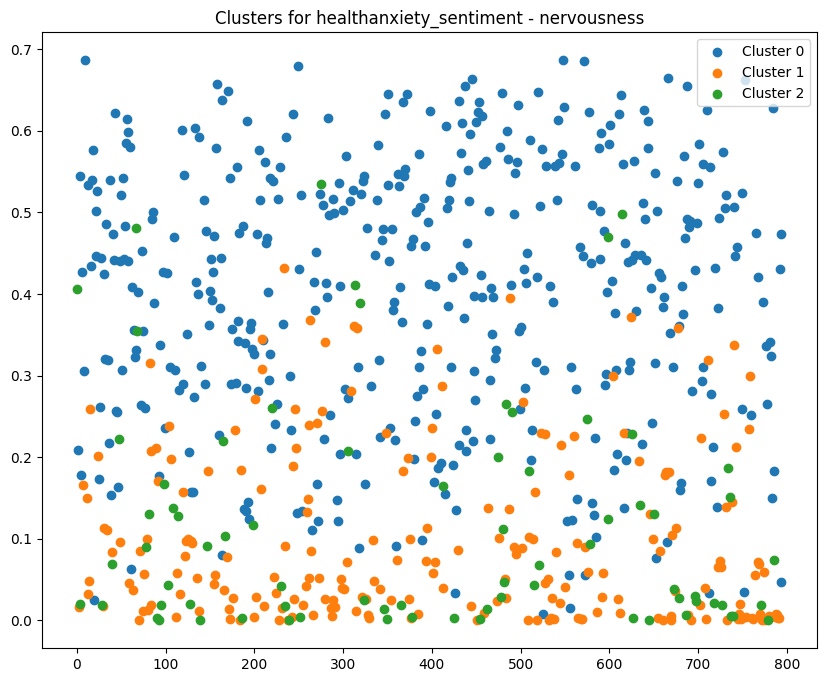

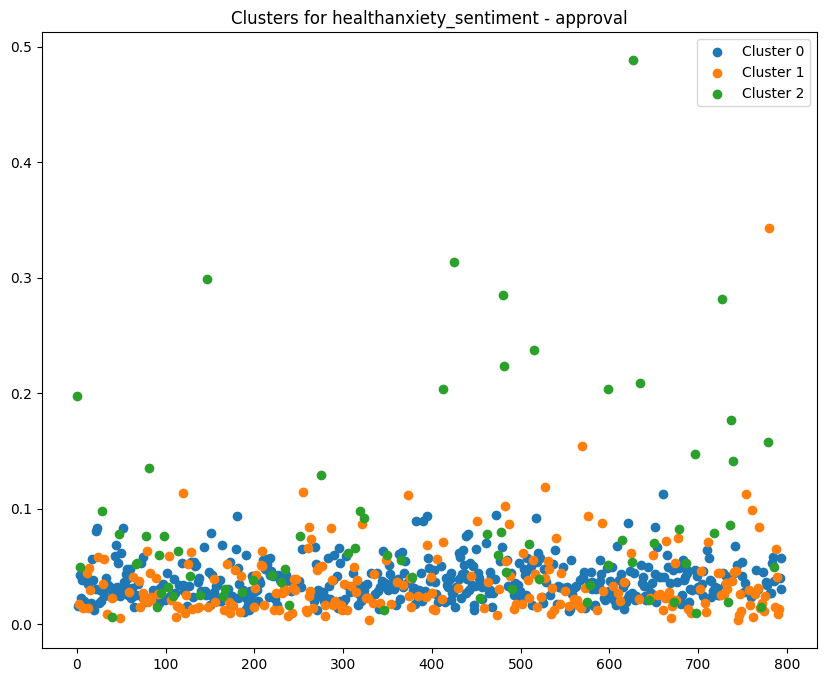

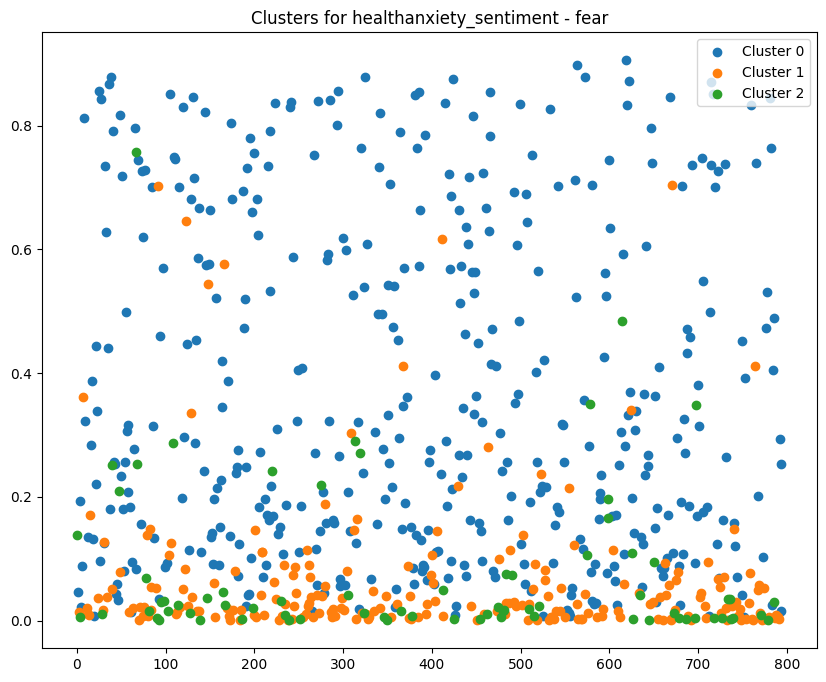

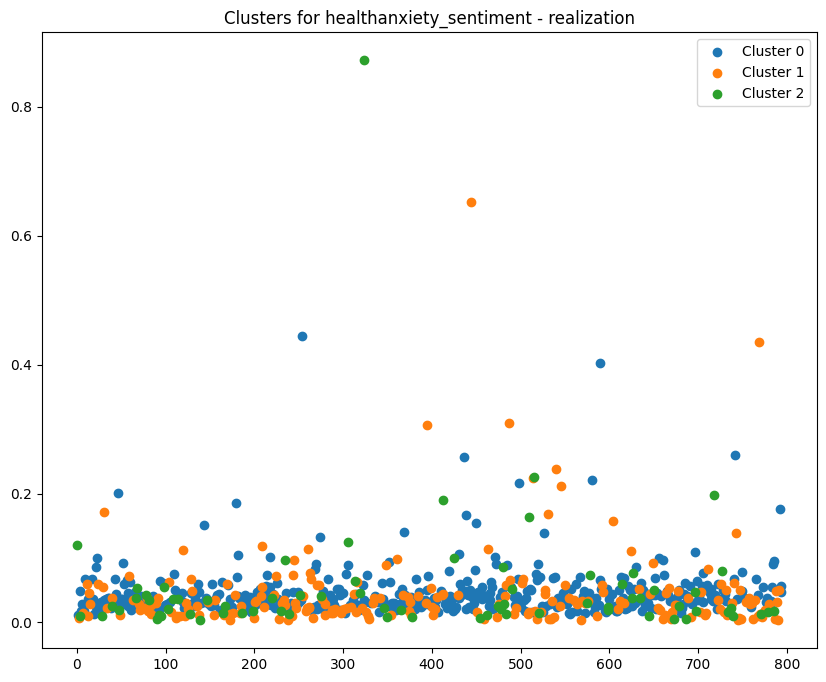

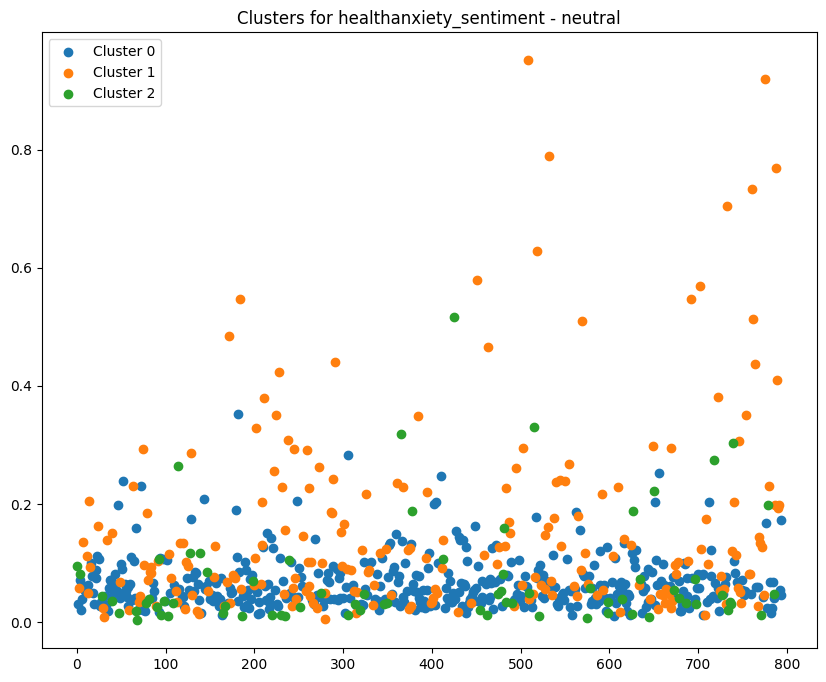

...

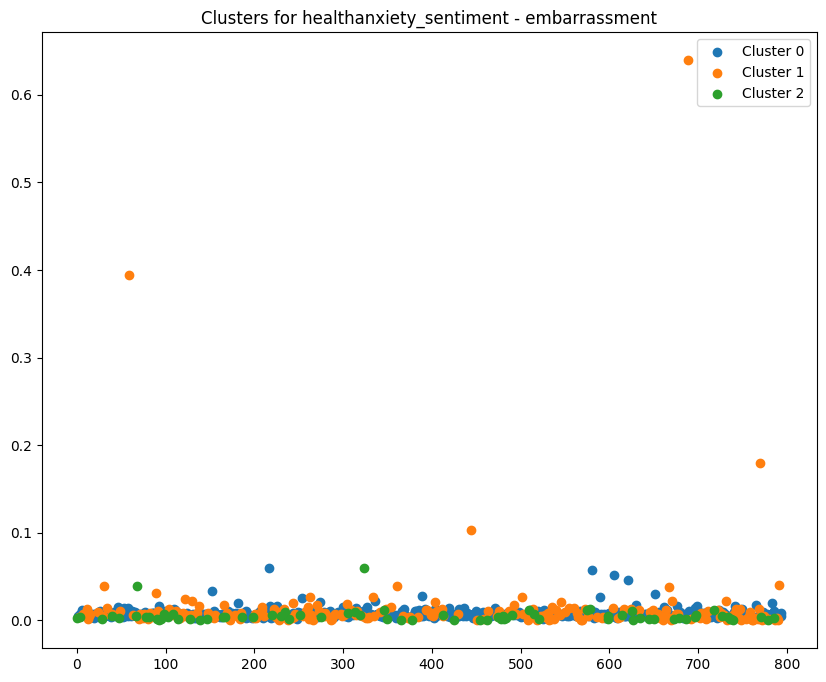

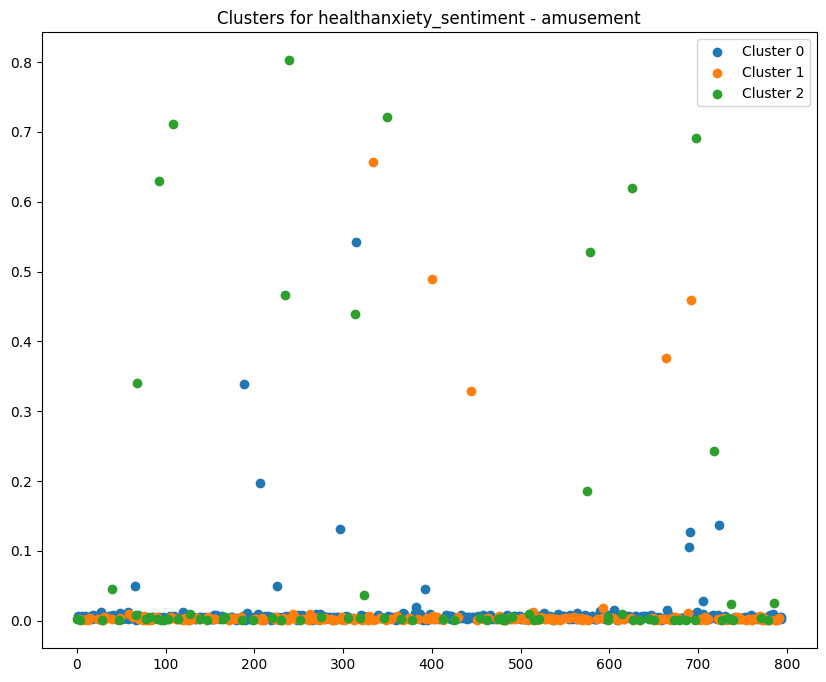

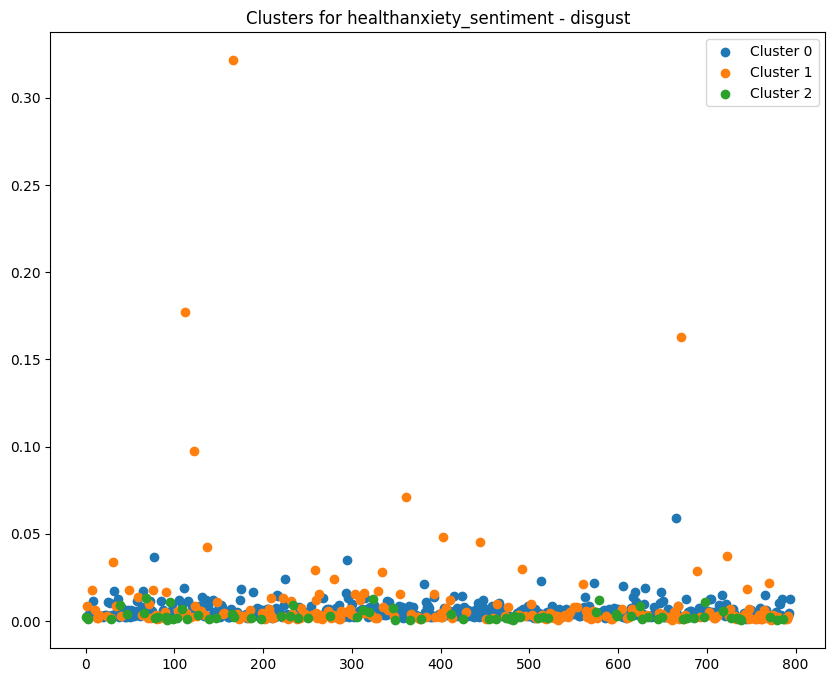

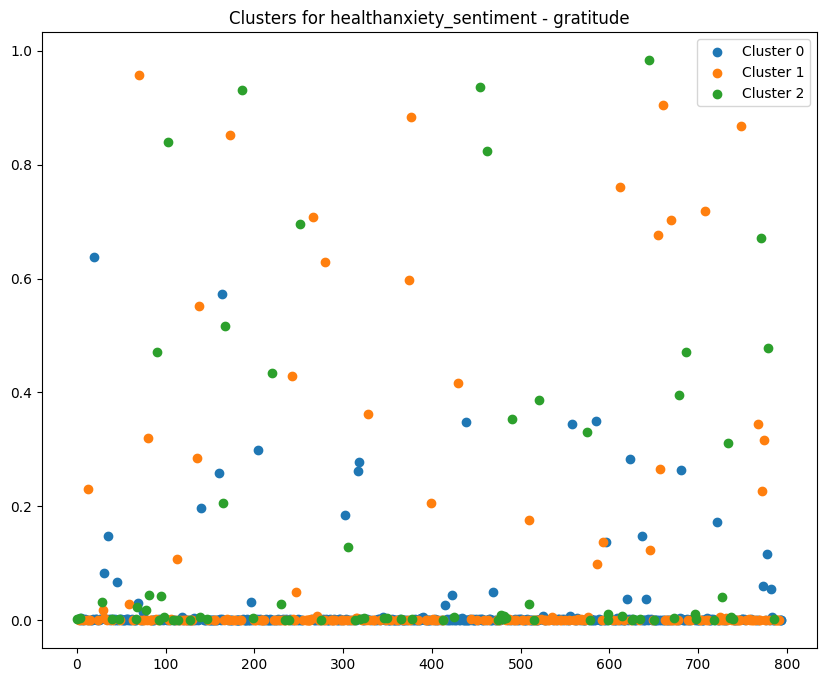

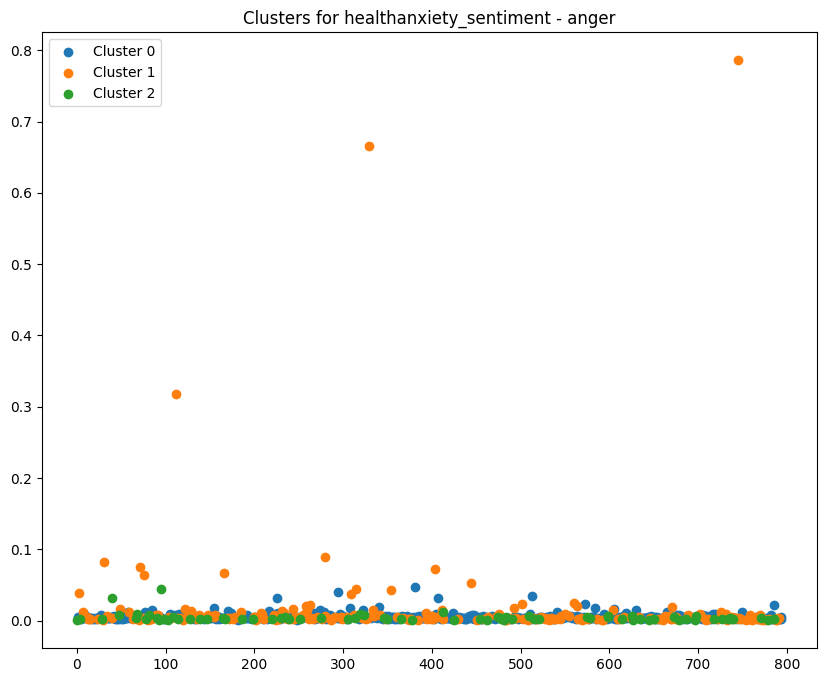

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


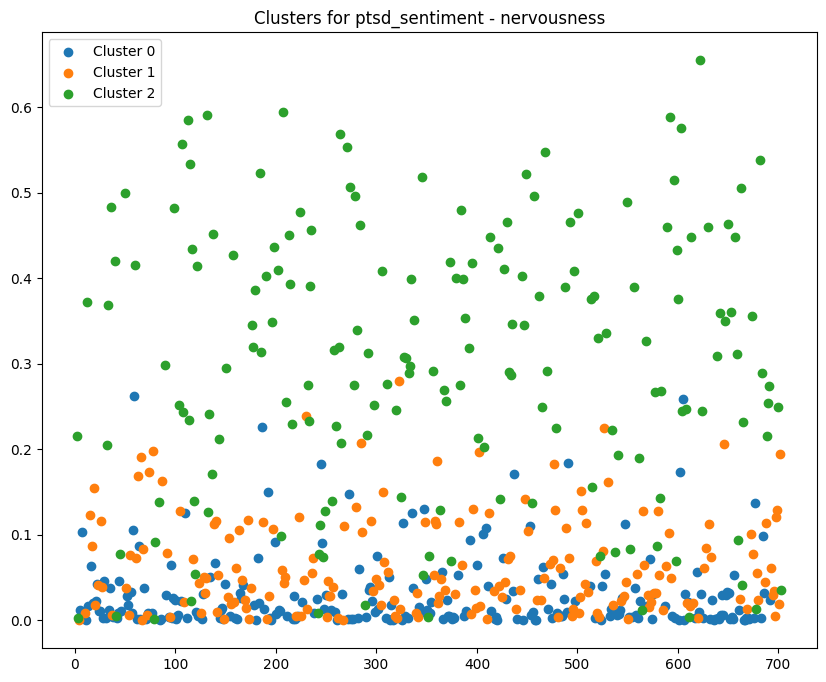

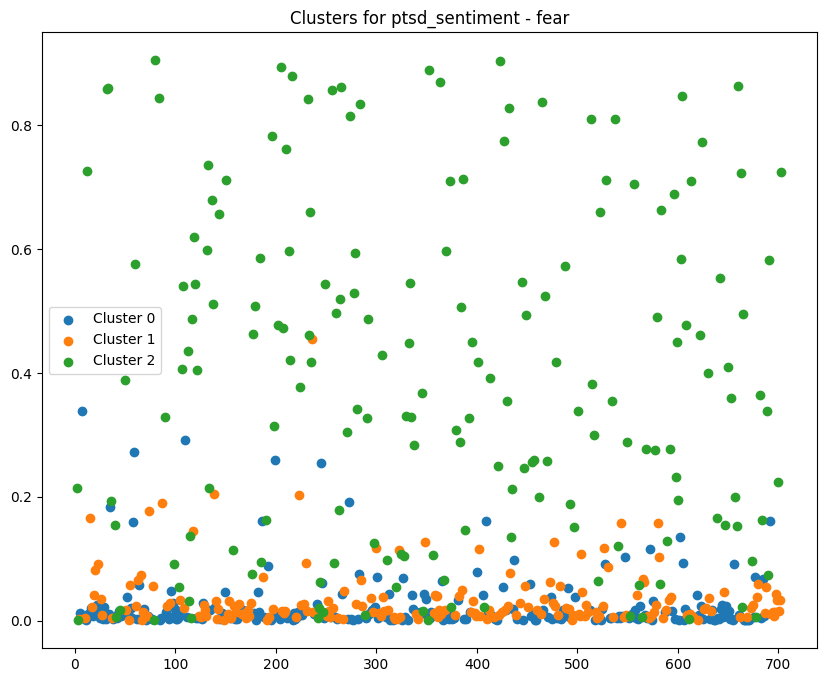

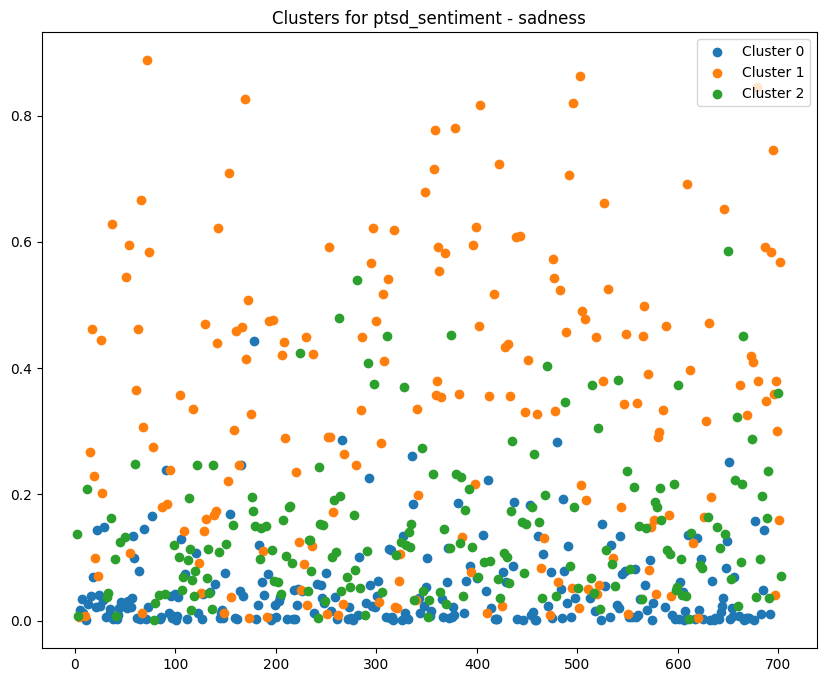

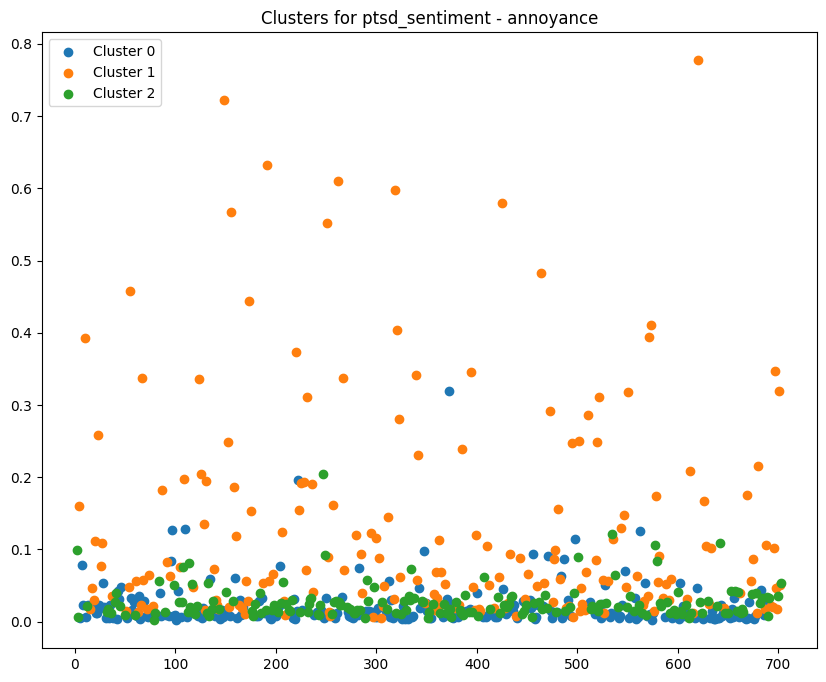

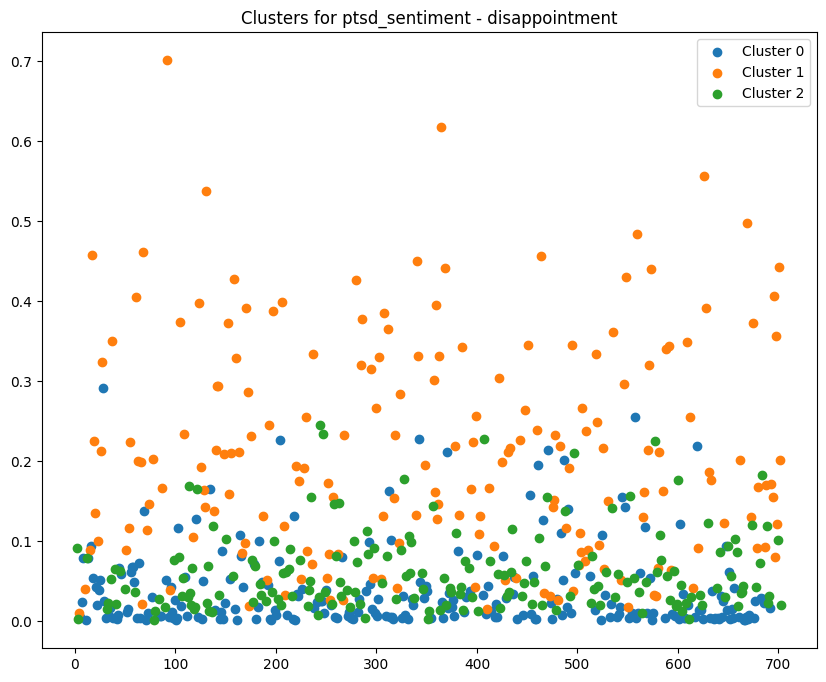

...

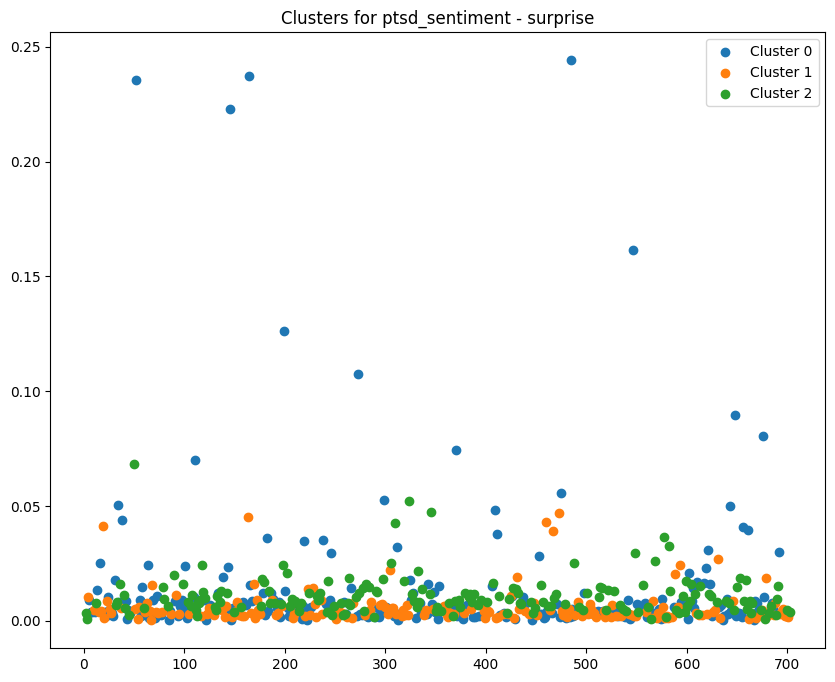

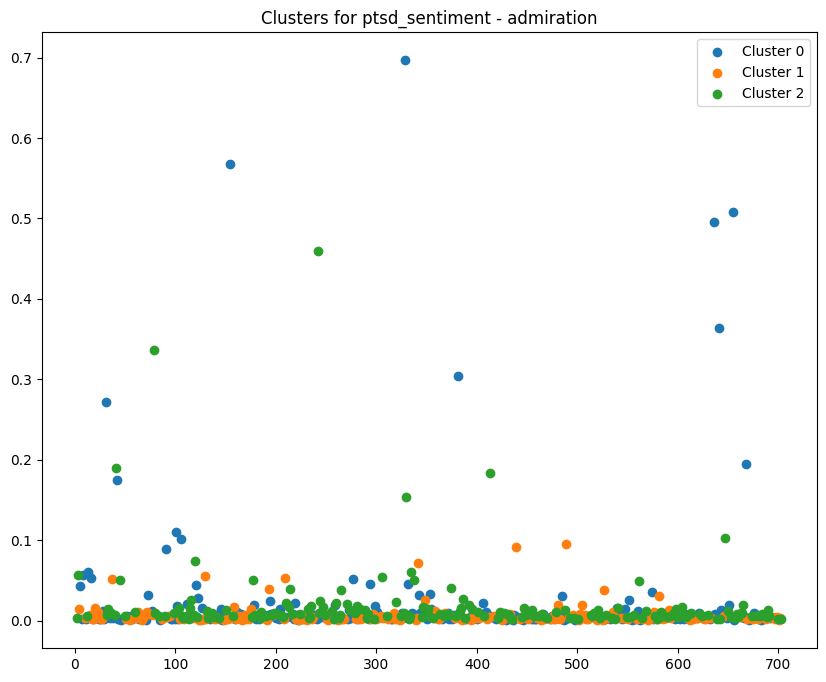

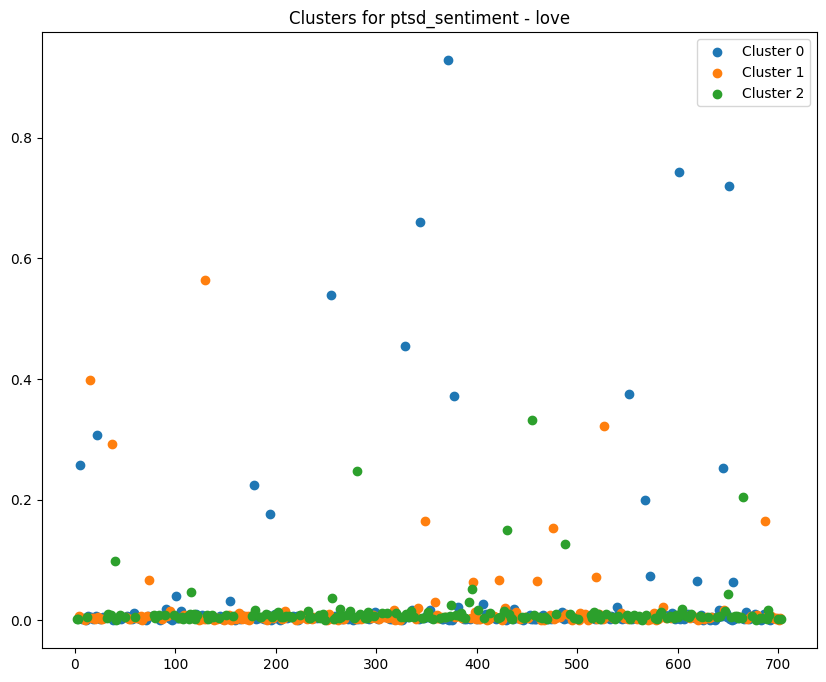

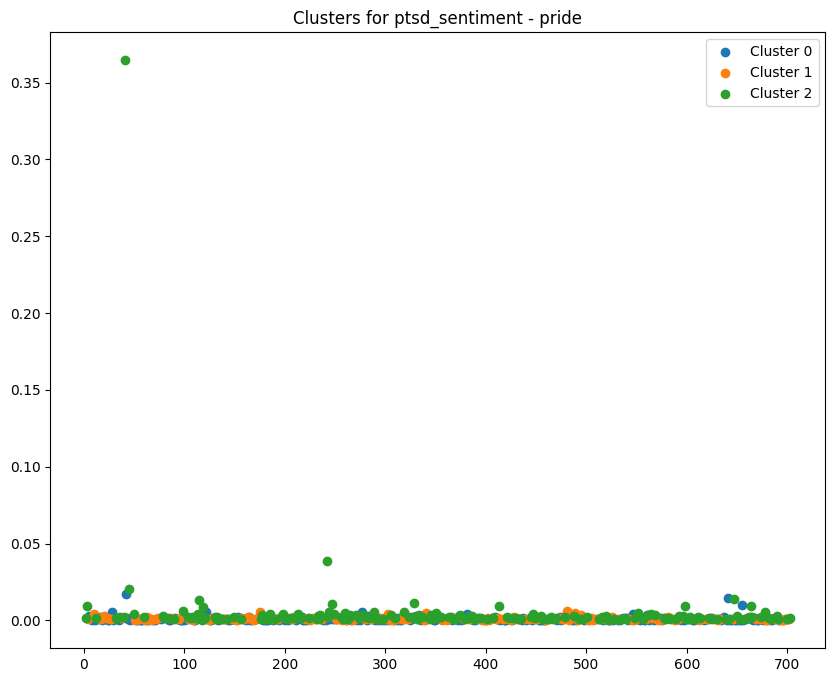

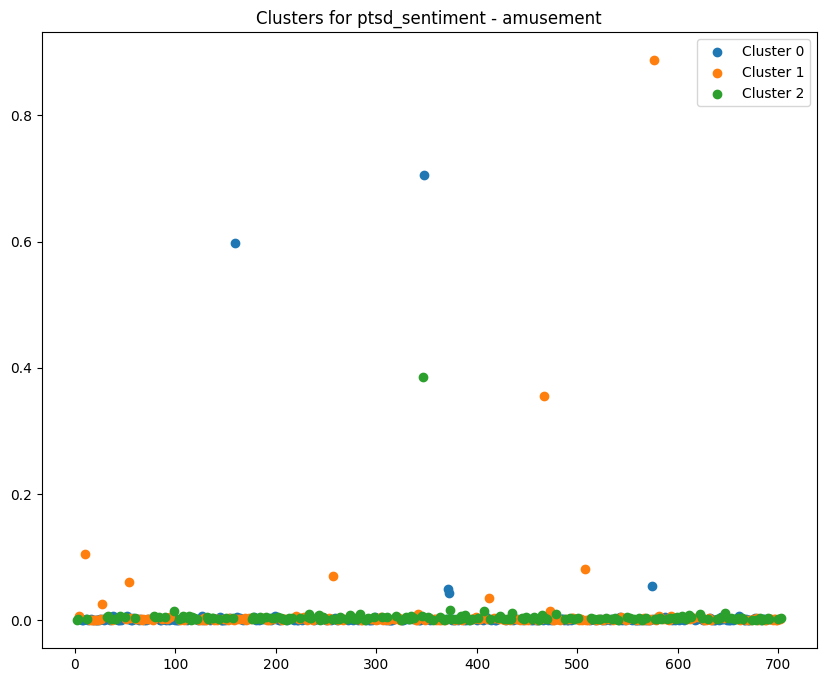

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


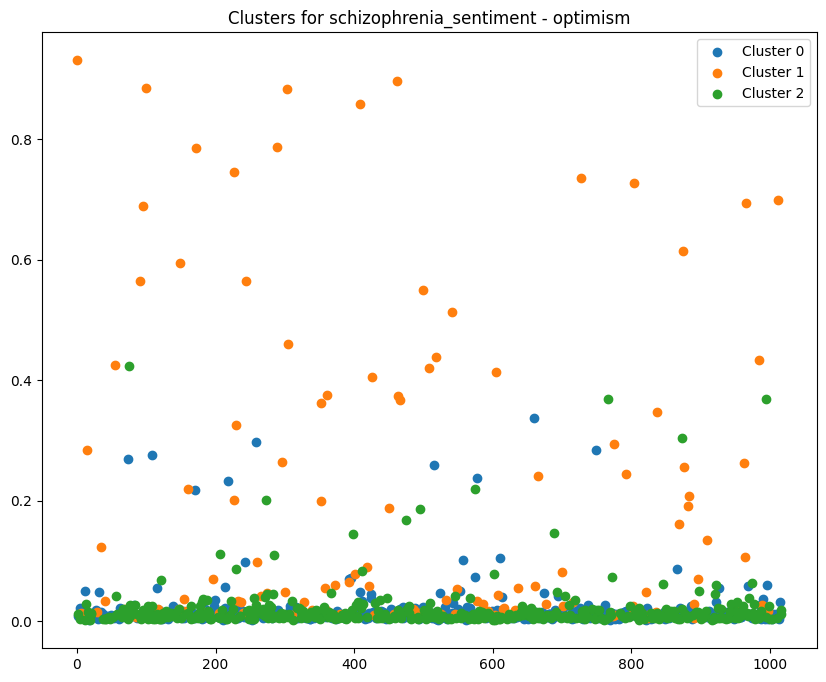

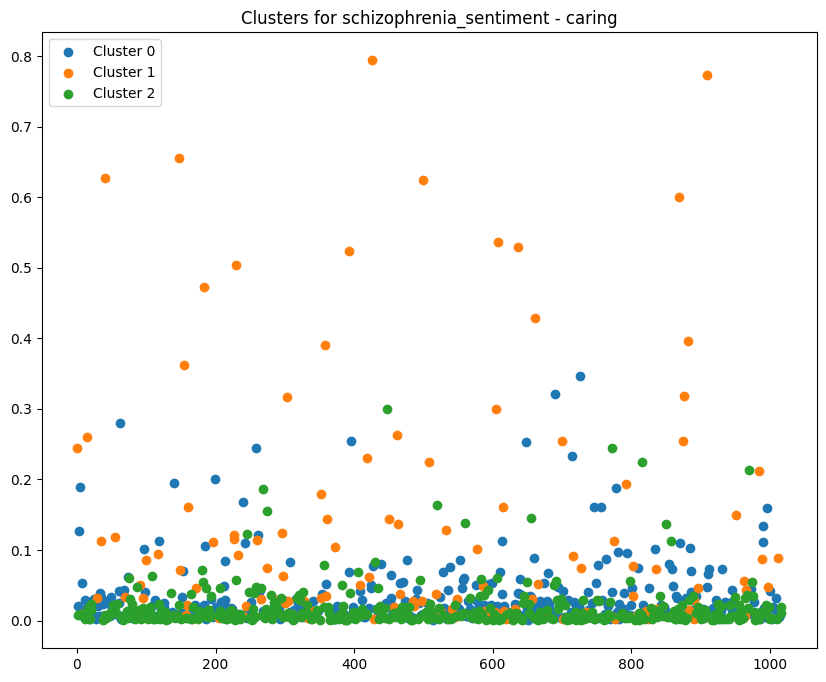

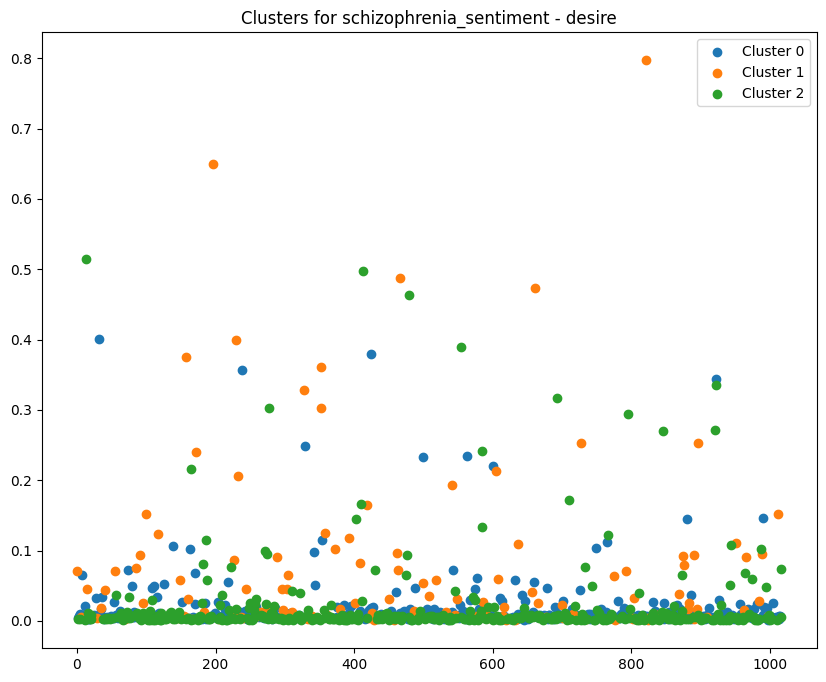

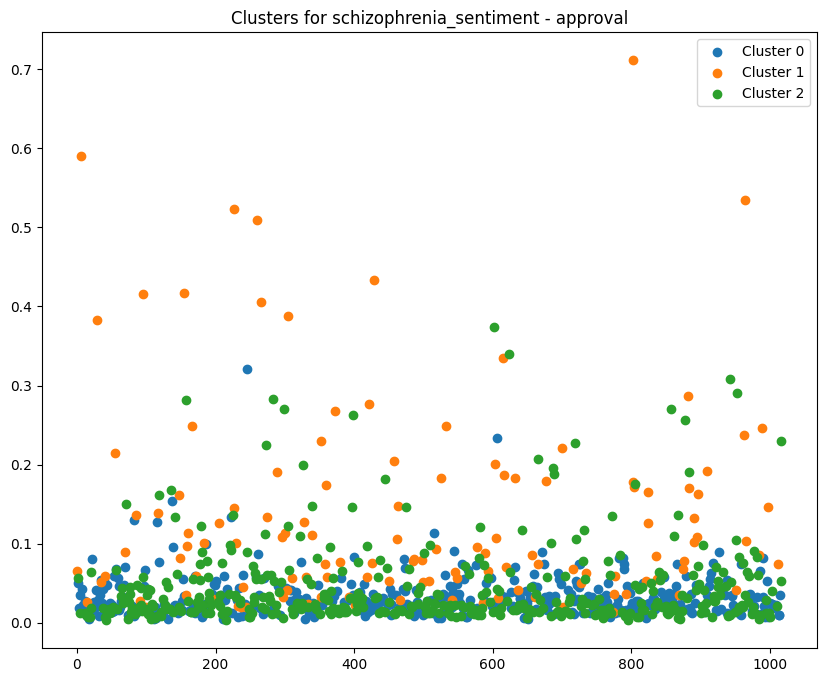

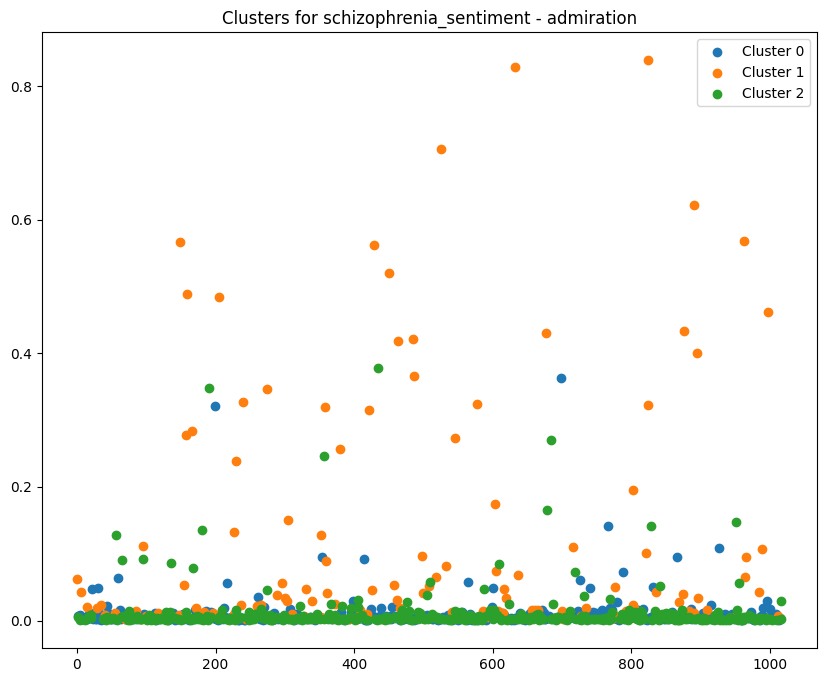

...

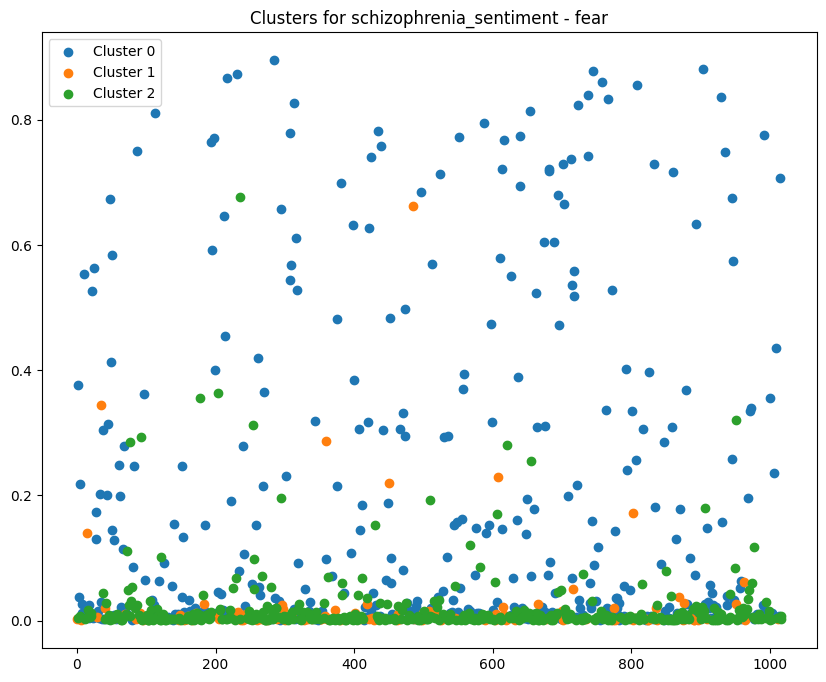

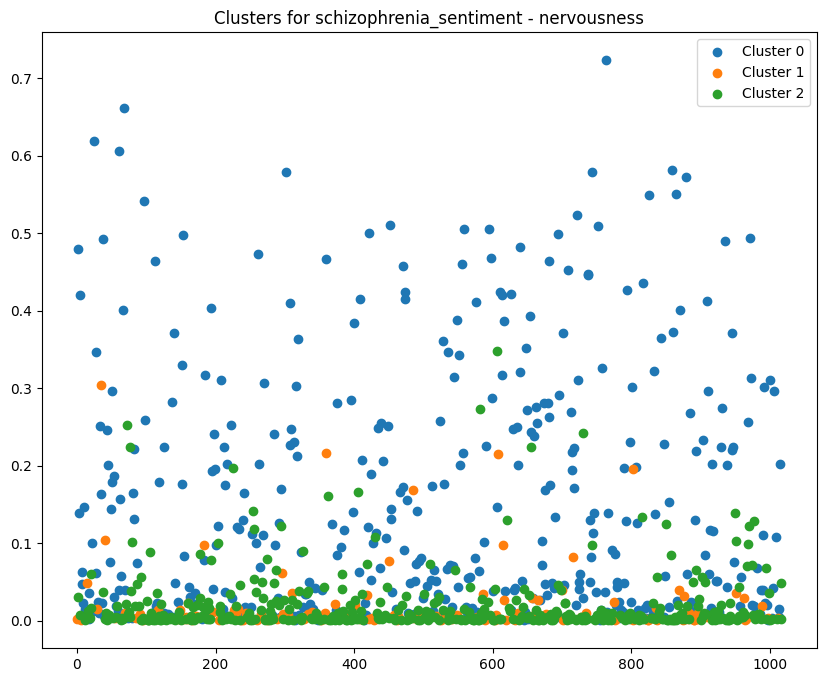

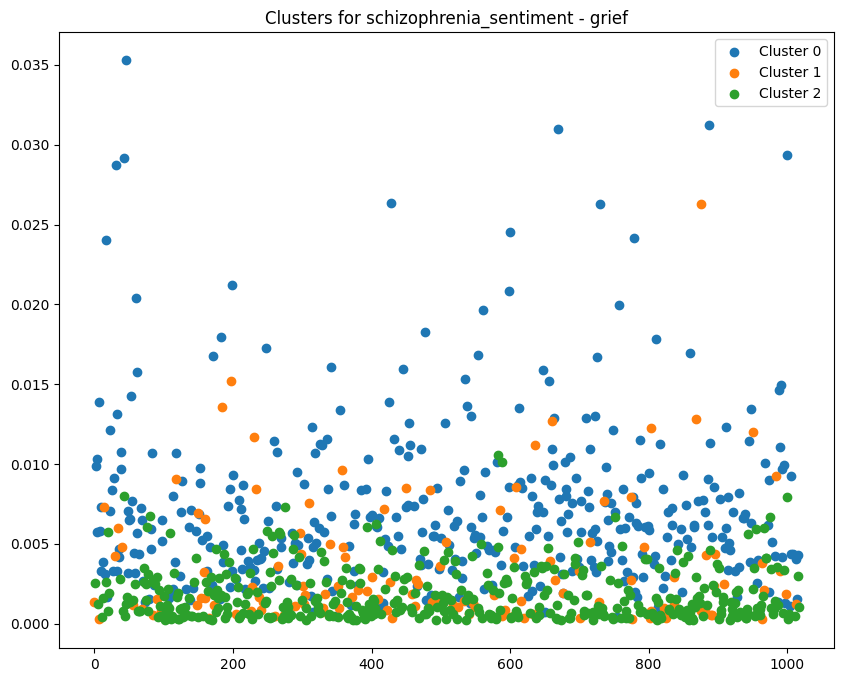

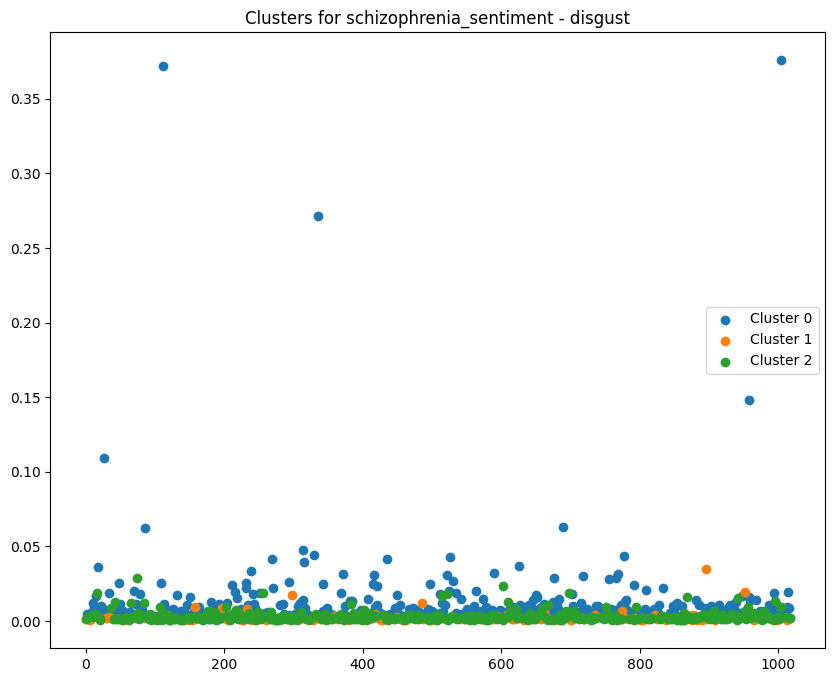

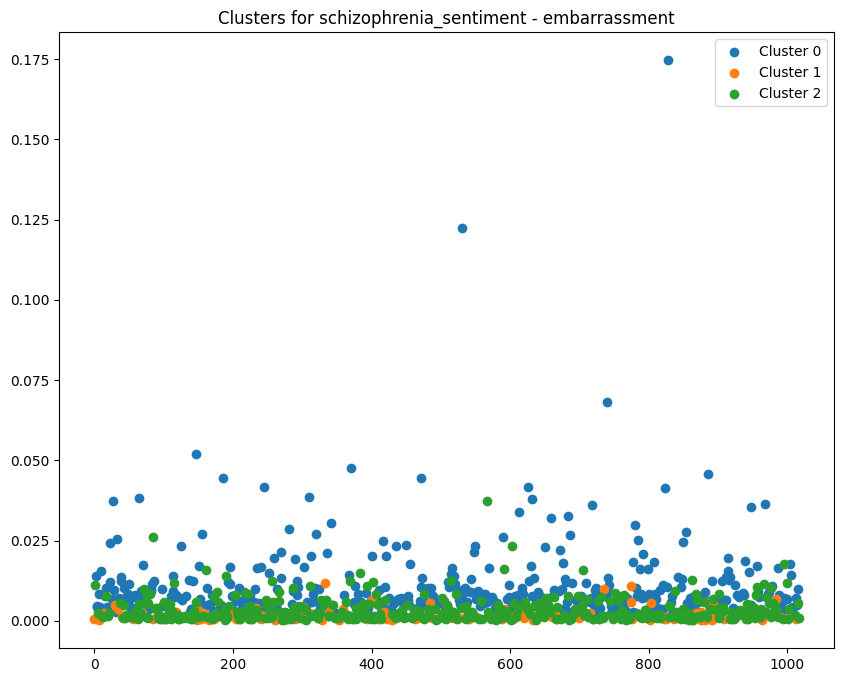

/Users/yuma/anaconda3/envs/myenv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


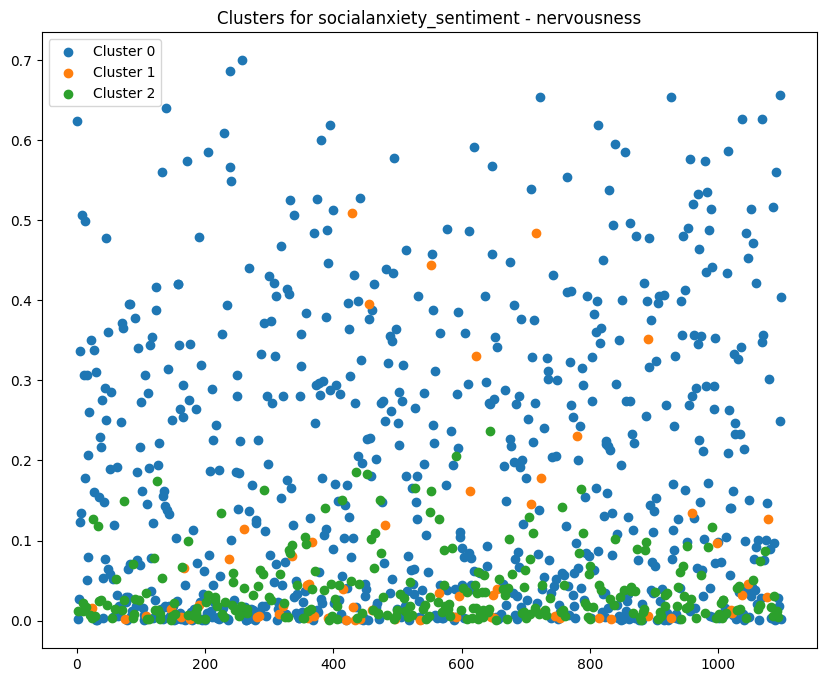

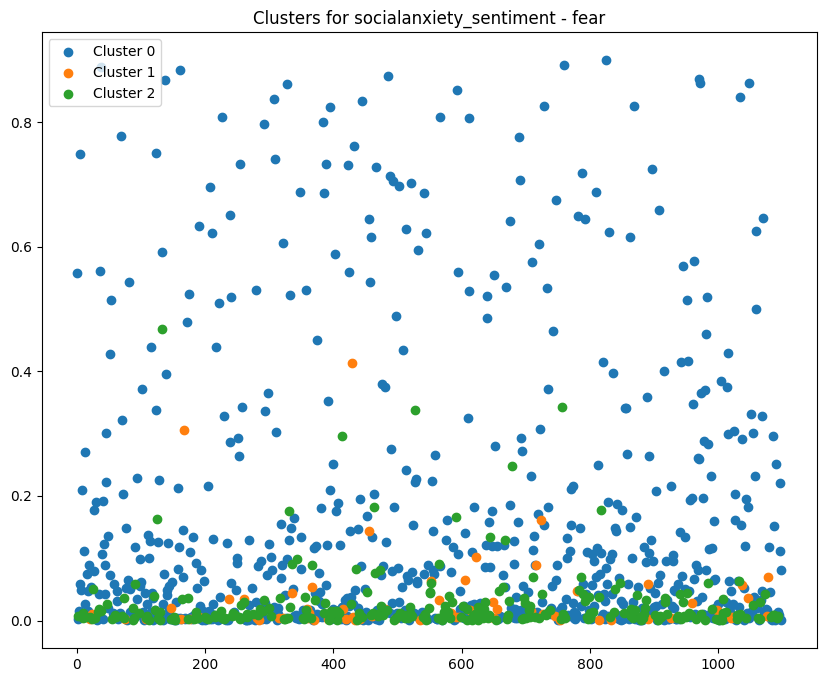

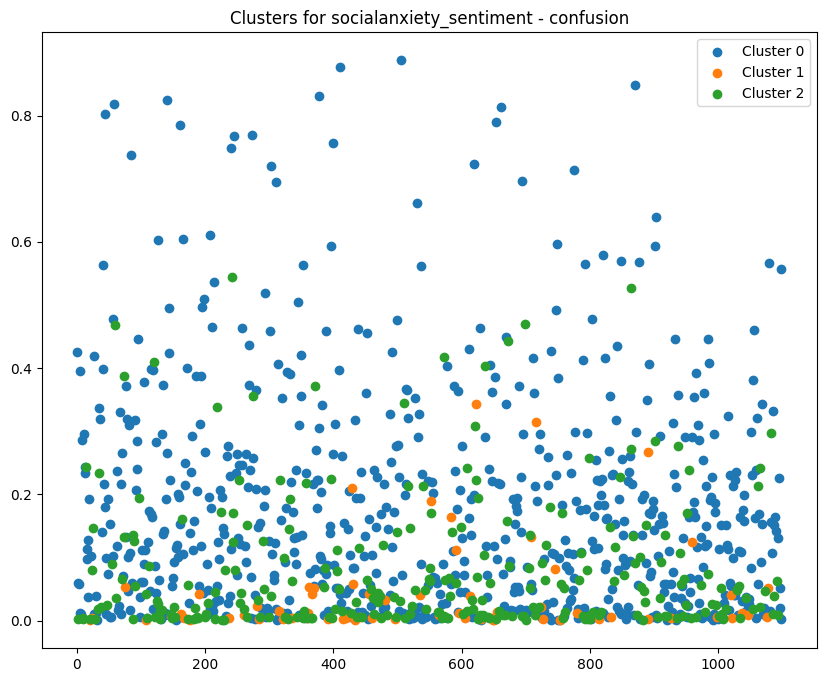

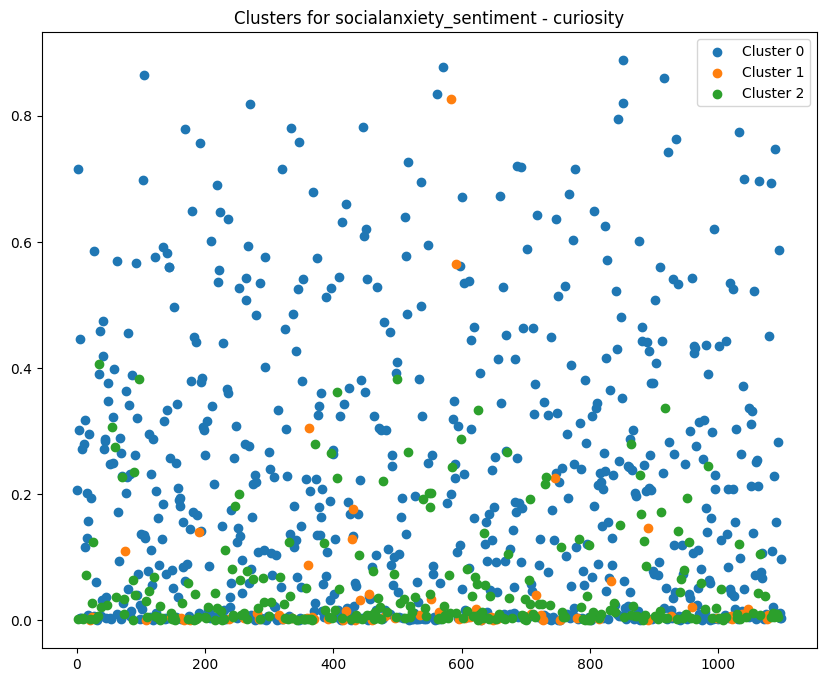

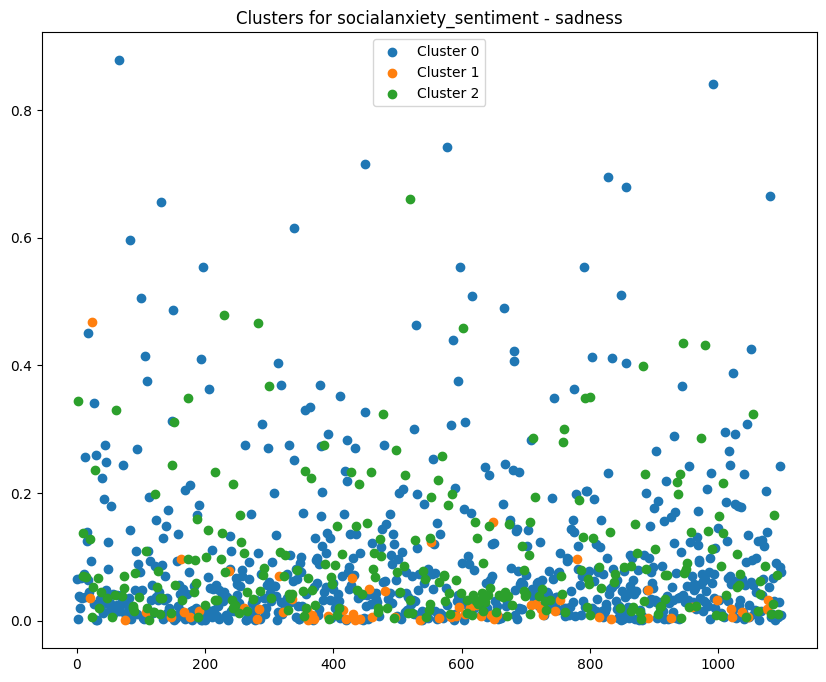

...

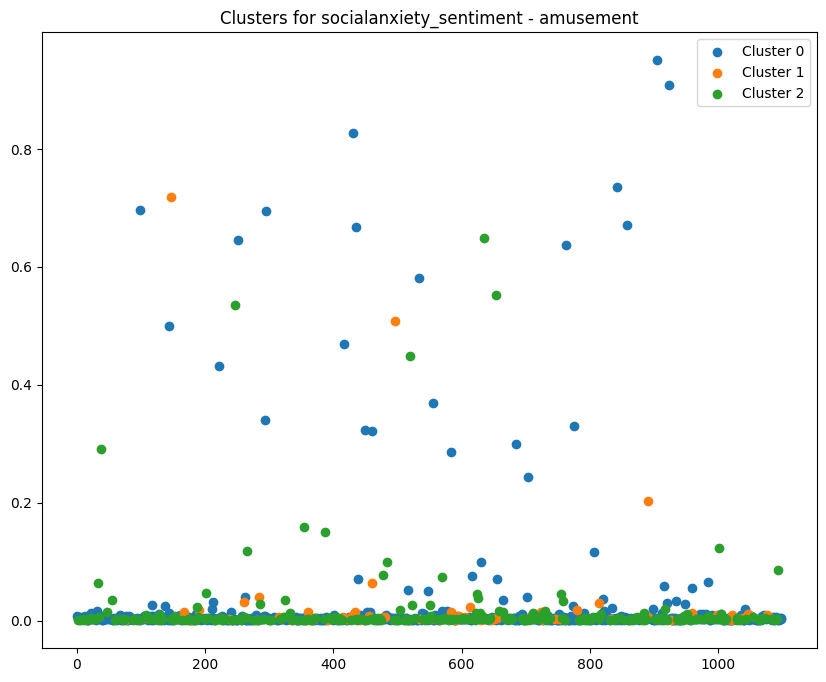

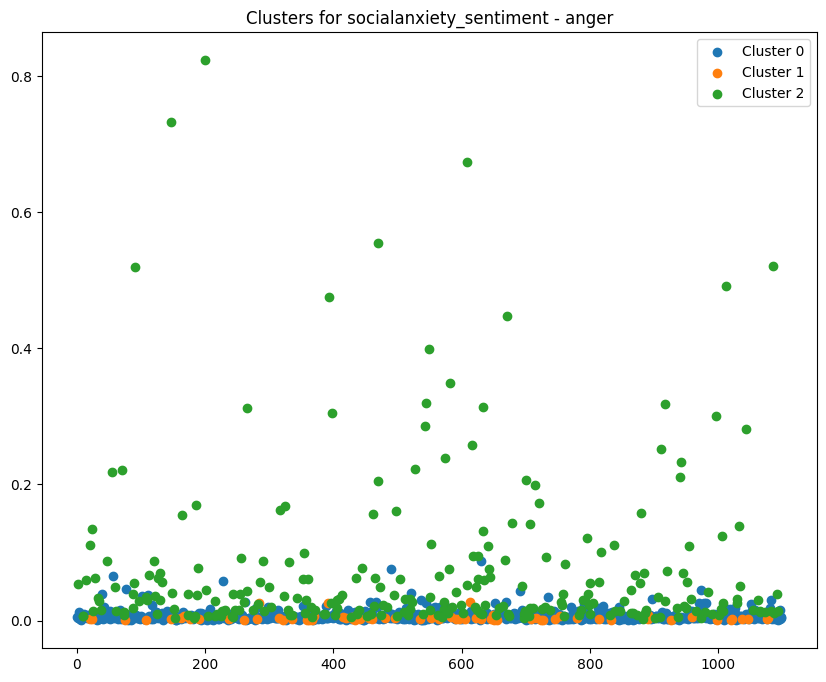

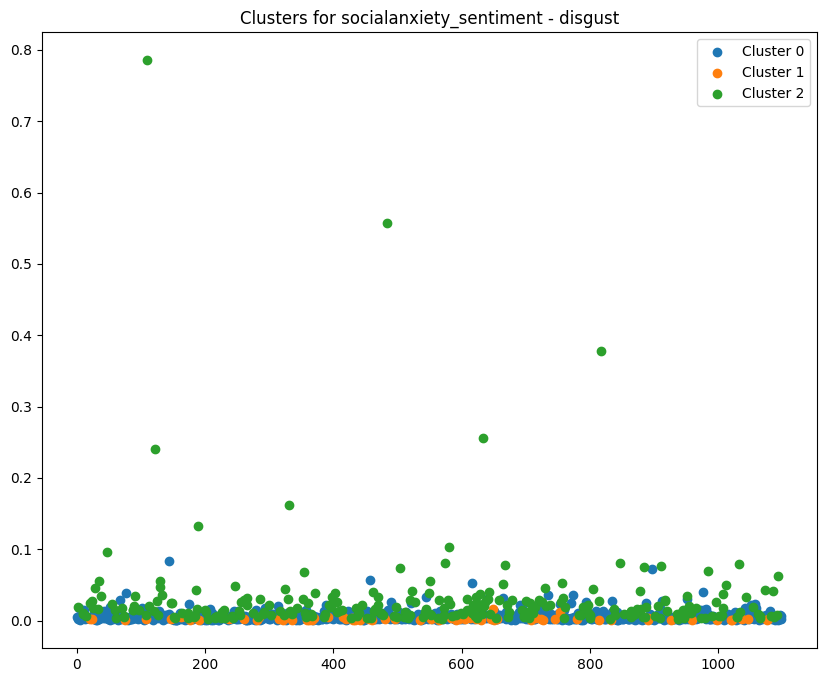

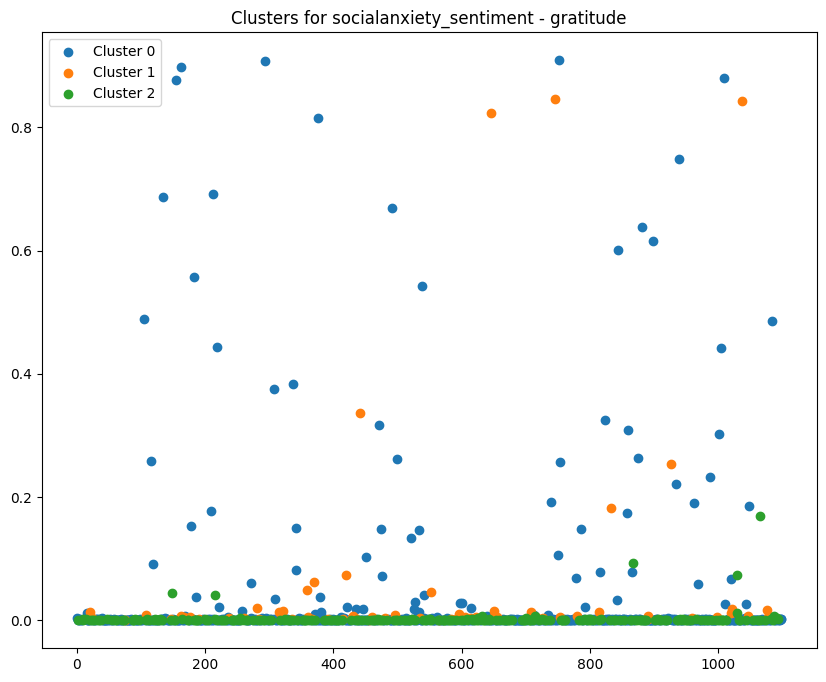

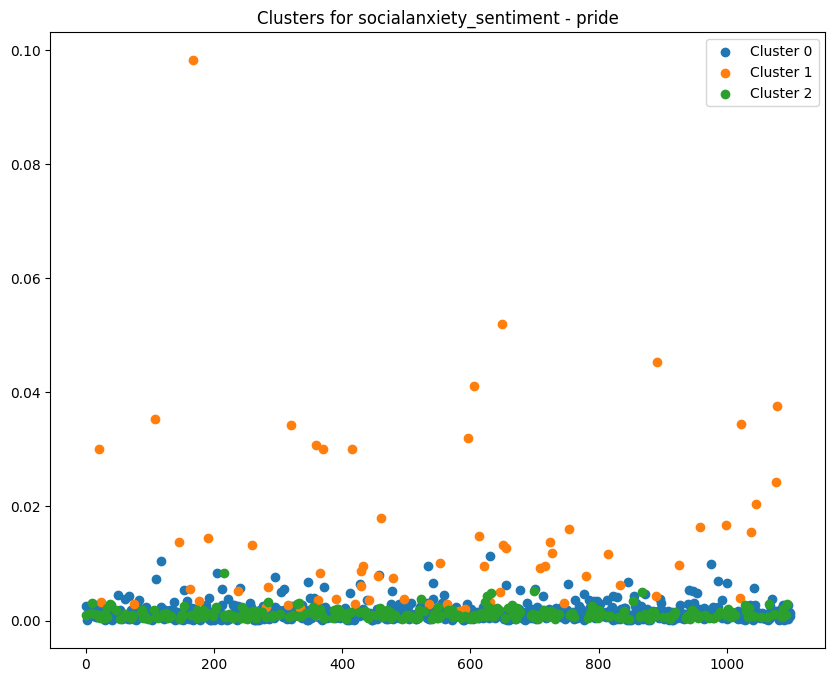

In [35]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming sentiment_dfs is a dictionary where the key is the disease name and the value is the corresponding DataFrame
for disease, df in sentiment_dfs.items():
    # Standardize the data
    scaler = StandardScaler()
    df_scaled = scaler.fit_transform(df)

    # Apply K-means clustering
    kmeans = KMeans(n_clusters=3, random_state=0)  # change n_clusters as needed
    kmeans.fit(df_scaled)

    # Get the cluster assignments and add them to the original DataFrame
    df['Cluster'] = kmeans.labels_

    # Plot the clusters
    for sentiment in df.columns:
        if sentiment != 'Cluster':
            plt.figure(figsize=(10, 8))
            for i in range(3):  # change range as needed
                cluster_df = df[df['Cluster'] == i]
                plt.scatter(cluster_df.index, cluster_df[sentiment], label=f'Cluster {i}')
            plt.title(f'Clusters for {disease} - {sentiment}')
            plt.legend()
            if not os.path.exists(f"sentiment_analysis/clusters/{disease}"):
                os.mkdir(f"sentiment_analysis/clusters/{disease}")
            plt.savefig(f"sentiment_analysis/clusters/{disease}/clusters_{disease}_{sentiment}.png", bbox_inches='tight')
            plt.show()
